In [1]:
from src.utils import * 
import pandas as pd
import numpy as np

base_dir = get_dir_name(True)
try:
    os.mkdir(base_dir + "/feature_set")
except FileExistsError:
    pass
sym = -1
# together_csv(base_dir + "/train_set", base_dir + f"/feature_set/no_feature_sym{sym}.csv", sym)
df = pd.read_csv(base_dir + f"/feature_set/no_feature_sym{sym}.csv")

In [2]:
df['time_period'] = df['time'].apply(lambda x: 'AM' if x < '11:20:00' else 'PM')
# 根据时段分别处理数据
am_df = df[df['time_period'] == 'AM']
pm_df = df[df['time_period'] == 'PM']

In [7]:
df['amount_delta']

0           938523.0
1           503741.0
2          3070536.0
3          1989469.0
4          1824050.0
             ...    
2038975      85563.0
2038976      91695.0
2038977     116148.0
2038978     421727.0
2038979      91689.0
Name: amount_delta, Length: 2038980, dtype: float64

In [ ]:
df['amount_delta'].describe()

count    2.038980e+06
mean     5.985653e+05
std      1.437190e+06
min      0.000000e+00
25%      8.148900e+04
50%      2.420945e+05
75%      6.130222e+05
max      3.309652e+08
Name: amount_delta, dtype: float64

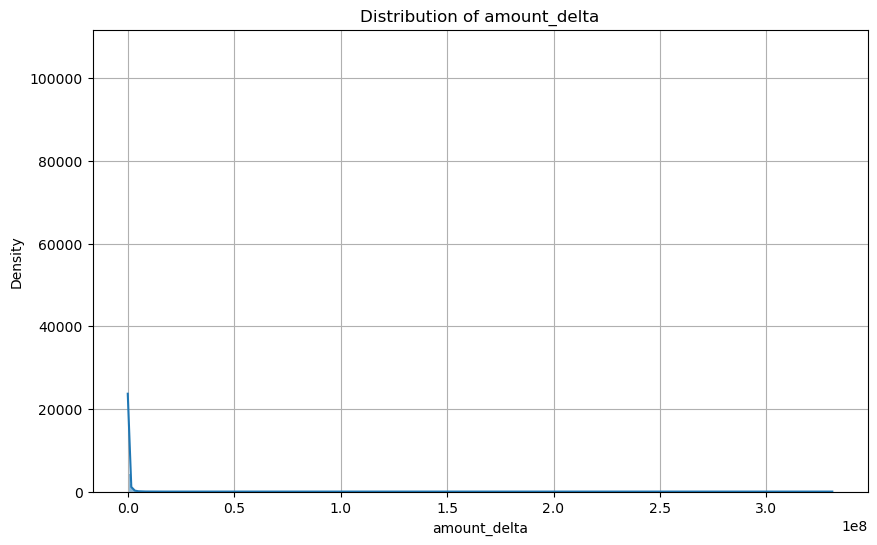

In [ ]:
# 探索性数据分析
# 画一个amount_delta的分布直方图
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
sns.histplot(df['amount_delta'], kde=True)
plt.title('Distribution of amount_delta')
plt.xlabel('amount_delta')
plt.ylabel('Density')
plt.grid()
plt.show()

In [6]:
df['amount']=np.log1p(df['amount_delta'])

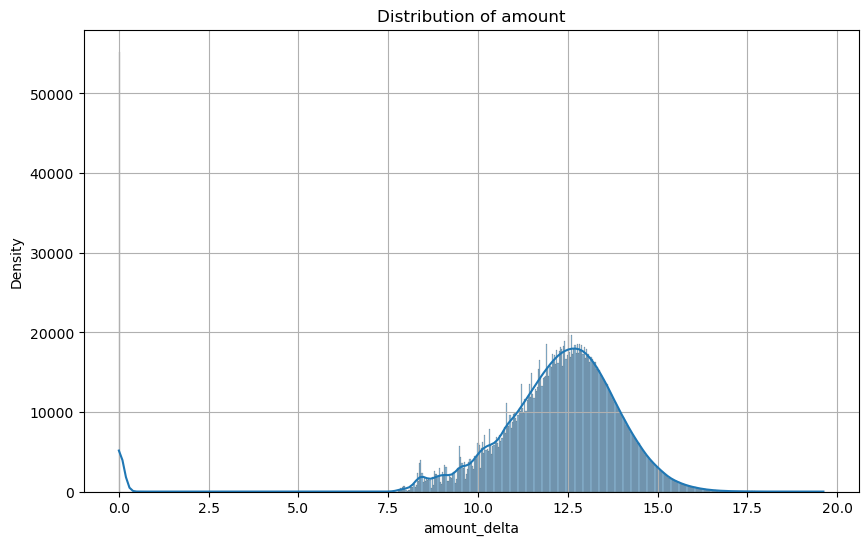

In [ ]:
# 取对数后再画一个
plt.figure(figsize=(10, 6))
sns.histplot(df['amount'], kde=True)
plt.title('Distribution of amount')
plt.xlabel('amount_delta')
plt.ylabel('Density')
plt.grid()
plt.show()

21


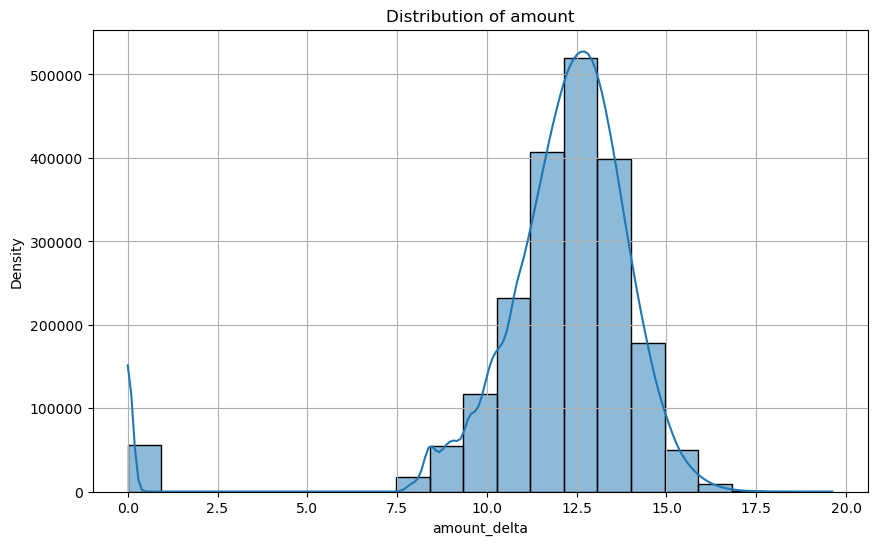

In [ ]:
# 有点像正态分布，精确一下bin再画一个
# 试试斯特格斯法则（Sturges' formula）
# bin 数 = log₂n +1，其中 n 为样本数量。
# 这一法则认为 bin 数应随着数据量的增加呈对数增长，在数据大致呈正态分布时效果较好。
n=df['amount'].count()
bin=int(np.log2(n))+1
print(bin)
plt.figure(figsize=(10, 6))
sns.histplot(df['amount'], bins=bin, kde=True)
plt.title('Distribution of amount')
plt.xlabel('amount_delta')
plt.ylabel('Density')
plt.grid()
plt.show()


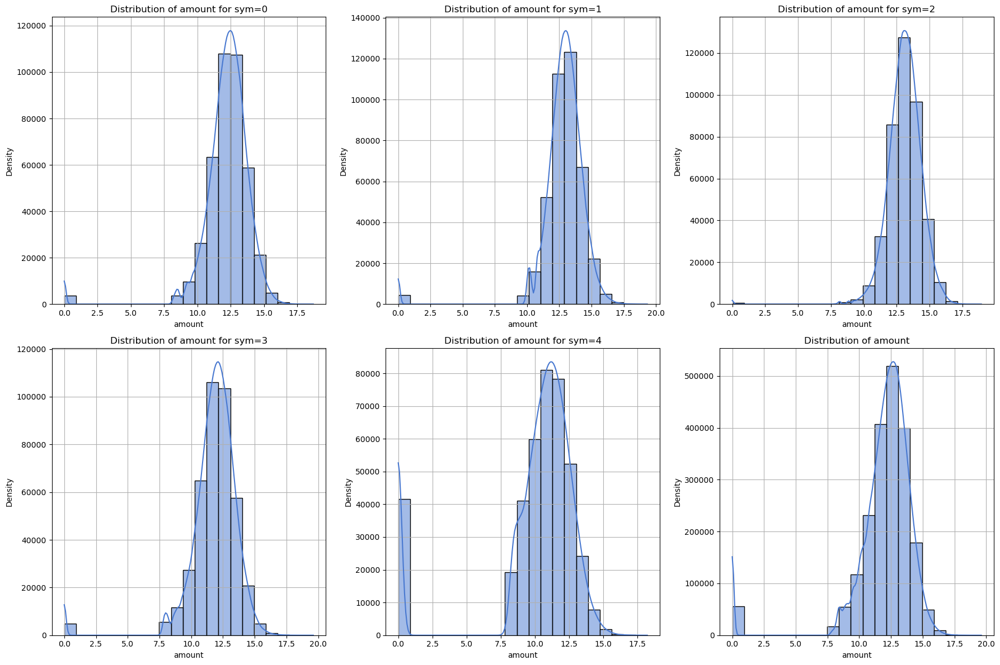

In [ ]:
# 分sym0-4分别画一下，看看是不是都挺像正态分布
fig, axes = plt.subplots(2, 3, figsize=(18, 12))  
axes = axes.flatten() 

for i, sym in enumerate(df['sym'].unique()):
    sym_df = df[df['sym'] == sym]
    sns.histplot(sym_df['amount'], bins=bin, kde=True, ax=axes[i])
    axes[i].set_title(f'Distribution of amount for sym={sym}')
    axes[i].set_xlabel('amount')
    axes[i].set_ylabel('Density')
    axes[i].grid()

# 最后一个图画全体的
sns.histplot(df['amount'], bins=bin, kde=True, ax=axes[5])
axes[5].set_title('Distribution of amount')
axes[5].set_xlabel('amount')
axes[5].set_ylabel('Density')
axes[5].grid()

plt.tight_layout()  # 调整子图间距
plt.show()

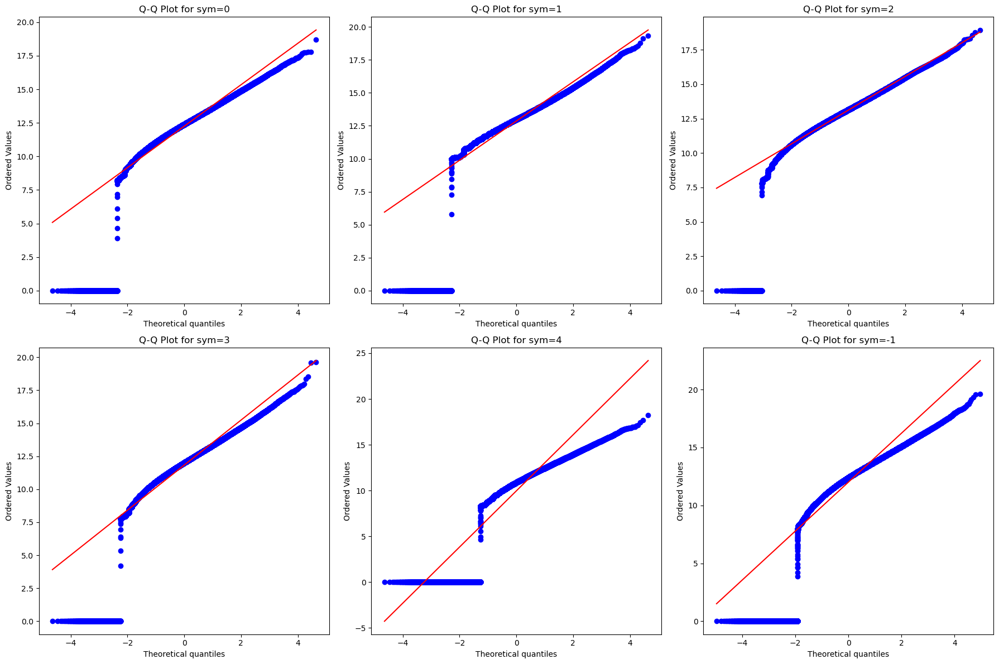

In [ ]:
# 画Q-Q图，看看是否近似正态分布
# 几十万几百万的大样本不适合做假设检验
# 微小扰动对结果非常明显
from scipy.stats import probplot
fig, axes = plt.subplots(2, 3, figsize=(18, 12))  # 2 行 3 列的子图布局
axes = axes.flatten() 
for i, sym in enumerate(df['sym'].unique()):
    subset = df[df['sym'] == sym]  
    probplot(subset['amount'], dist="norm", plot=axes[i]) 
    axes[i].set_title(f'Q-Q Plot for sym={sym}') 
# 最后一个还是全体的
probplot(df['amount'], dist="norm", plot=axes[5]) 
axes[5].set_title(f'Q-Q Plot for sym={-1}')  

plt.tight_layout()  # 调整子图间距
plt.show()


In [ ]:
# 可以发现除了0值点都挺符合正态分布的
df['is_amount_0'] = (df['amount'] == 0).astype(int)

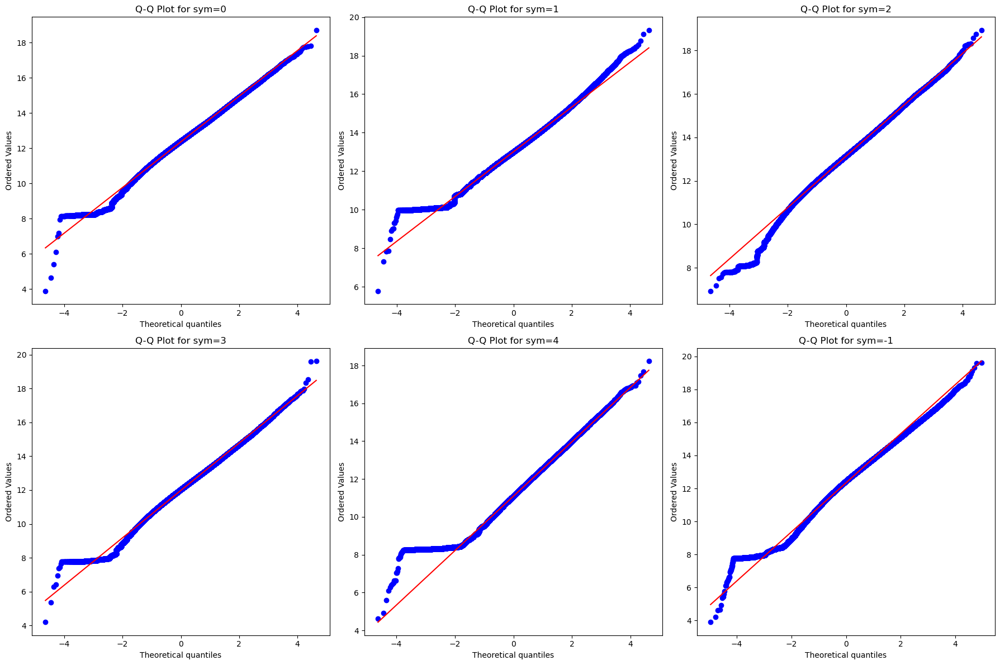

In [ ]:
# 去掉0值点再画一下
from scipy.stats import probplot
fig, axes = plt.subplots(2, 3, figsize=(18, 12))  # 2 行 3 列的子图布局
axes = axes.flatten() 
for i, sym in enumerate(df['sym'].unique()):
    subset = df[(df['sym'] == sym)&(df['is_amount_0'] == 0)]  
    probplot(subset['amount'], dist="norm", plot=axes[i]) 
    axes[i].set_title(f'Q-Q Plot for sym={sym}') 
# 最后一个还是全体的
probplot(df[df['is_amount_0'] == 0]['amount'], dist="norm", plot=axes[5]) 
axes[5].set_title(f'Q-Q Plot for sym={-1}')  

plt.tight_layout()  # 调整子图间距
plt.show()

In [ ]:
# 确实如此，说明非0值点的数据基本符合正态分布
# 接下来单独处理0值点

# 猜想1：价差spread太大导致买方卖方不想交易，交易量减少（甚至为0）直至价差减小
# 若猜想成立，则在以spread为x轴，amount_0的数量（count）为y轴的散点图中，散点应在右上方密集
# 接下来开始对五档价差分别画图

In [ ]:
# 经过各种尝试，我们发现由于样本过大，无论是散点图，直方图还是各种检验方法效果都不是很好
# 这里我们采用条件概率图的方式来验证
# 条件概率图适用于可视化一个连续特征（如 spread1） 和 一个二分类变量（如 is_amount_0） 之间的条件概率关系


In [314]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def conditional_proba_plot(df, feature, target, bins=50):
    """"绘制条件概率图 + 每个分箱的样本数柱状图+条件概率*分箱样本数(加权)图
    
    参数：
    df -- 数据集，包含特征列和目标列
    feature -- 需要分析的特征列名（字符串）
    target -- 目标列名（二分类变量）
    bins -- 分箱数量，默认为50个箱（可根据数据调整）
    """
    df_copy = df.copy()
    # 对特征列进行等频分箱
    
    # 给特征列添加轻微的噪声
    eps = np.random.rand(len(df_copy)) * 1e-8  # 小幅度噪声
    df_copy['feature_with_noise'] = df_copy[feature] + eps

    # 使用噪声数据来分箱
    # 如果不加噪声的话,duplicates='drop'无法做到等频分箱,因为相同数据点会被加到一起
    # 加上噪声后就可以改为duplicates='raise'了
    df['bin'] = pd.qcut(df_copy['feature_with_noise'], q=bins, duplicates='raise')
    # # 对特征列进行等宽分箱
    # df['bin'] = pd.cut(df_copy[feature], bins=bins, duplicates='drop')
    # 等宽分箱导致几乎全集中在最左边效果很差,还是采用等频分箱
    
    # 每个 bin 的正样本概率
    prob_table = df.groupby('bin', observed=True)[target].mean()
    # 每个 bin 的样本数
    count_table = df.groupby('bin', observed=True)[target].count()
    # 每个 bin 的概率 × 样本数（加权指标）
    positive_count = df.groupby('bin', observed=True)[target].sum()

    # 汇总为 DataFrame
    summary = pd.DataFrame({
        f'proba_of_{target}': prob_table,
        'count': count_table,
        f'positive_count': positive_count
    })


    # 创建图形
    fig, axes = plt.subplots(2,1, figsize=(14, 6))
    ax2 = axes[0].twinx()
    x_vals = summary.index.astype(str)

    # 条件概率图（蓝色折线）
    sns.lineplot(x=x_vals, y=summary[f'proba_of_{target}'], color='blue', marker='o', label='proba', ax=axes[0])
    # 柱状图：样本数（灰）
    sns.barplot(x=x_vals, y=summary['count'], color='gray', alpha=0.3, ax=ax2, label='count')

    # 总体is_amount_0概率
    p = df[target].mean()

    # 添加水平虚线（is_amount_0的比例）
    axes[0].axhline(p, color='red', linestyle='--', label=f'P({target}) = {p:.4f}')

    axes[0].set_ylabel(f'proba_of_{target}', color='blue')
    ax2.set_ylabel('count', color='gray')
    axes[0].set_xlabel(f'{feature}_bins', fontsize=12)
    axes[0].tick_params(axis='x', rotation=90)
    axes[0].legend(loc='upper left')
    
    # 副图:proba*count
    sns.lineplot(x=x_vals, y=summary['positive_count'], color='purple', marker='o', ax=axes[1])
    sns.barplot(x=x_vals, y=summary['positive_count'], color='yellow', alpha=0.3, ax=axes[1])
    axes[1].set_ylabel('positive_count (count * proba)', color='purple')
    axes[1].set_xlabel('')
    axes[1].set_xticks([])
    # 总标题和布局
    fig.suptitle(f'{feature} vs {target} (Proba, Count, Count × Proba)', fontsize=16)

    # 自动调整布局
    plt.tight_layout()
    plt.subplots_adjust(top=0.88)  # 为标题留空间
    plt.show()


In [57]:
from src.utils import * 
import pandas as pd
import numpy as np

base_dir = get_dir_name(True)
try:
    os.mkdir(base_dir + "/feature_set")
except FileExistsError:
    pass
sym = -1
# together_csv(base_dir + "/train_set", base_dir + f"/feature_set/no_feature_sym{sym}.csv", sym)
df = pd.read_csv(base_dir + f"/feature_set/no_feature_sym{sym}.csv")

In [58]:
df['time_period'] = df['time'].apply(lambda x: 'AM' if x < '11:20:00' else 'PM')
# 根据时段分别处理数据
am_df = df[df['time_period'] == 'AM']
pm_df = df[df['time_period'] == 'PM']

In [59]:
bid_cols = ['n_bid1', 'n_bid2', 'n_bid3', 'n_bid4', 'n_bid5']
ask_cols = ['n_ask1', 'n_ask2', 'n_ask3', 'n_ask4', 'n_ask5']
bid_values = df[bid_cols].values
ask_values = df[ask_cols].values
spread = ask_values - bid_values
for i in range(5):
    df[f'spread{i + 1}'] = spread[:, i]
spread_cols = [f'spread{i + 1}' for i in range(5)]

In [60]:
bsize_cols = ['n_bsize1', 'n_bsize2', 'n_bsize3', 'n_bsize4', 'n_bsize5']
asize_cols = ['n_asize1', 'n_asize2', 'n_asize3', 'n_asize4', 'n_asize5']
bsize_values = df[bsize_cols].values
asize_values = df[asize_cols].values

In [61]:
df['amount']=np.log1p(df['amount_delta'])
df['is_amount_0'] = (df['amount'] == 0).astype(int)
df['abnormal'] = (df[spread_cols] < 0).any(axis=1).astype(int)

In [207]:
abnormal_df=df[df['abnormal']==1]
abnormal_df[['sym','date']].drop_duplicates()

,sym,date
119620,0,34
1307657,3,27
1725344,4,29
1763757,4,38
1837764,4,54
1998898,4,90
2029184,4,98


In [91]:
pd.set_option('display.max_columns', None)

In [92]:
normal_df=df[df['abnormal']==0]

In [93]:
normal_df['spread1'].describe()

count    2.029588e+06
mean     3.517504e-04
std      2.936130e-04
min      3.076923e-05
25%      2.008032e-04
50%      2.851440e-04
75%      3.960396e-04
max      1.341157e-02
Name: spread1, dtype: float64

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\2938525997.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['bin'] = pd.qcut(df_copy['feature_with_noise'], q=bins, duplicates='raise')


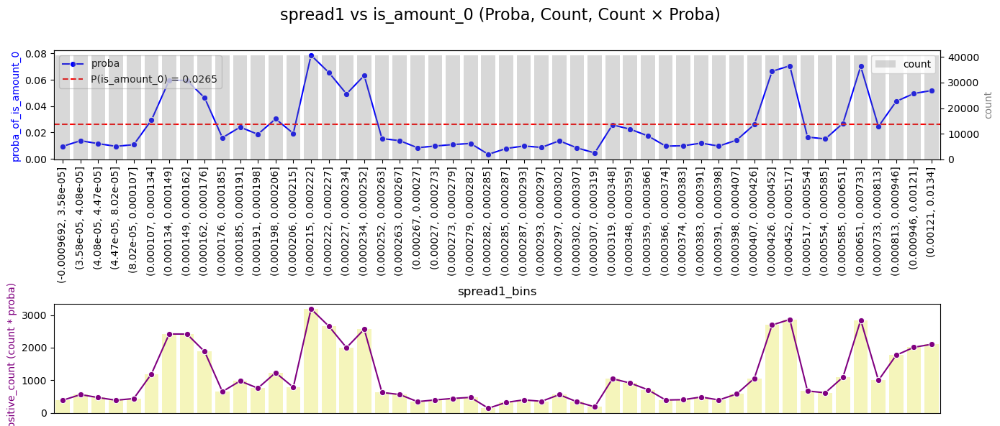

In [315]:
conditional_proba_plot(normal_df, feature='spread1', target='is_amount_0', bins=50)

In [ ]:
# 再单独看看每一只的影响

In [316]:
def proba_plot_by_sym(df, feature, target, bins=50):
    df = df.copy()
    fig, axes = plt.subplots(5, 2, figsize=(18, 20), sharex=False, sharey=False)
    
    # 也可以用df['sym'].unique()
    for i in range(5):
        df_sym = df[df['sym'] == i].copy()
        
        # 给特征列添加轻微的噪声
        eps = np.random.rand(len(df_sym)) * 1e-8  # 小幅度噪声
        df_sym['feature_with_noise'] = df_sym[feature] + eps
        df_sym['bin'] = pd.qcut(df_sym['feature_with_noise'], q=bins, duplicates='raise')

        prob = df_sym.groupby('bin', observed=True)[target].mean()
        count = df_sym.groupby('bin', observed=True)[target].count()
        positive = df_sym.groupby('bin', observed=True)[target].sum()

        summary = pd.DataFrame({
            'proba': prob,
            'count': count,
            'positive_count': positive
        })
        x_vals = summary.index.astype(str)
        
        ax1 = axes[i, 0]
        ax2 = ax1.twinx()

        sns.lineplot(x=x_vals, y=summary['proba'], color='blue', marker='o', label='proba', ax=ax1)
        sns.barplot(x=x_vals, y=summary['count'], color='gray', alpha=0.3, ax=ax2)
        
        # 总体is_amount_0概率
        p = df[target].mean()
        
        # 获取每个分箱的边界
        bin_edges = [interval.left for interval in df['bin'].cat.categories]


        # 添加水平虚线（is_amount_0的比例）
        ax1.axhline(p, color='red', linestyle='--', label=f'P({target}) = {p:.4f}')
        
        ax1.set_ylabel('proba', color='blue')
        ax2.set_ylabel('count', color='gray')
        ax1.set_title(f'sym = {i} - {feature} vs proba & count')
        ax1.tick_params(axis='x', rotation=90)

        ax3 = axes[i, 1]
        sns.lineplot(x=x_vals, y=summary['positive_count'], color='purple', marker='o', ax=ax3)
        sns.barplot(x=x_vals, y=summary['positive_count'], color='yellow', alpha=0.3, ax=ax3)

        ax3.set_ylabel('positive_count', color='purple')
        ax3.set_title(f'sym = {i} - positive_count')
        ax3.set_xticks([])  # 不显示副图的x轴刻度

    plt.tight_layout()
    plt.show()


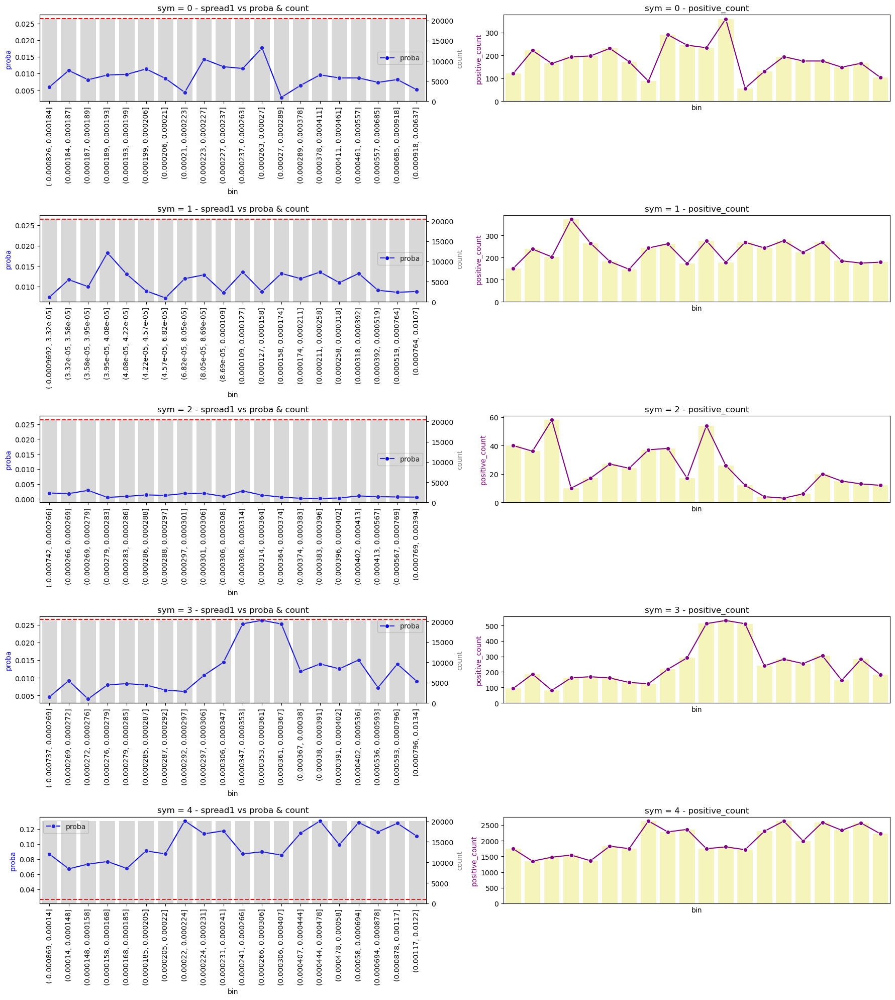

In [317]:
proba_plot_by_sym(normal_df, feature='spread1', target='is_amount_0', bins=20)

In [ ]:
# 条件概率图说明sym=4的0值成交量显著多余其他4只股票,且随价差增大有上升趋势
# 但是其他几只股票不明显,可能有一定的关系
# 因此对于sym=4猜想1成立,sym0-3不一定,可能需要实际用一下lightGBM的feature_importance来验证

In [ ]:
# 那为什么不用等距分箱呢?
# 换成等距分箱试一试

In [ ]:
def cut_proba_plot_by_sym(df, feature, target, bins=50):
    df = df.copy()
    fig, axes = plt.subplots(5, 2, figsize=(18, 20), sharex=False, sharey=False)
    
    # 也可以用df['sym'].unique()
    for i in range(5):
        df_sym = df[df['sym'] == i].copy()
        
        # 给特征列添加轻微的噪声
        eps = np.random.rand(len(df_sym)) * 1e-8  # 小幅度噪声
        df_sym['feature_with_noise'] = df_sym[feature] + eps
        df_sym['bin'] = pd.cut(df_sym['feature_with_noise'], bins=bins, duplicates='raise')

        prob = df_sym.groupby('bin', observed=True)[target].mean()
        count = df_sym.groupby('bin', observed=True)[target].count()
        positive = df_sym.groupby('bin', observed=True)[target].sum()

        summary = pd.DataFrame({
            'proba': prob,
            'count': count,
            'positive_count': positive
        })
        x_vals = summary.index.astype(str)
        
        ax1 = axes[i, 0]
        ax2 = ax1.twinx()

        sns.lineplot(x=x_vals, y=summary['proba'], color='blue', marker='o', label='proba', ax=ax1)
        sns.barplot(x=x_vals, y=summary['count'], color='gray', alpha=0.3, ax=ax2)
        
        # 总体is_amount_0概率
        is_amount_0_proba = df['is_amount_0'].mean()
        
        # 获取每个分箱的边界
        bin_edges = [interval.left for interval in df['bin'].cat.categories]


        # 添加水平虚线（is_amount_0的比例）
        ax1.axhline(is_amount_0_proba, color='red', linestyle='--', label=f'P(is_amount_0) = {is_amount_0_proba:.4f}')
        
        ax1.set_ylabel('proba', color='blue')
        ax2.set_ylabel('count', color='gray')
        ax1.set_title(f'sym = {i} - {feature} vs proba & count')
        ax1.tick_params(axis='x', rotation=90)

        ax3 = axes[i, 1]
        sns.lineplot(x=x_vals, y=summary['positive_count'], color='purple', marker='o', ax=ax3)
        sns.barplot(x=x_vals, y=summary['positive_count'], color='yellow', alpha=0.3, ax=ax3)

        ax3.set_ylabel('positive_count', color='purple')
        ax3.set_title(f'sym = {i} - positive_count')
        ax3.set_xticks([])  # 不显示副图的x轴刻度

    plt.tight_layout()
    plt.show()


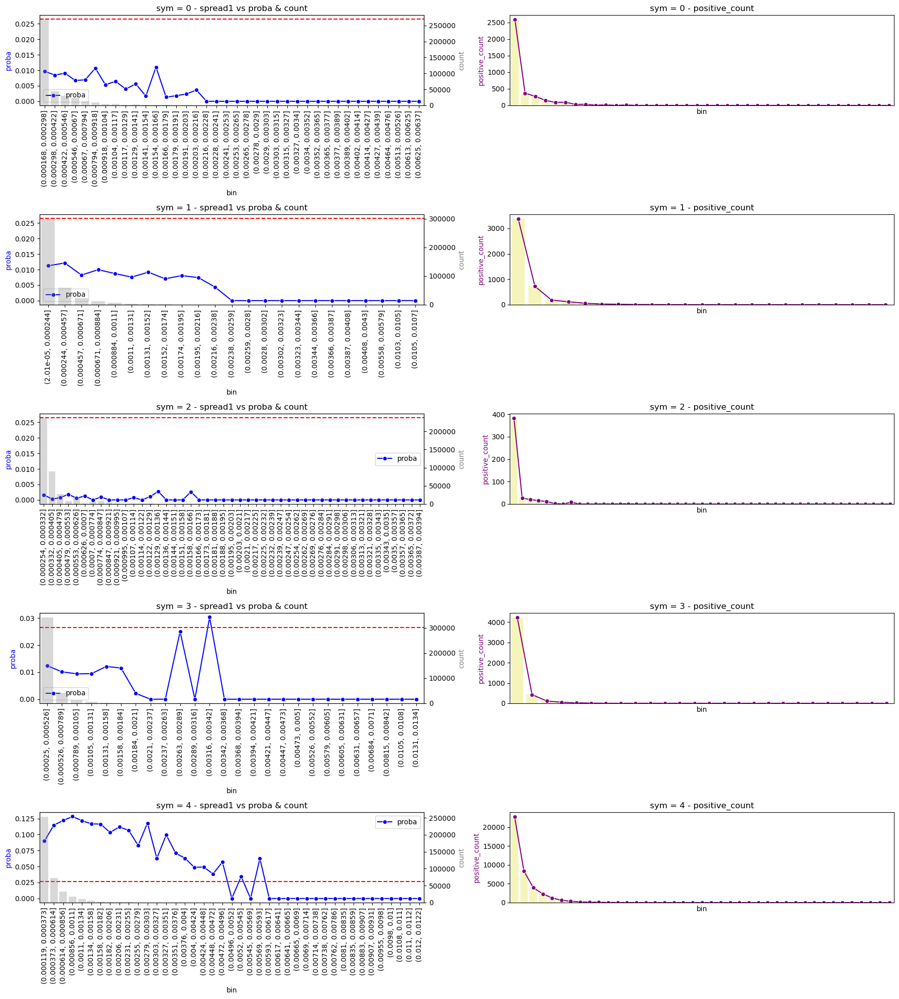

In [287]:
cut_proba_plot_by_sym(normal_df, feature='spread1', target='is_amount_0', bins=50)

In [ ]:
# 显然在样本数据极端右偏的情况下
# 等距分箱作用不大,因为每个箱样本数变化幅度很大,会影响我们分析条件概率
# 因此我们一律采用等频分箱,控制每个箱内样本数据相等,从而更好的分析是否存在这一种倾向(从条件概率的角度)

In [118]:
# 猜想2：盘口挂单稀疏，买卖双方挂单量少，市场深度不足，可能导致无成交

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\2938525997.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['bin'] = pd.qcut(df_copy['feature_with_noise'], q=bins, duplicates='raise')


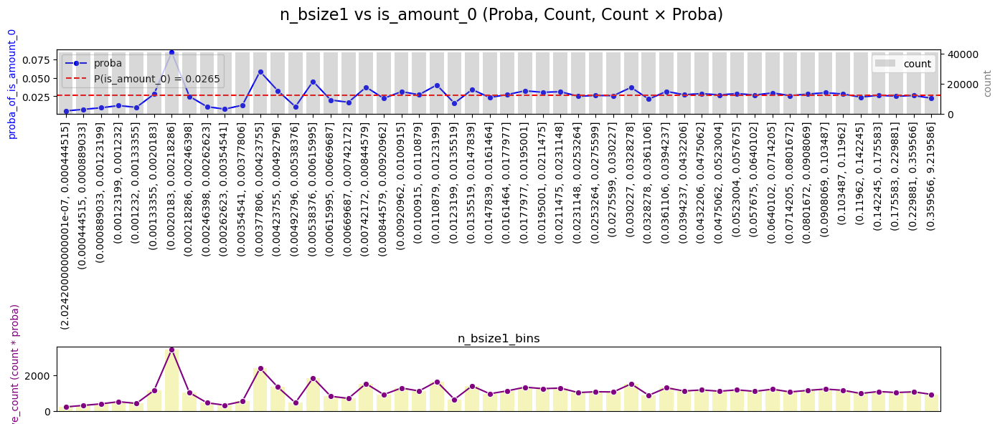

In [318]:
conditional_proba_plot(normal_df, feature='n_bsize1', target='is_amount_0', bins=50)

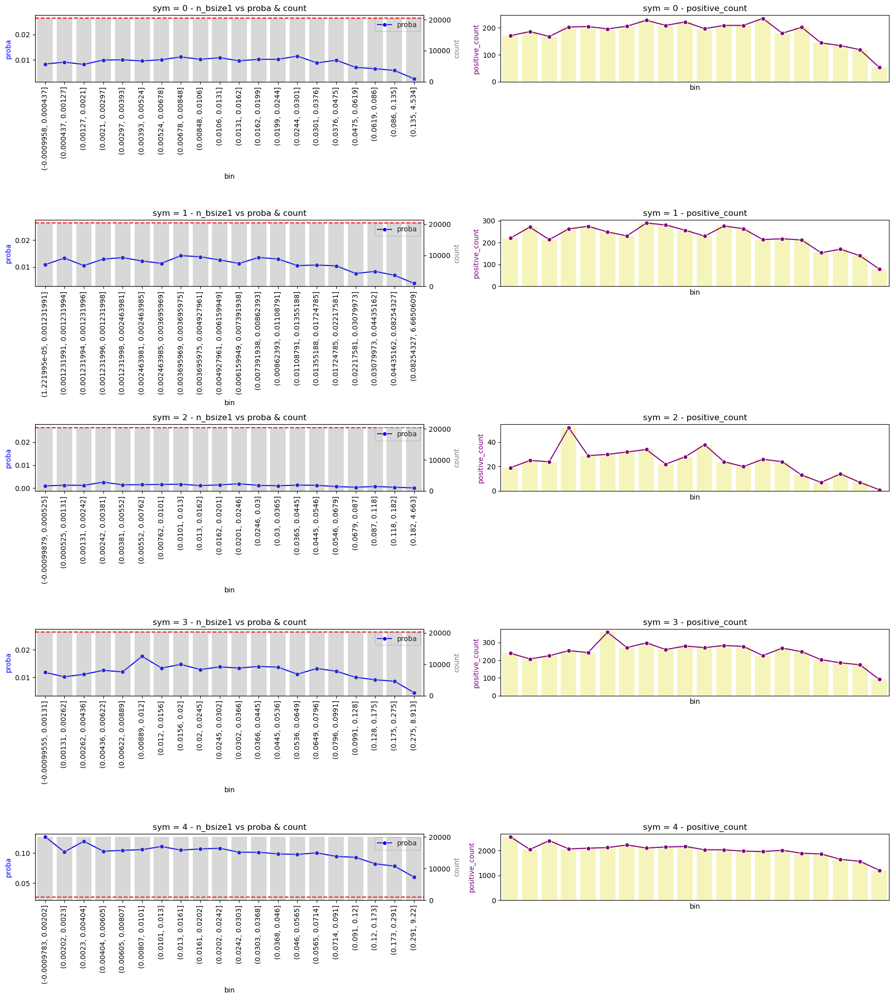

In [319]:
proba_plot_by_sym(normal_df, feature='n_bsize1', target='is_amount_0', bins=20)

In [ ]:
# 右侧图说明五支股票确实有一定的下降趋势
# 猜想2可能成立

In [ ]:
# 猜想3，股票价格n_midprice在一个狭窄的区间内波动，且没有明显的上涨或下跌趋势时，
# 投资者可能会选择观望，等待更明确的市场信号。这种情况下，交易意愿降低，导致成交量减少。
# 也就是说，n_midprice的一阶差分在给定滑窗内的标准差越小说明波动率越低，
# 这里我们构造实现波动率 realized volatility

In [294]:
def add_diff_and_rolling_features(group):
    group = group.sort_values('time') 
    group['mid_diff'] = group['n_midprice'].diff()
    group['realized_volatility'] = group['mid_diff'].shift(1).rolling(window=5, min_periods=3).std()
    return group

rolling_df = df.copy().groupby(['sym', 'date', 'time_period'], group_keys=False).apply(
    add_diff_and_rolling_features,
    include_groups=True
).dropna(axis=0)


C:\Users\15853\AppData\Local\Temp\ipykernel_18348\3180003435.py:7: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  rolling_df = df.copy().groupby(['sym', 'date', 'time_period'], group_keys=False).apply(


In [295]:
normal_rolling_df=rolling_df[rolling_df['abnormal']==0]

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\2938525997.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['bin'] = pd.qcut(df_copy['feature_with_noise'], q=bins, duplicates='raise')


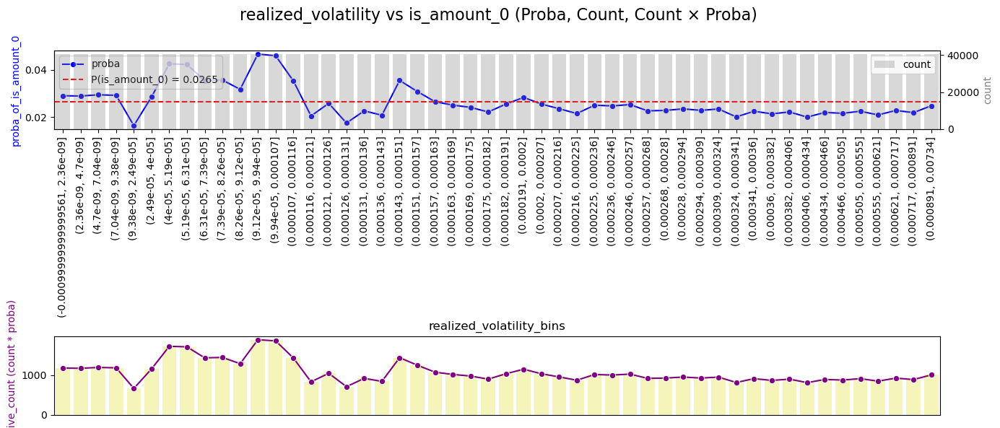

In [320]:
conditional_proba_plot(normal_rolling_df, feature='realized_volatility',target='is_amount_0', bins=50)

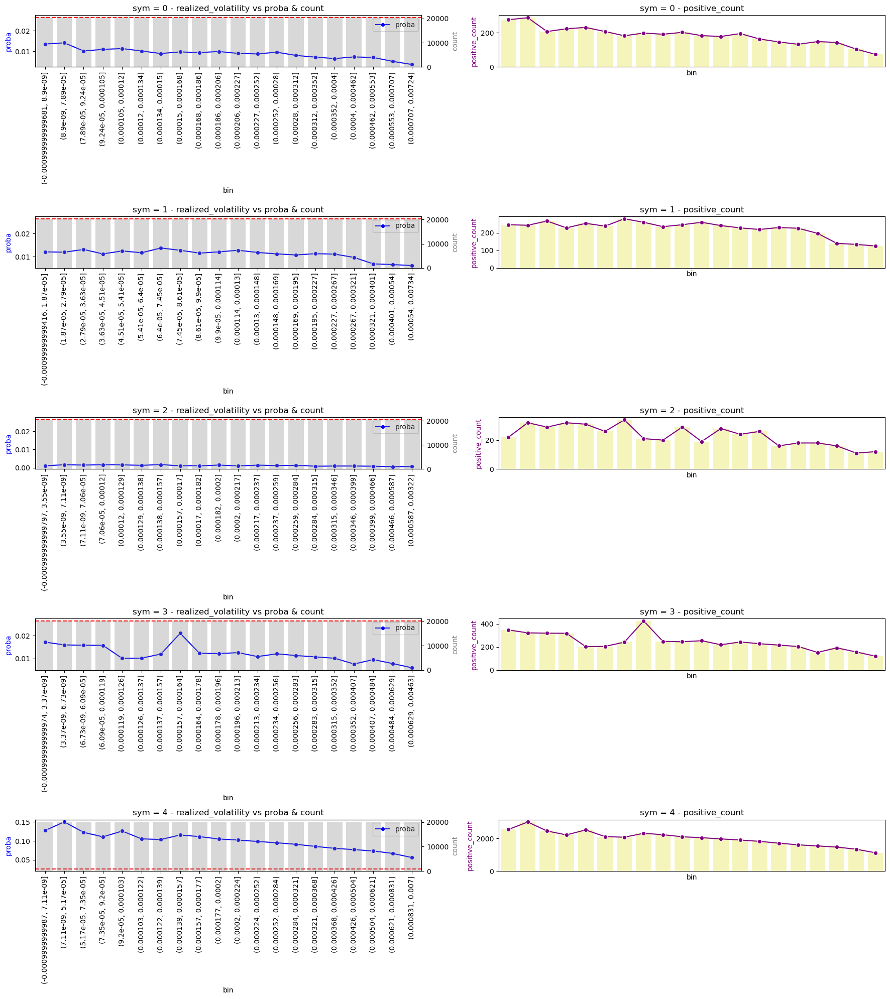

In [321]:
proba_plot_by_sym(normal_rolling_df, feature='realized_volatility', target='is_amount_0', bins=20)

In [ ]:
# 注意到五支股票成交量为0的概率均随波动性增大呈现下降趋势
# 猜想3可能正确

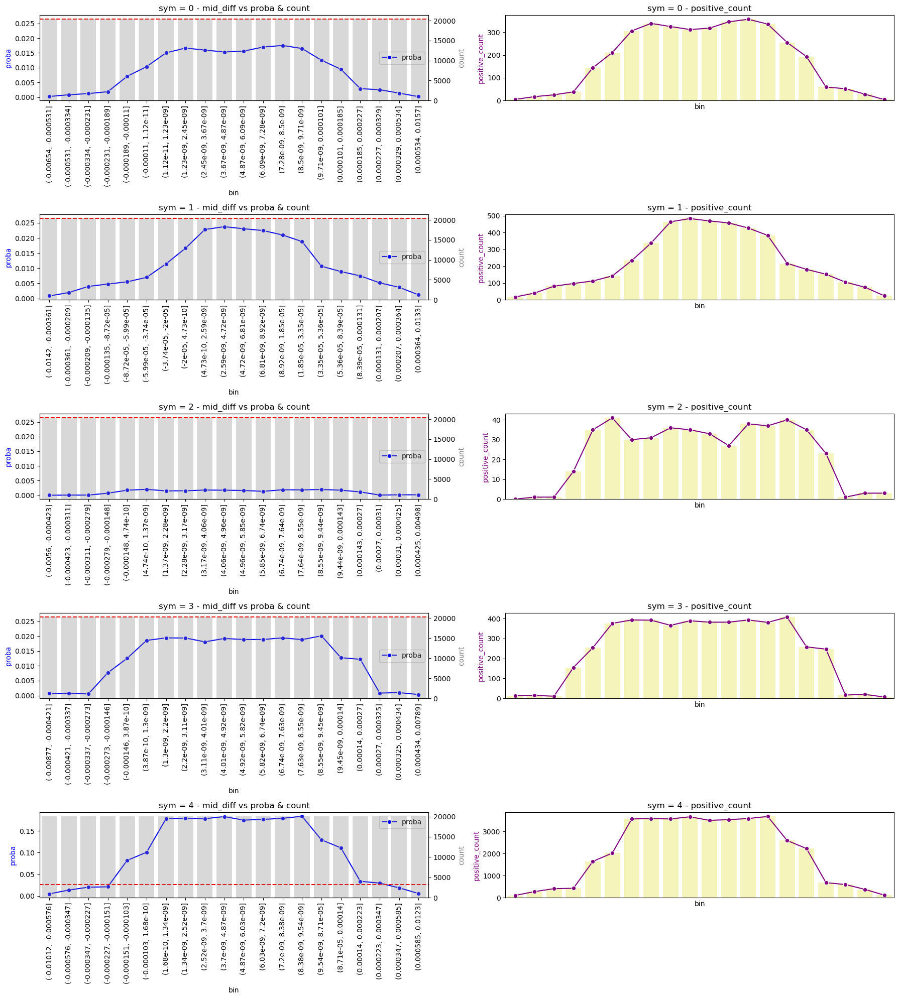

In [322]:
proba_plot_by_sym(normal_rolling_df, feature='mid_diff', target='is_amount_0', bins=20)

In [ ]:
# 同理,中间价一阶差分接近0时的0值成交量概率高
# 结论相同,猜想3可能正确

In [ ]:
# 总结:对于成交量为0的特殊点
# sym=4概率明显高于其他五支股票,且各类趋势比较明显,说明sym=4可能不被看好,大家都在观望
# 与0值交易量相关的特征如下:
# 1.is_amount_0:独热编码,直观展现成交量为0的数据点
# 2.sym:0值交易量出现频率与股票编号强相关(sym=4)
# 3.realized_volatility: 实现波动率,可能有线性关系
# 4.size类:平稳时估计不是很明显,但显然换手率高的时候成交量为0的概率肯定很低
# 5.spread价差:可能性不大

In [ ]:
# 接下来关注异常值
# 已知除去amount=0的数据后,amount近似服从正态分布
# 我们可以根据3σ原则筛选出amount异常低和异常高的点
# 研究一下跟哪些数据(字段)有关
# 首先研究低于μ-3σ的点

In [ ]:
amount_not_0=df[df['is_amount_0']==0]
μ=amount_not_0['amount'].mean()
σ=amount_not_0['amount'].std()
threshold=μ-3*σ
low_outliers = amount_not_0[amount_not_0['amount'] < threshold].copy()
low_outliers

,date,time,sym,n_close,n_open,n_high,n_low,amount_delta,n_midprice,n_bid1,n_bsize1,n_bid2,n_bsize2,n_bid3,n_bsize3,n_bid4,n_bsize4,n_bid5,n_bsize5,n_ask1,n_asize1,n_ask2,n_asize2,n_ask3,n_asize3,n_ask4,n_asize4,n_ask5,n_asize5,label_5,label_10,label_20,label_40,label_60,time_period,spread1,spread2,spread3,spread4,spread5,amount,is_amount_0,abnormal
86385,27,13:31:27,0,0.016015,0.000910,0.018198,-0.011101,223.32,0.016288,0.016015,0.036655,0.015833,0.043657,0.015651,0.022239,0.015469,0.096046,0.015287,0.003056,0.016561,0.038004,0.016742,0.006985,0.016924,0.008295,0.017106,0.016153,0.017288,0.023680,1.0,0.0,1.0,0.0,0.0,PM,0.000546,0.000910,0.001274,0.001638,0.002002,5.413074,0,0
173695,47,11:09:06,0,-0.022624,0.013386,0.014329,-0.024887,1088.64,-0.022530,-0.022624,0.059239,-0.022813,0.046918,-0.023002,0.030409,-0.023190,0.183344,-0.023379,0.320852,-0.022436,0.033104,-0.022247,0.035226,-0.022059,0.091248,-0.021870,0.016976,-0.021682,0.000849,1.0,0.0,0.0,0.0,0.0,AM,0.000189,0.000566,0.000943,0.001320,0.001697,6.993603,0,0
174116,47,13:20:12,0,-0.017534,0.013386,0.014329,-0.031863,104.22,-0.017157,-0.017345,0.001273,-0.017534,0.003387,-0.017722,0.004668,-0.017911,0.005093,-0.018100,0.005517,-0.016968,0.001273,-0.016780,0.025464,-0.016591,0.002546,-0.015837,0.003395,-0.015649,0.000849,2.0,2.0,2.0,1.0,2.0,PM,0.000377,0.000754,0.001131,0.002074,0.002451,4.656053,0,0
235307,60,14:21:15,0,-0.013155,0.000000,0.017266,-0.028777,48.01,-0.013052,-0.013155,0.000420,-0.013361,0.009746,-0.013566,0.015251,-0.013772,0.021188,-0.013977,0.019069,-0.012950,0.004238,-0.012744,0.025425,-0.012539,0.050427,-0.012333,0.021188,-0.012127,0.050003,1.0,1.0,2.0,2.0,2.0,PM,0.000206,0.000617,0.001028,0.001439,0.001850,3.892024,0,0
241567,62,11:04:24,0,0.014043,0.006383,0.024468,-0.006170,1334.48,0.014468,0.014043,0.030392,0.013830,0.000848,0.013617,0.039409,0.013404,0.013984,0.013191,0.004661,0.014894,0.020764,0.015319,0.002966,0.015532,0.000848,0.015745,0.008051,0.015957,0.056359,0.0,0.0,0.0,0.0,0.0,AM,0.000851,0.001489,0.001915,0.002340,0.002766,7.197046,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1973320,85,13:25:24,4,0.040530,0.000260,0.077683,-0.022603,760.95,0.040660,0.040530,0.001635,0.040270,0.034311,0.040010,0.022201,0.039751,0.008073,0.039231,0.032293,0.040790,0.004037,0.041309,0.012110,0.041569,0.117061,0.041829,0.094860,0.042608,0.060549,2.0,2.0,2.0,2.0,1.0,PM,0.000260,0.001039,0.001559,0.002078,0.003378,6.635881,0,0
2000753,91,11:07:42,4,0.021884,0.005529,0.033863,0.004607,266.16,0.022345,0.021884,0.032172,0.021654,0.014128,0.021193,0.020183,0.020502,0.306781,0.020272,0.002018,0.022806,0.008073,0.023267,0.008073,0.023497,0.084769,0.023727,0.018165,0.023958,0.129171,0.0,0.0,0.0,0.0,0.0,AM,0.000921,0.001613,0.002304,0.003225,0.003686,5.587848,0,0
2001113,91,13:15:45,4,0.020963,0.005529,0.033863,0.004607,531.84,0.021193,0.020963,0.019941,0.020733,0.038348,0.020502,0.189720,0.020041,0.004037,0.019811,0.056512,0.021424,0.034311,0.021654,0.044403,0.021884,0.022201,0.022115,0.217976,0.022345,0.098897,1.0,1.0,1.0,1.0,1.0,PM,0.000461,0.000921,0.001382,0.002073,0.002534,6.278221,0,0
2005324,92,13:26:24,4,0.020619,-0.013975,0.039175,-0.015120,668.25,0.021077,0.020619,0.007770,0.020389,0.022201,0.019931,0.064586,0.019702,0.119080,0.019473,0.286598,0.021535,0.032293,0.021764,0.070640,0.022222,0.106970,0.022451,0.002018,0.022910,0.121098,1.0,2.0,2.0,1.0,1.0,PM,0.000916,0.001375,0.002291,0.002749,0.003436,6.506158,0,0


In [304]:
normal_df['is_low_outliers']=(normal_df['amount']<threshold).astype(int)

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\388767488.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  normal_df['is_low_outliers']=(normal_df['amount']<threshold).astype(int)


In [305]:
normal_df

,date,time,sym,n_close,n_open,n_high,n_low,amount_delta,n_midprice,n_bid1,n_bsize1,n_bid2,n_bsize2,n_bid3,n_bsize3,n_bid4,n_bsize4,n_bid5,n_bsize5,n_ask1,n_asize1,n_ask2,n_asize2,n_ask3,n_asize3,n_ask4,n_asize4,n_ask5,n_asize5,label_5,label_10,label_20,label_40,label_60,time_period,spread1,spread2,spread3,spread4,spread5,amount,is_amount_0,abnormal,bin,is_low_outliers
0,0,09:40:03,0,-0.005000,-0.005000,0.006522,-0.013913,938523.0,-0.004783,-0.005000,0.002619,-0.005217,0.027067,-0.005435,0.088187,-0.005652,0.079893,-0.005870,0.065922,-0.004565,0.024011,-0.004130,0.003929,-0.003913,0.002619,-0.003478,0.007422,-0.003261,0.003929,0.0,0.0,0.0,0.0,0.0,AM,0.000435,0.001087,0.001522,0.002174,0.002609,13.752064,0,0,"(0.00246398, 0.00262623]",0
1,0,09:40:06,0,-0.004348,-0.005000,0.006522,-0.013913,503741.0,-0.004130,-0.004348,0.004802,-0.004783,0.010478,-0.005000,0.017463,-0.005217,0.033179,-0.005435,0.098229,-0.003913,0.002183,-0.003696,0.008731,-0.003478,0.007422,-0.003261,0.003929,-0.003043,0.008731,0.0,0.0,0.0,0.0,0.0,AM,0.000435,0.001087,0.001522,0.001957,0.002391,13.129820,0,0,"(0.00423755, 0.00492796]",0
2,0,09:40:09,0,-0.005652,-0.005000,0.006522,-0.013913,3070536.0,-0.005652,-0.005870,0.053262,-0.006087,0.047150,-0.006304,0.002183,-0.006522,0.040165,-0.006739,0.018773,-0.005435,0.013970,-0.005000,0.001746,-0.004565,0.003929,-0.004348,0.004366,-0.004130,0.021392,0.0,0.0,0.0,0.0,0.0,AM,0.000435,0.001087,0.001739,0.002174,0.002609,14.937363,0,0,"(0.0523004, 0.057675]",0
3,0,09:40:12,0,-0.006087,-0.005000,0.006522,-0.013913,1989469.0,-0.006196,-0.006304,0.002183,-0.006522,0.040165,-0.006739,0.018773,-0.006957,0.030560,-0.007174,0.011351,-0.006087,0.004366,-0.005652,0.001310,-0.005435,0.018773,-0.005000,0.002183,-0.004783,0.029687,0.0,0.0,0.0,0.0,0.0,AM,0.000217,0.000870,0.001304,0.001957,0.002391,14.503379,0,0,"(0.00218286, 0.00246398]",0
4,0,09:40:15,0,-0.006739,-0.005000,0.006522,-0.013913,1824050.0,-0.006848,-0.006957,0.030560,-0.007174,0.011351,-0.007391,0.038855,-0.007609,0.041911,-0.007826,0.007422,-0.006739,0.000437,-0.006522,0.039728,-0.005870,0.010478,-0.005652,0.010478,-0.005435,0.022265,0.0,0.0,0.0,0.0,0.0,AM,0.000217,0.000652,0.001522,0.001957,0.002391,14.416570,0,0,"(0.030227, 0.0328278]",0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2038975,9,14:49:45,4,-0.020196,0.009617,0.020035,-0.021638,85563.0,-0.020115,-0.020196,0.078282,-0.020516,0.029931,-0.020676,0.004605,-0.020837,0.013814,-0.020997,0.101306,-0.020035,0.023024,-0.019875,0.036838,-0.019715,0.013814,-0.019394,0.041443,-0.019234,0.025326,1.0,0.0,1.0,1.0,1.0,PM,0.000160,0.000641,0.000962,0.001443,0.001763,11.357020,0,0,"(0.0714205, 0.0801672]",0
2038976,9,14:49:48,4,-0.020196,0.009617,0.020035,-0.021638,91695.0,-0.020115,-0.020196,0.057560,-0.020356,0.006907,-0.020516,0.050653,-0.020676,0.006907,-0.020837,0.013814,-0.020035,0.043746,-0.019875,0.036838,-0.019715,0.013814,-0.019394,0.041443,-0.019234,0.025326,1.0,1.0,1.0,1.0,1.0,PM,0.000160,0.000481,0.000801,0.001282,0.001603,11.426234,0,0,"(0.0523004, 0.057675]",0
2038977,9,14:49:51,4,-0.020035,0.009617,0.020035,-0.021638,116148.0,-0.020115,-0.020196,0.052955,-0.020356,0.006907,-0.020516,0.020722,-0.020676,0.011512,-0.020837,0.013814,-0.020035,0.041443,-0.019875,0.036838,-0.019715,0.013814,-0.019394,0.041443,-0.019234,0.025326,1.0,1.0,1.0,1.0,1.0,PM,0.000160,0.000481,0.000801,0.001282,0.001603,11.662629,0,0,"(0.0523004, 0.057675]",0
2038978,9,14:49:54,4,-0.020196,0.009617,0.020035,-0.021638,421727.0,-0.020115,-0.020356,0.023024,-0.020516,0.002302,-0.020676,0.036838,-0.020837,0.013814,-0.020997,0.099003,-0.019875,0.036838,-0.019715,0.013814,-0.019394,0.041443,-0.019234,0.025326,-0.019074,0.080584,0.0,0.0,1.0,1.0,1.0,PM,0.000481,0.000801,0.001282,0.001603,0.001923,12.952116,0,0,"(0.0211475, 0.0231148]",0


In [308]:
# 猜想1:在某些特定时间段，如午间休市前后或临近收盘时，市场交易活跃度通常较低，可能导致成交量减少
# 因此看看time与low_outliers的关系
# 由于low_outliers数量非常少(不到1000条)
# 这里连带着amount=0一起分析(55000+1000=56000)
am_normal_df=normal_df[normal_df['time_period']=='AM']
pm_normal_df=normal_df[normal_df['time_period']=='PM']

In [310]:
def time_feature(df, name="time"):
    """
    time归一化与周期性编码
    周期性编码可能需要细化调整
    """
    t = pd.to_datetime(df[name], format='%H:%M:%S')
    hours = t.dt.hour
    minutes = t.dt.minute
    seconds = t.dt.second
    df['time_frac'] = (hours * 3600 + minutes * 60 + seconds) / 86400.0

    df['sin_time'] = np.sin(2 * np.pi * df['time_frac'])
    df['cos_time'] = np.cos(2 * np.pi * df['time_frac'])
    return df, ["sin_time", "cos_time", "time_frac"]

In [311]:
# 这里先转化成数值型特征
am_normal_df, _=time_feature(am_normal_df)
pm_normal_df, _=time_feature(pm_normal_df)

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\680681256.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['time_frac'] = (hours * 3600 + minutes * 60 + seconds) / 86400.0
C:\Users\15853\AppData\Local\Temp\ipykernel_18348\680681256.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['sin_time'] = np.sin(2 * np.pi * df['time_frac'])
C:\Users\15853\AppData\Local\Temp\ipykernel_18348\680681256.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try us

In [312]:
am_normal_df

,date,time,sym,n_close,n_open,n_high,n_low,amount_delta,n_midprice,n_bid1,n_bsize1,n_bid2,n_bsize2,n_bid3,n_bsize3,n_bid4,n_bsize4,n_bid5,n_bsize5,n_ask1,n_asize1,n_ask2,n_asize2,n_ask3,n_asize3,n_ask4,n_asize4,n_ask5,n_asize5,label_5,label_10,label_20,label_40,label_60,time_period,spread1,spread2,spread3,spread4,spread5,amount,is_amount_0,abnormal,bin,is_low_outliers,time_frac,sin_time,cos_time
0,0,09:40:03,0,-0.005000,-0.005000,0.006522,-0.013913,938523.0,-0.004783,-0.005000,0.002619,-0.005217,0.027067,-0.005435,0.088187,-0.005652,0.079893,-0.005870,0.065922,-0.004565,0.024011,-0.004130,0.003929,-0.003913,0.002619,-0.003478,0.007422,-0.003261,0.003929,0.0,0.0,0.0,0.0,0.0,AM,0.000435,0.001087,0.001522,0.002174,0.002609,13.752064,0,0,"(0.00246398, 0.00262623]",0,0.402813,0.573398,-0.819277
1,0,09:40:06,0,-0.004348,-0.005000,0.006522,-0.013913,503741.0,-0.004130,-0.004348,0.004802,-0.004783,0.010478,-0.005000,0.017463,-0.005217,0.033179,-0.005435,0.098229,-0.003913,0.002183,-0.003696,0.008731,-0.003478,0.007422,-0.003261,0.003929,-0.003043,0.008731,0.0,0.0,0.0,0.0,0.0,AM,0.000435,0.001087,0.001522,0.001957,0.002391,13.129820,0,0,"(0.00423755, 0.00492796]",0,0.402847,0.573219,-0.819402
2,0,09:40:09,0,-0.005652,-0.005000,0.006522,-0.013913,3070536.0,-0.005652,-0.005870,0.053262,-0.006087,0.047150,-0.006304,0.002183,-0.006522,0.040165,-0.006739,0.018773,-0.005435,0.013970,-0.005000,0.001746,-0.004565,0.003929,-0.004348,0.004366,-0.004130,0.021392,0.0,0.0,0.0,0.0,0.0,AM,0.000435,0.001087,0.001739,0.002174,0.002609,14.937363,0,0,"(0.0523004, 0.057675]",0,0.402882,0.573040,-0.819527
3,0,09:40:12,0,-0.006087,-0.005000,0.006522,-0.013913,1989469.0,-0.006196,-0.006304,0.002183,-0.006522,0.040165,-0.006739,0.018773,-0.006957,0.030560,-0.007174,0.011351,-0.006087,0.004366,-0.005652,0.001310,-0.005435,0.018773,-0.005000,0.002183,-0.004783,0.029687,0.0,0.0,0.0,0.0,0.0,AM,0.000217,0.000870,0.001304,0.001957,0.002391,14.503379,0,0,"(0.00218286, 0.00246398]",0,0.402917,0.572861,-0.819652
4,0,09:40:15,0,-0.006739,-0.005000,0.006522,-0.013913,1824050.0,-0.006848,-0.006957,0.030560,-0.007174,0.011351,-0.007391,0.038855,-0.007609,0.041911,-0.007826,0.007422,-0.006739,0.000437,-0.006522,0.039728,-0.005870,0.010478,-0.005652,0.010478,-0.005435,0.022265,0.0,0.0,0.0,0.0,0.0,AM,0.000217,0.000652,0.001522,0.001957,0.002391,14.416570,0,0,"(0.030227, 0.0328278]",0,0.402951,0.572683,-0.819777
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2036976,9,11:19:45,4,-0.013784,0.009617,0.020035,-0.017791,18459.0,-0.014025,-0.014105,0.154261,-0.014265,1.653126,-0.014425,0.034536,-0.014586,0.025326,-0.014746,0.009210,-0.013945,0.027629,-0.013784,0.029931,-0.013624,0.142749,-0.013464,0.002302,-0.013303,0.036838,1.0,1.0,1.0,1.0,1.0,AM,0.000160,0.000481,0.000801,0.001122,0.001443,9.823362,0,0,"(0.142245, 0.175583]",0,0.472049,0.174722,-0.984618
2036977,9,11:19:48,4,-0.014105,0.009617,0.020035,-0.017791,36907.0,-0.014025,-0.014105,0.142749,-0.014265,1.653126,-0.014425,0.034536,-0.014586,0.025326,-0.014746,0.009210,-0.013945,0.025326,-0.013784,0.041443,-0.013624,0.142749,-0.013464,0.002302,-0.013303,0.036838,1.0,1.0,0.0,1.0,1.0,AM,0.000160,0.000481,0.000801,0.001122,0.001443,10.516184,0,0,"(0.142245, 0.175583]",0,0.472083,0.174508,-0.984656
2036978,9,11:19:51,4,-0.014105,0.009617,0.020035,-0.017791,18453.0,-0.014025,-0.014105,0.255567,-0.014265,1.653126,-0.014425,0.034536,-0.014586,0.025326,-0.014746,0.009210,-0.013945,0.043746,-0.013784,0.046048,-0.013624,0.131237,-0.013464,0.002302,-0.013303,0.036838,1.0,1.0,0.0,1.0,1.0,AM,0.000160,0.000481,0.000801,0.001122,0.001443,9.823036,0,0,"(0.229881, 0.359566]",0,0.472118,0.174293,-0.984694
2036979,9,11:19:54,4,-0.014105,0.009617,0.020035,-0.017791,18455.0,-0.014025,-0.014105,0.253264,-0.014265,1.653126,-0.014425,0.034536,-0.014586,0.025326,-0.014746,0.009210,-0.013945,0.041443,-0.

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\2938525997.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['bin'] = pd.qcut(df_copy['feature_with_noise'], q=bins, duplicates='raise')


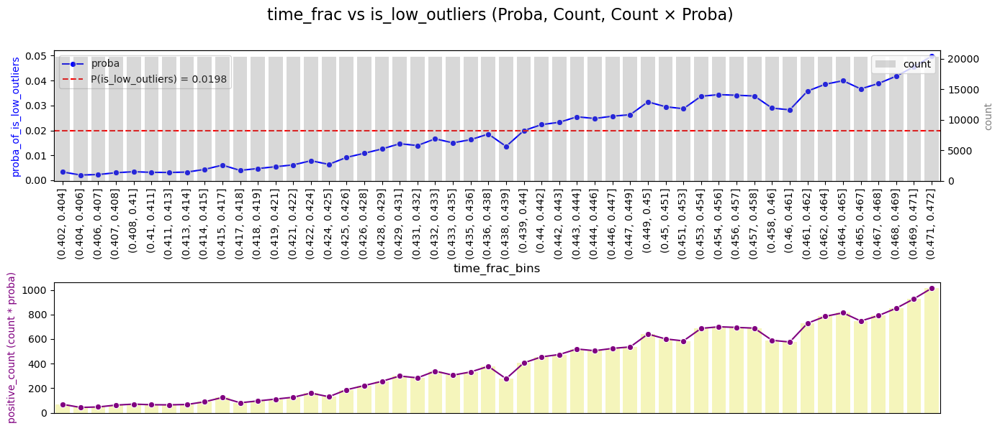

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\2938525997.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['bin'] = pd.qcut(df_copy['feature_with_noise'], q=bins, duplicates='raise')


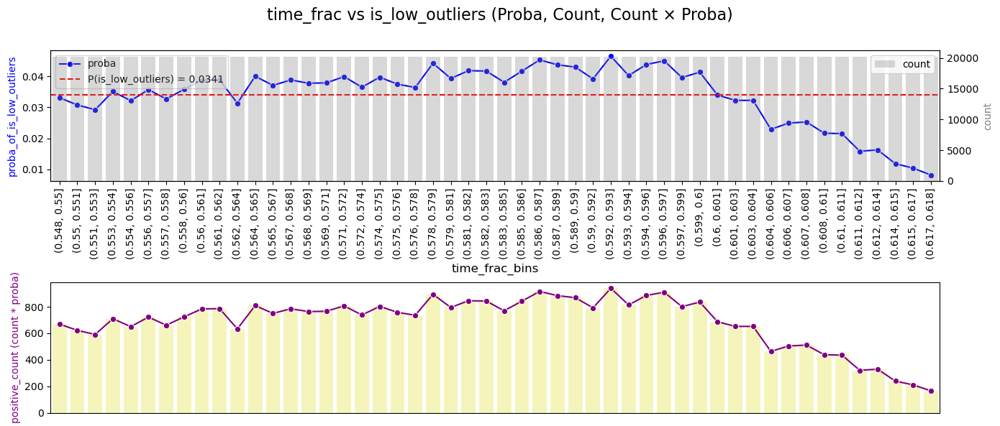

In [325]:
conditional_proba_plot(am_normal_df, feature='time_frac', target='is_low_outliers', bins=50)
conditional_proba_plot(pm_normal_df, feature='time_frac', target='is_low_outliers', bins=50)

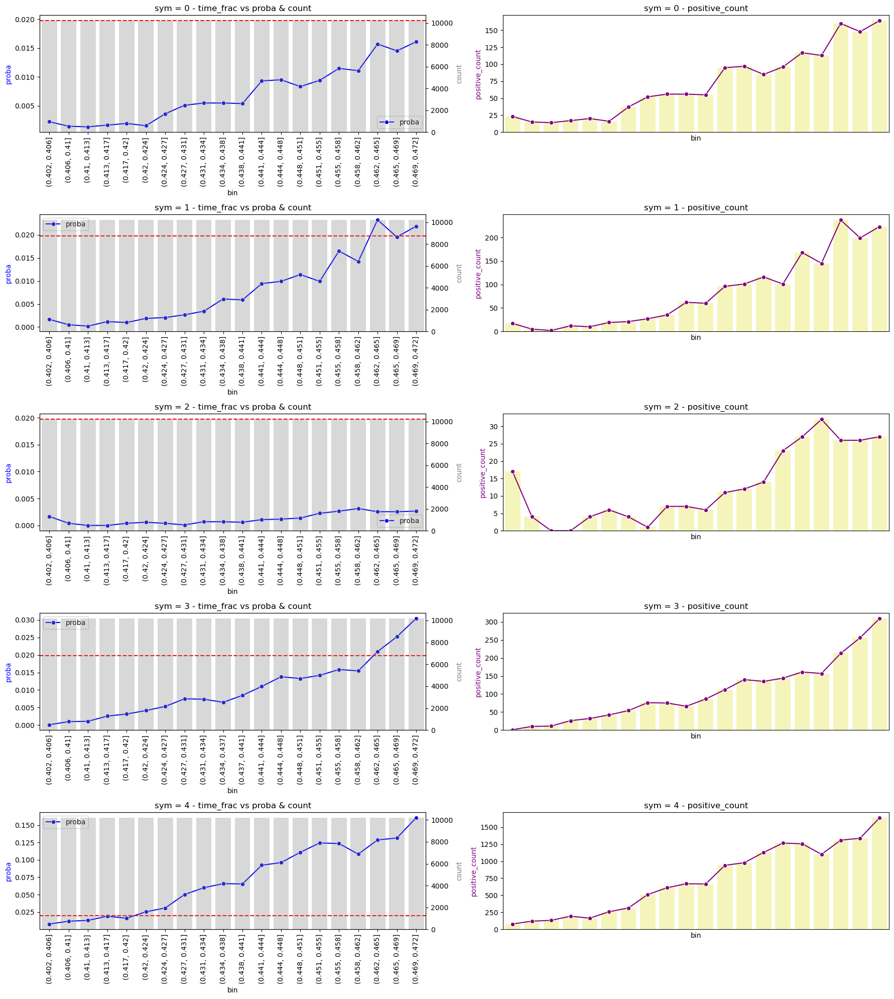

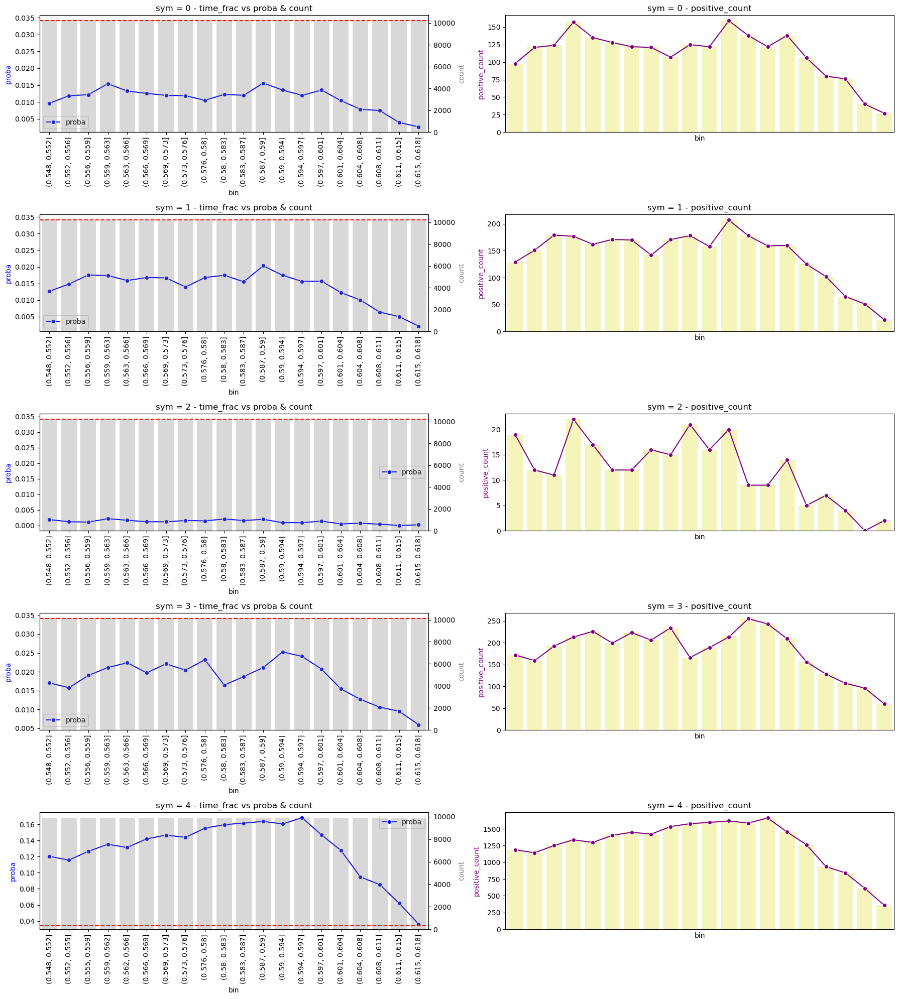

In [326]:
proba_plot_by_sym(am_normal_df, feature='time_frac', target='is_low_outliers', bins=20)
proba_plot_by_sym(pm_normal_df, feature='time_frac', target='is_low_outliers', bins=20)

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\2938525997.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['bin'] = pd.qcut(df_copy['feature_with_noise'], q=bins, duplicates='raise')


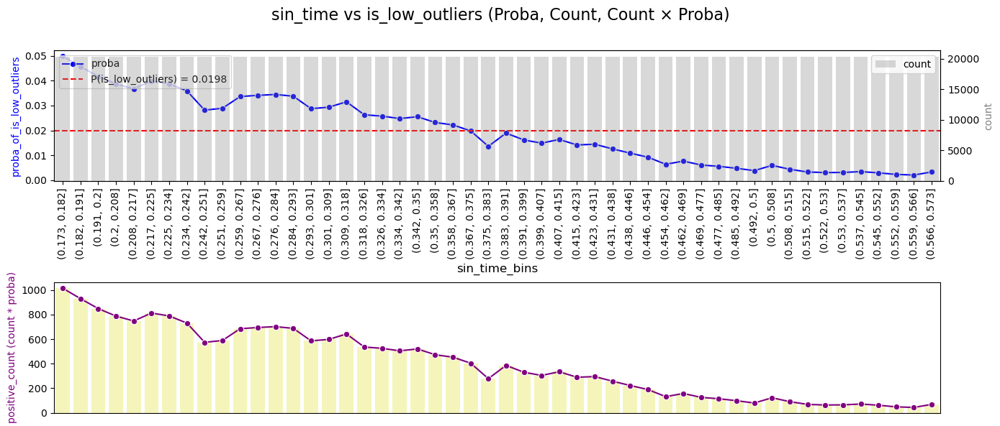

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\2938525997.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['bin'] = pd.qcut(df_copy['feature_with_noise'], q=bins, duplicates='raise')


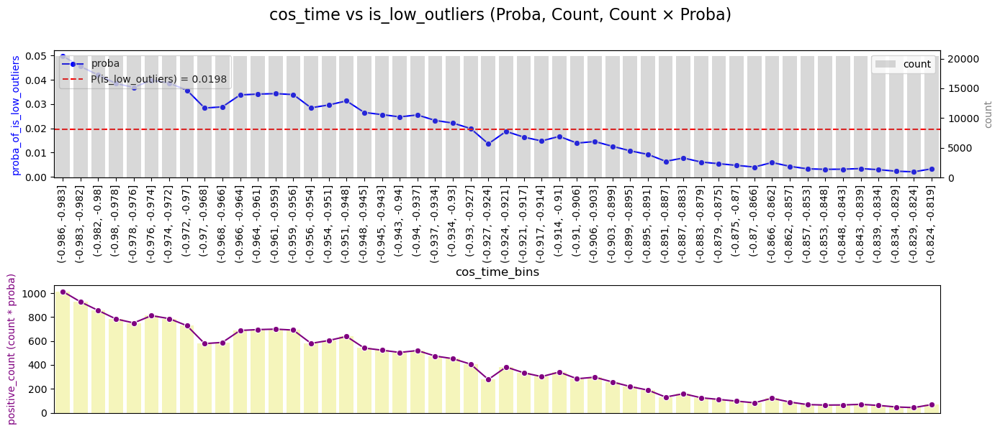

In [327]:
# 上午am的数据是非常明显的线性关系,下午pm则是先上升后下降
# 再看看周期性
conditional_proba_plot(am_normal_df, feature='sin_time', target='is_low_outliers', bins=50)
conditional_proba_plot(am_normal_df, feature='cos_time', target='is_low_outliers', bins=50)

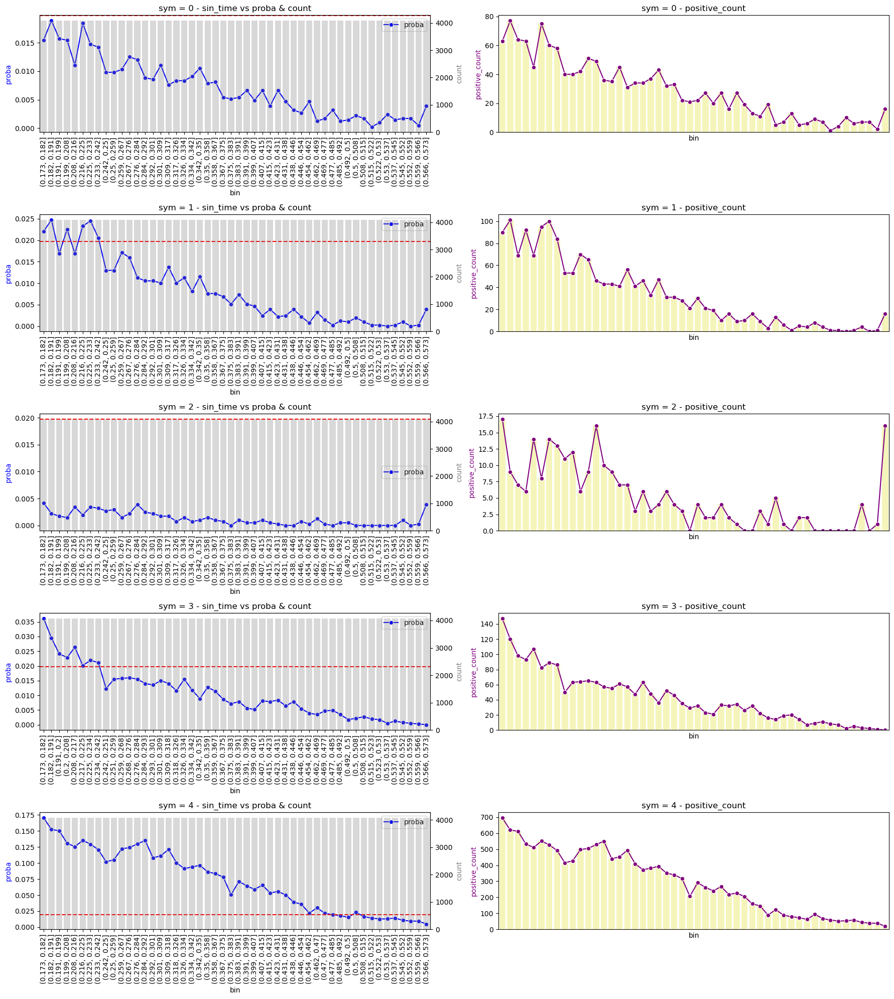

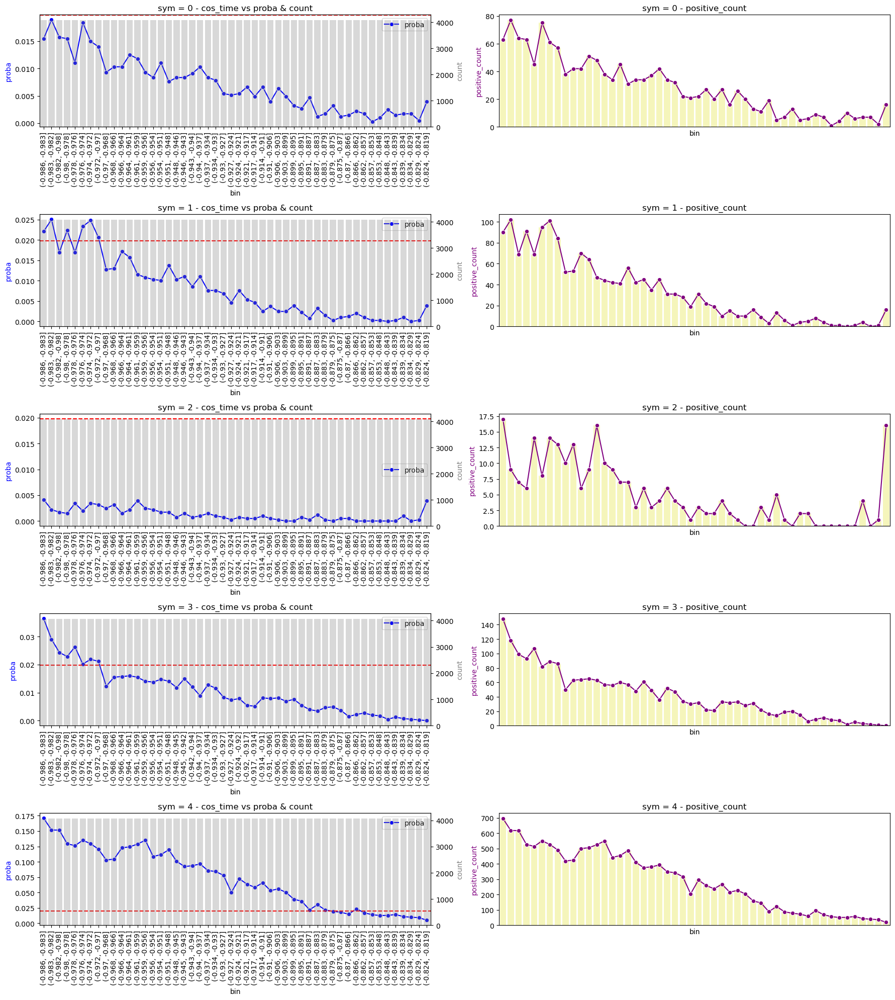

In [328]:
proba_plot_by_sym(am_normal_df, feature='sin_time', target='is_low_outliers', bins=50)
proba_plot_by_sym(am_normal_df, feature='cos_time', target='is_low_outliers', bins=50)

In [331]:
# 大体相同,但是注意到sym=2在某一时刻有突变
am_normal_df[(am_normal_df['sym']==2)&(am_normal_df['is_low_outliers'])&(am_normal_df['sin_time']<=0.573)&(am_normal_df['sin_time']>0.566)]

,date,time,sym,n_close,n_open,n_high,n_low,amount_delta,n_midprice,n_bid1,n_bsize1,n_bid2,n_bsize2,n_bid3,n_bsize3,n_bid4,n_bsize4,n_bid5,n_bsize5,n_ask1,n_asize1,n_ask2,n_asize2,n_ask3,n_asize3,n_ask4,n_asize4,n_ask5,n_asize5,label_5,label_10,label_20,label_40,label_60,time_period,spread1,spread2,spread3,spread4,spread5,amount,is_amount_0,abnormal,bin,is_low_outliers,time_frac,sin_time,cos_time
1067469,65,09:40:12,2,-0.00249,0.001245,0.001245,-0.006536,0.0,-0.002646,-0.002801,0.003151,-0.003112,0.003151,-0.003424,0.002364,-0.003735,0.012868,-0.004046,0.052524,-0.00249,0.019171,-0.002179,0.026945,-0.001556,0.010636,-0.001245,0.018173,-0.000934,0.025343,1.0,1.0,2.0,2.0,2.0,AM,0.000311,0.000934,0.001867,0.00249,0.003112,0.0,1,0,"(-0.824, -0.819]",1,0.402917,0.572861,-0.819652
1067470,65,09:40:15,2,-0.00249,0.001245,0.001245,-0.006536,0.0,-0.002646,-0.002801,0.003151,-0.003112,0.003151,-0.003424,0.002364,-0.003735,0.012868,-0.004046,0.052524,-0.00249,0.019171,-0.002179,0.026945,-0.001556,0.010636,-0.001245,0.018173,-0.000934,0.025343,1.0,1.0,2.0,2.0,2.0,AM,0.000311,0.000934,0.001867,0.00249,0.003112,0.0,1,0,"(-0.824, -0.819]",1,0.402951,0.572683,-0.819777
1067471,65,09:40:18,2,-0.00249,0.001245,0.001245,-0.006536,0.0,-0.002646,-0.002801,0.003151,-0.003112,0.003151,-0.003424,0.002364,-0.003735,0.012868,-0.004046,0.052524,-0.00249,0.019171,-0.002179,0.026945,-0.001556,0.010636,-0.001245,0.018173,-0.000934,0.025343,1.0,1.0,2.0,2.0,2.0,AM,0.000311,0.000934,0.001867,0.00249,0.003112,0.0,1,0,"(-0.824, -0.819]",1,0.402986,0.572504,-0.819902
1067472,65,09:40:21,2,-0.00249,0.001245,0.001245,-0.006536,0.0,-0.002646,-0.002801,0.003151,-0.003112,0.003151,-0.003424,0.002364,-0.003735,0.012868,-0.004046,0.052524,-0.00249,0.019171,-0.002179,0.026945,-0.001556,0.010636,-0.001245,0.018173,-0.000934,0.025343,1.0,2.0,2.0,2.0,2.0,AM,0.000311,0.000934,0.001867,0.00249,0.003112,0.0,1,0,"(-0.824, -0.819]",1,0.403021,0.572325,-0.820027
1067473,65,09:40:24,2,-0.00249,0.001245,0.001245,-0.006536,0.0,-0.002646,-0.002801,0.003151,-0.003112,0.003151,-0.003424,0.002364,-0.003735,0.012868,-0.004046,0.052524,-0.00249,0.019171,-0.002179,0.026945,-0.001556,0.010636,-0.001245,0.018173,-0.000934,0.025343,1.0,2.0,2.0,2.0,2.0,AM,0.000311,0.000934,0.001867,0.00249,0.003112,0.0,1,0,"(-0.824, -0.819]",1,0.403056,0.572146,-0.820152
1067474,65,09:40:27,2,-0.00249,0.001245,0.001245,-0.006536,0.0,-0.002646,-0.002801,0.003151,-0.003112,0.003151,-0.003424,0.002364,-0.003735,0.012868,-0.004046,0.052524,-0.00249,0.019171,-0.002179,0.026945,-0.001556,0.010636,-0.001245,0.018173,-0.000934,0.025343,1.0,2.0,2.0,2.0,2.0,AM,0.000311,0.000934,0.001867,0.00249,0.003112,0.0,1,0,"(-0.824, -0.819]",1,0.403090,0.571967,-0.820277
1067475,65,09:40:30,2,-0.00249,0.001245,0.001245,-0.006536,0.0,-0.002646,-0.002801,0.003151,-0.003112,0.003151,-0.003424,0.002364,-0.003735,0.012868,-0.004046,0.052524,-0.00249,0.019171,-0.002179,0.026945,-0.001556,0.010636,-0.001245,0.018173,-0.000934,0.025343,1.0,2.0,2.0,2.0,2.0,AM,0.000311,0.000934,0.001867,0.00249,0.003112,0.0,1,0,"(-0.824, -0.819]",1,0.403125,0.571788,-0.820401
1067476,65,09:40:33,2,-0.00249,0.001245,0.001245,-0.006536,0.0,-0.002646,-0.002801,0.003151,-0.003112,0.003151,-0.003424,0.002364,-0.003735,0.012868,-0.004046,0.052524,-0.00249,0.019171,-0.002179,0.026945,-0.001556,0.010636,-0.001245,0.018173,-0.000934,0.025343,1.0,2.0,2.0,2.0,2.0,AM,0.000311,0.000934,0.001867,0.00249,0.003112,0.0,1,0,"(-0.824, -0.819]",1,0.403160,0.571609,-0.820526
1067477,65,09:40:36,2,-0.00249,0.001245,0.001245,-0.006536,0.0,-0.002646,-0.002801,0.003151,-0.003112,0.003151,-0.003424,0.002364,-0.003735,0.012868,-0.004046,0.052524,-0.00249,0.019171,-0.002179,0.026945,-0.001556,0.010636,-0.001245,0.018173,-0.000934,0.025343,2.0,2.0,2.0,2.0,2.0,AM,0.000311,0.000934,0.001867,0.00249,0.003112,0.0,1,0,"(-0.824, -0.819]",1,0.403194,0.571430,-0.820651
1067478,65,09:40:39,2,-0.00249,0.001245,0.001245,-0.006536,0.0,-0.002646,-0.002801,0.003151,-0.003112,0.003151,-0.003424,0.0023

In [ ]:
# 可以发现整整12个ticks均无成交量,非常特殊
# 这个可能会比较重要
# 再看看下午的周期性数据

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\2938525997.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['bin'] = pd.qcut(df_copy['feature_with_noise'], q=bins, duplicates='raise')


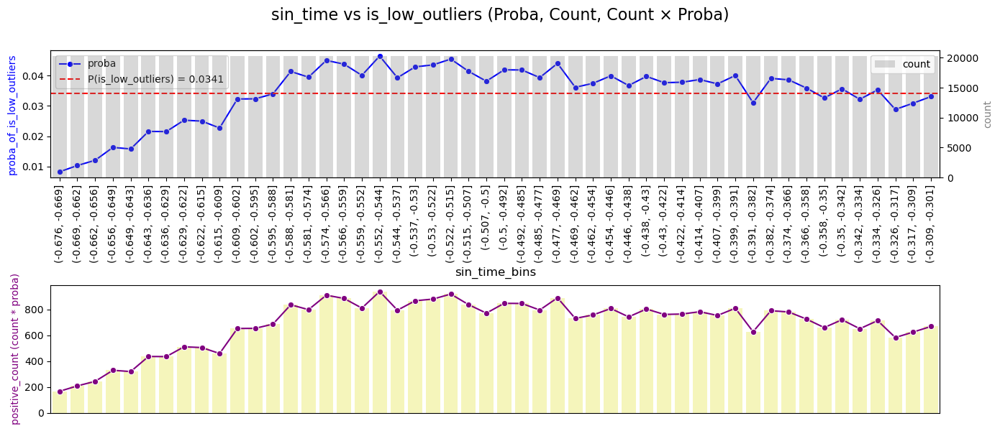

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\2938525997.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['bin'] = pd.qcut(df_copy['feature_with_noise'], q=bins, duplicates='raise')


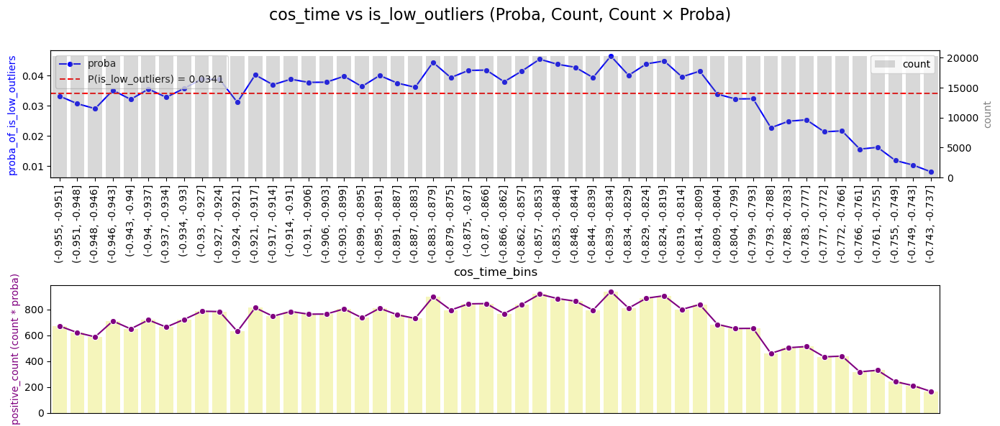

In [333]:
conditional_proba_plot(pm_normal_df, feature='sin_time', target='is_low_outliers', bins=50)
conditional_proba_plot(pm_normal_df, feature='cos_time', target='is_low_outliers', bins=50)

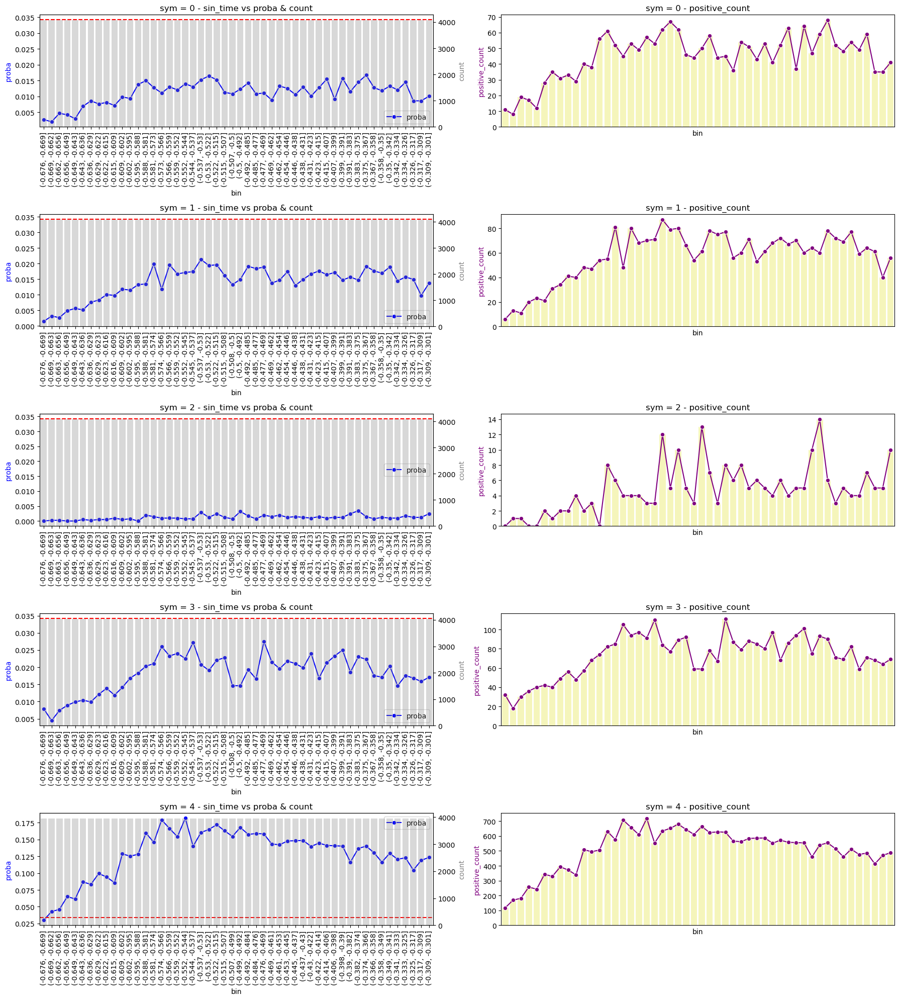

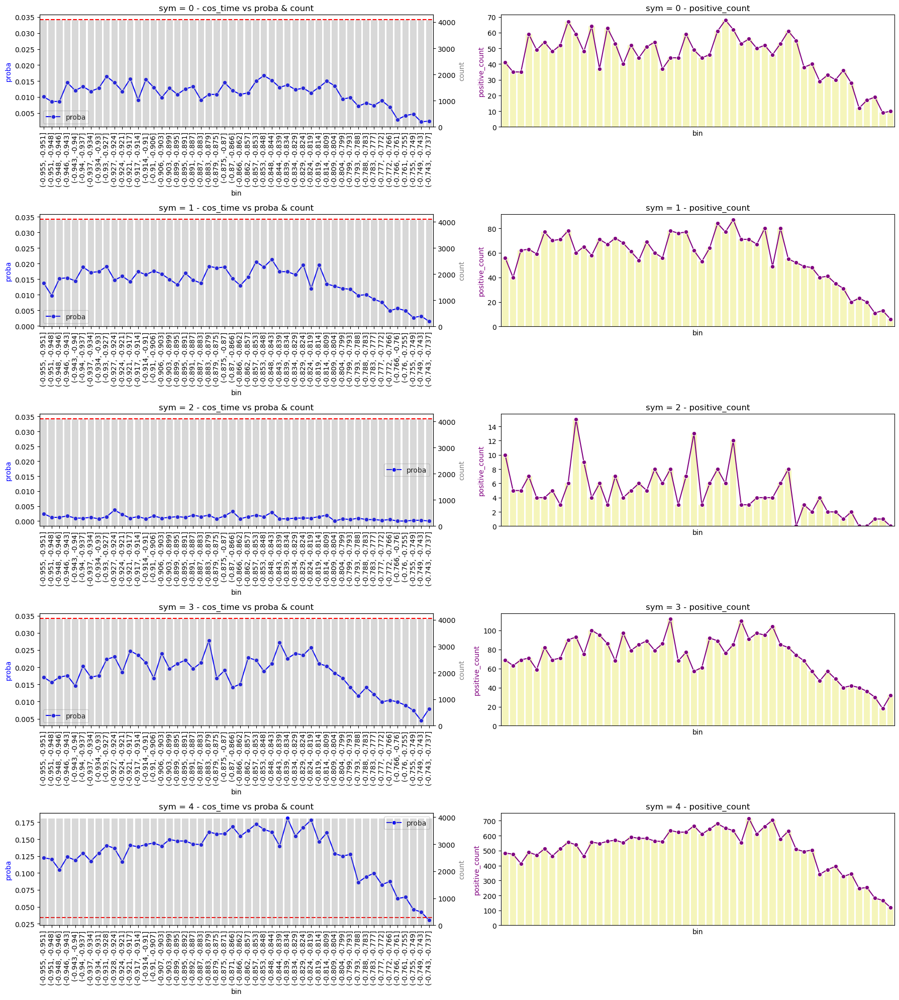

In [334]:
proba_plot_by_sym(pm_normal_df, feature='sin_time', target='is_low_outliers', bins=50)
proba_plot_by_sym(pm_normal_df, feature='cos_time', target='is_low_outliers', bins=50)

In [ ]:
# 说明下午交易量低的概率比较高,但是快收盘的时候反而交易量会有拉升
# time_frac/sin_time/cos_time三个感觉选一个就行,都能体现信息量
# 但是不知道三个都保留会不会有多重共线性,还是看看feature_importance

In [ ]:
# 总结:猜想1成立,amount异常低确实与时间有关,
# 具体体现为开盘和收盘附近交易量不低
# 但是从开盘到上午停盘成交量有走低的趋势
# 从下午到下午收盘成交量有走高的趋势
# 如果再看看成交量异常高与时间的关系即可完善
# 关于时间方面的特征:
# 1.time_frac/sin_time/cos_time:三选一
# 2.独热编码或者连续函数:标记开盘和收盘附近的时间段,具体可以用函数来拟合(sigmond)

In [ ]:
# 由于low_outliers数量非常少(不到1000条)
# 这里就默认amount=0的三个猜想再amount异常低的情况下也成立
# 接下来讨论处置效应:投资者更倾向于卖出盈利资产，而不是止损亏损资产
# 也就是下跌的时候成交量可能会少
# 看mid_price<0时is_low_outliers的概率

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\2938525997.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['bin'] = pd.qcut(df_copy['feature_with_noise'], q=bins, duplicates='raise')


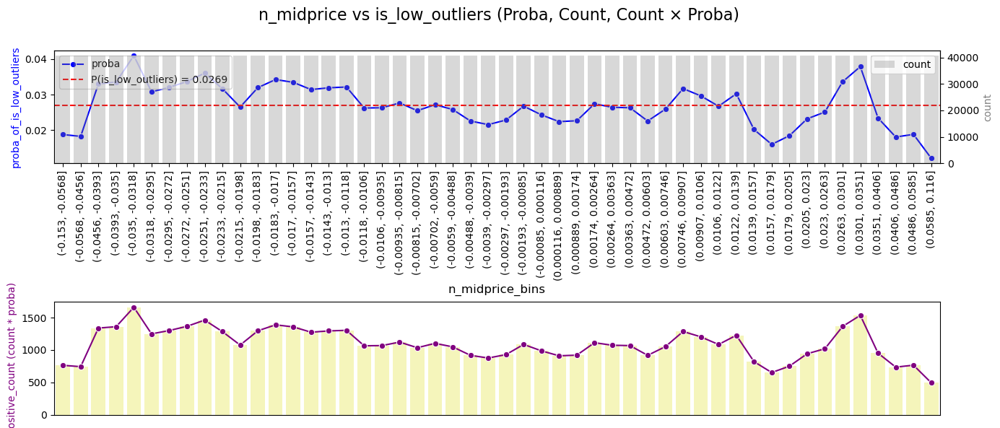

In [336]:
conditional_proba_plot(normal_df, feature='n_midprice', target='is_low_outliers', bins=50)

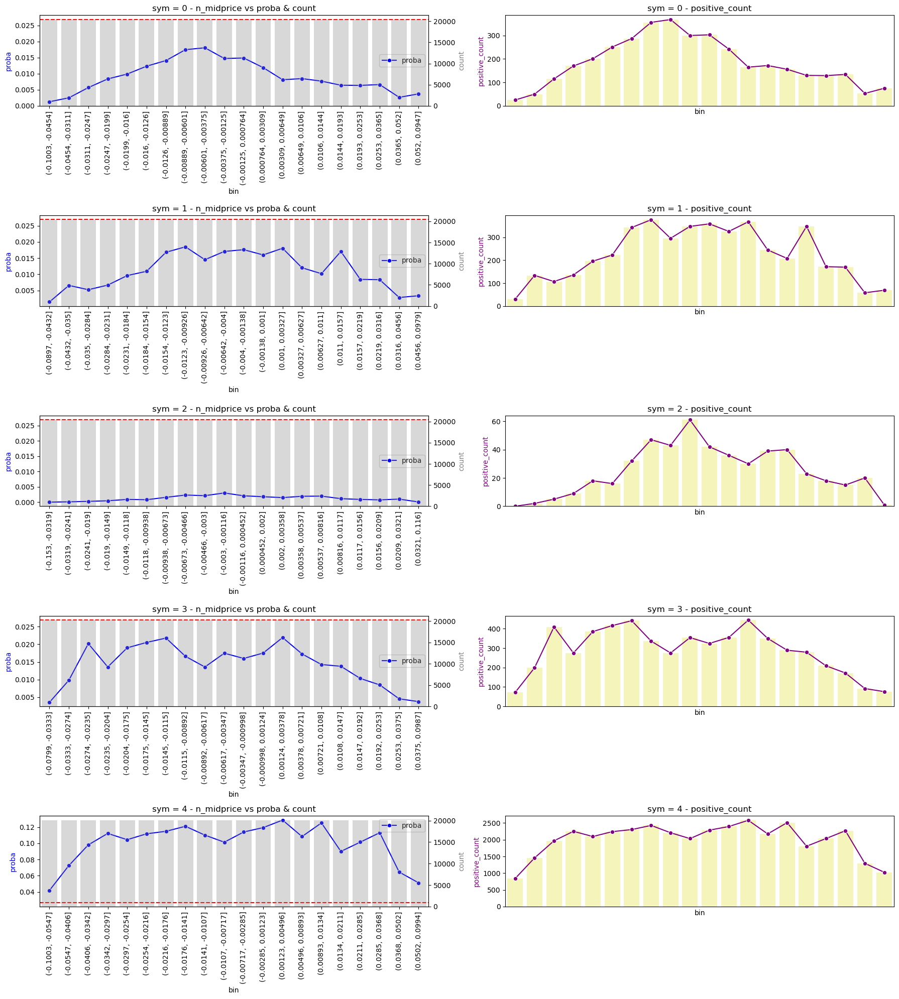

In [337]:
proba_plot_by_sym(normal_df, feature='n_midprice', target='is_low_outliers', bins=20)

In [ ]:
# 总体看不太懂,可能是由于每支股票mid_price分布不太一样
# 但是分开看每一只股票都是明显的中间高两头低
# 也就是在不涨不跌或者缓慢下跌附近不交易的概率要大
# 看不出走势必然偏向保守,成交量会比较低

# 在价格下跌（n_midprice < 0）的样本中，成交量异常低的概率是否比较大
# 所以我们定义一个趋势指标
# 趋势小于0代表下跌,大于0代表上涨,绝对值越大代表趋势越明显

In [365]:
def compute_trend_tstat(group, col, window=20, long=True, epsilon=1e-8):
    """
    计算滑动窗口的趋势指标（t-statistic）：均值/标准差，乘以sqrt(window)以强化长期效应
    参数：
        group (DataFrame): 一段时间序列数据，需包含 col 列和 'time'
        col (str): 要计算差分的列名，如 'mid_diff'
        window (int): 滑动窗口长度（tick 数）
        long (bool): 是否乘以 sqrt(window) 来放大长期效应
        min_periods (int): rolling 最少窗口数，默认 window//2
        epsilon (float): 防止除以零的小常数
    返回：
        DataFrame: 增加一列 'trend_tstat_{window}'
    """
    # 排序 & 计算差分
    group = group.sort_values('time')
    group[f'{col}_diff'] = group[col].diff()

    # 滑动窗口均值与标准差
    group[f'rolling_{window}_{col}_diff_sum'] = group[f'{col}_diff'].rolling(window=window).sum()
    group[f'rolling_{window}_{col}_diff_std']  = group[f'{col}_diff'].rolling(window=window).std()

    # 计算 t-statistic
    t_stat = (group[f'rolling_{window}_{col}_diff_sum'] / (group[f'rolling_{window}_{col}_diff_std'] + epsilon)) / window

    # 放大长期效应
    if long:
        t_stat = t_stat * np.sqrt(window)

    group[f'trend_tstat_{window}'] = t_stat
    return group


In [366]:
rolling_df = (
    df.copy()
    .groupby(['sym', 'date', 'time_period'], group_keys=False)
    .apply(compute_trend_tstat, col='n_midprice', window=20)
    .dropna(subset=[f'trend_tstat_20'])
)

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\3449171846.py:2: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df.copy()


In [367]:
rolling_df

,date,time,sym,n_close,n_open,n_high,n_low,amount_delta,n_midprice,n_bid1,n_bsize1,n_bid2,n_bsize2,n_bid3,n_bsize3,n_bid4,n_bsize4,n_bid5,n_bsize5,n_ask1,n_asize1,n_ask2,n_asize2,n_ask3,n_asize3,n_ask4,n_asize4,n_ask5,n_asize5,label_5,label_10,label_20,label_40,label_60,time_period,spread1,spread2,spread3,spread4,spread5,amount,is_amount_0,abnormal,n_midprice_diff,rolling_20_n_midprice_diff_sum,rolling_20_n_midprice_diff_std,trend_tstat_20
20,0,09:41:03,0,-0.010870,-0.005000,0.006522,-0.013913,1373887.0,-0.011087,-0.011304,0.019209,-0.011739,0.104341,-0.011957,0.127915,-0.012174,0.014843,-0.012391,0.068978,-0.010870,0.001746,-0.010652,0.009605,-0.009783,0.002183,-0.009565,0.023138,-0.009348,0.044094,2.0,2.0,1.0,0.0,0.0,AM,0.000435,0.001087,0.002174,0.002609,0.003043,14.133155,0,0,-5.434783e-04,-0.006304,0.000790,-1.784271
21,0,09:41:06,0,-0.010652,-0.005000,0.006522,-0.013913,705169.0,-0.010543,-0.010652,0.005675,-0.010870,0.071161,-0.011087,0.004366,-0.011304,0.010478,-0.011522,0.004802,-0.010435,0.000437,-0.010000,0.006549,-0.009783,0.000437,-0.009565,0.023138,-0.009348,0.044094,1.0,1.0,0.0,0.0,0.0,AM,0.000217,0.000870,0.001304,0.001739,0.002174,13.466194,0,0,5.434783e-04,-0.006413,0.000783,-1.830462
22,0,09:41:09,0,-0.010652,-0.005000,0.006522,-0.013913,1032921.0,-0.010761,-0.010870,0.086441,-0.011087,0.006112,-0.011304,0.021392,-0.011522,0.009168,-0.011739,0.038418,-0.010652,0.020955,-0.009783,0.003056,-0.009565,0.023138,-0.009348,0.044530,-0.009130,0.327429,1.0,1.0,0.0,0.0,0.0,AM,0.000217,0.001304,0.001739,0.002174,0.002609,13.847902,0,0,-2.173913e-04,-0.005109,0.000731,-1.563403
23,0,09:41:12,0,-0.010435,-0.005000,0.006522,-0.013913,650742.0,-0.010000,-0.010217,0.000437,-0.010652,0.003929,-0.010870,0.095173,-0.011087,0.007422,-0.011304,0.042347,-0.009783,0.007422,-0.009565,0.023138,-0.009348,0.044530,-0.009130,0.327429,-0.008696,0.092990,1.0,0.0,0.0,0.0,0.0,AM,0.000435,0.001087,0.001522,0.001957,0.002609,13.385870,0,0,7.608696e-04,-0.003804,0.000761,-1.117569
24,0,09:41:15,0,-0.010870,-0.005000,0.006522,-0.013913,3343684.0,-0.010761,-0.010870,0.003056,-0.011522,0.001746,-0.011739,0.027504,-0.011957,0.235749,-0.012174,0.016153,-0.010652,0.062866,-0.010435,0.003056,-0.010217,0.004802,-0.010000,0.000437,-0.009783,0.009605,1.0,1.0,1.0,0.0,0.0,AM,0.000217,0.001087,0.001522,0.001957,0.002391,15.022584,0,0,-7.608696e-04,-0.003913,0.000765,-1.143715
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2038975,9,14:49:45,4,-0.020196,0.009617,0.020035,-0.021638,85563.0,-0.020115,-0.020196,0.078282,-0.020516,0.029931,-0.020676,0.004605,-0.020837,0.013814,-0.020997,0.101306,-0.020035,0.023024,-0.019875,0.036838,-0.019715,0.013814,-0.019394,0.041443,-0.019234,0.025326,1.0,0.0,1.0,1.0,1.0,PM,0.000160,0.000641,0.000962,0.001443,0.001763,11.357020,0,0,4.808463e-04,0.000721,0.000278,0.579720
2038976,9,14:49:48,4,-0.020196,0.009617,0.020035,-0.021638,91695.0,-0.020115,-0.020196,0.057560,-0.020356,0.006907,-0.020516,0.050653,-0.020676,0.006907,-0.020837,0.013814,-0.020035,0.043746,-0.019875,0.036838,-0.019715,0.013814,-0.019394,0.041443,-0.019234,0.025326,1.0,1.0,1.0,1.0,1.0,PM,0.000160,0.000481,0.000801,0.001282,0.001603,11.426234,0,0,0.000000e+00,0.000561,0.000277,0.453275
2038977,9,14:49:51,4,-0.020035,0.009617,0.020035,-0.021638,116148.0,-0.020115,-0.020196,0.052955,-0.020356,0.006907,-0.020516,0.020722,-0.020676,0.011512,-0.020837,0.013814,-0.020035,0.041443,-0.019875,0.036838,-0.019715,0.013814,-0.019394,0.041443,-0.019234,0.025326,1.0,1.0,1.0,1.0,1.0,PM,0.000160,0.000481,0.000801,0.001282,0.001603,11.662629,0,0,0.000000e+00,0.000080,0.000255,0.070165
2038978,9,14:49:54,4,-0.020196,0.009617,0.020035,-0.021638,421727.0,-0.020115,-0.020356,0.023024,-0.020516,0.002302,-0.020676,0.036838,-0.020837,0.013814,-0.020997,0.099003,-0.019875,0.036838,-0.019715,0.013814,-0.019394,0.041443,-0.019234,0.025326,-

In [ ]:
# amount_not_0=df[df['is_amount_0']==0]
# μ=amount_not_0['amount'].mean()
# σ=amount_not_0['amount'].std()
# threshold=μ-3*σ

In [368]:
normal_rolling_df=rolling_df[rolling_df['abnormal']==0]
normal_rolling_df['is_low_outliers']=(normal_rolling_df['amount']<threshold).astype(int)

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\2487338552.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  normal_rolling_df['is_low_outliers']=(normal_rolling_df['amount']<threshold).astype(int)


C:\Users\15853\AppData\Local\Temp\ipykernel_18348\2938525997.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['bin'] = pd.qcut(df_copy['feature_with_noise'], q=bins, duplicates='raise')


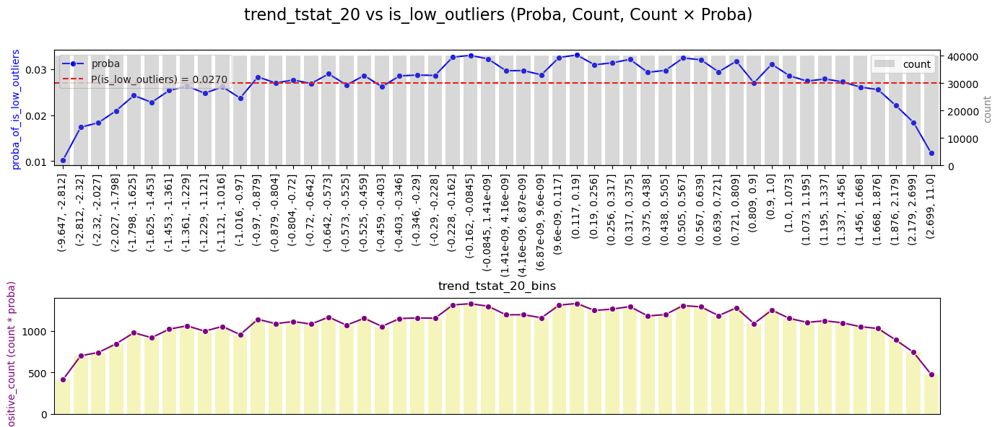

In [369]:
conditional_proba_plot(normal_rolling_df, feature='trend_tstat_20', target='is_low_outliers', bins=50)


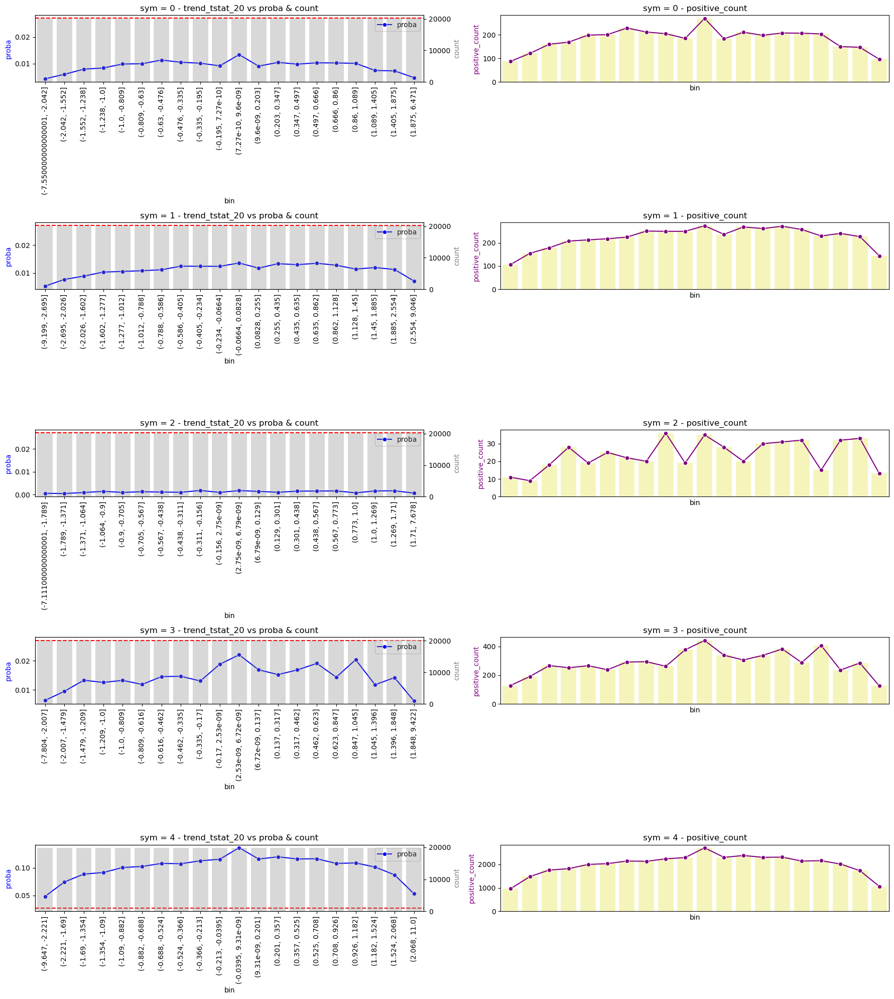

In [370]:
proba_plot_by_sym(normal_rolling_df, feature='trend_tstat_20', target='is_low_outliers', bins=20)

In [ ]:
# 我们发现这个图中价高两边低的特征与mid_price和mid_diff十分相似
# 这同样证明趋势不明显时成交量低的概率比较高
# 但是我们仍然不知道是长期缓慢下跌成交量低时的变化(因为分子均值小,分母标准差也小)
# 所以搭配累计涨跌幅mid_diff_sum看一下

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\2938525997.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['bin'] = pd.qcut(df_copy['feature_with_noise'], q=bins, duplicates='raise')


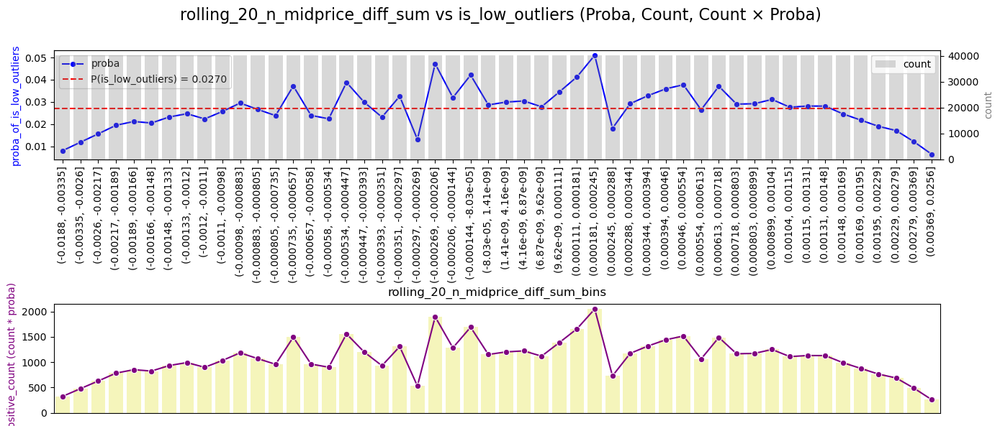

In [371]:
conditional_proba_plot(normal_rolling_df, feature='rolling_20_n_midprice_diff_sum', target='is_low_outliers', bins=50)

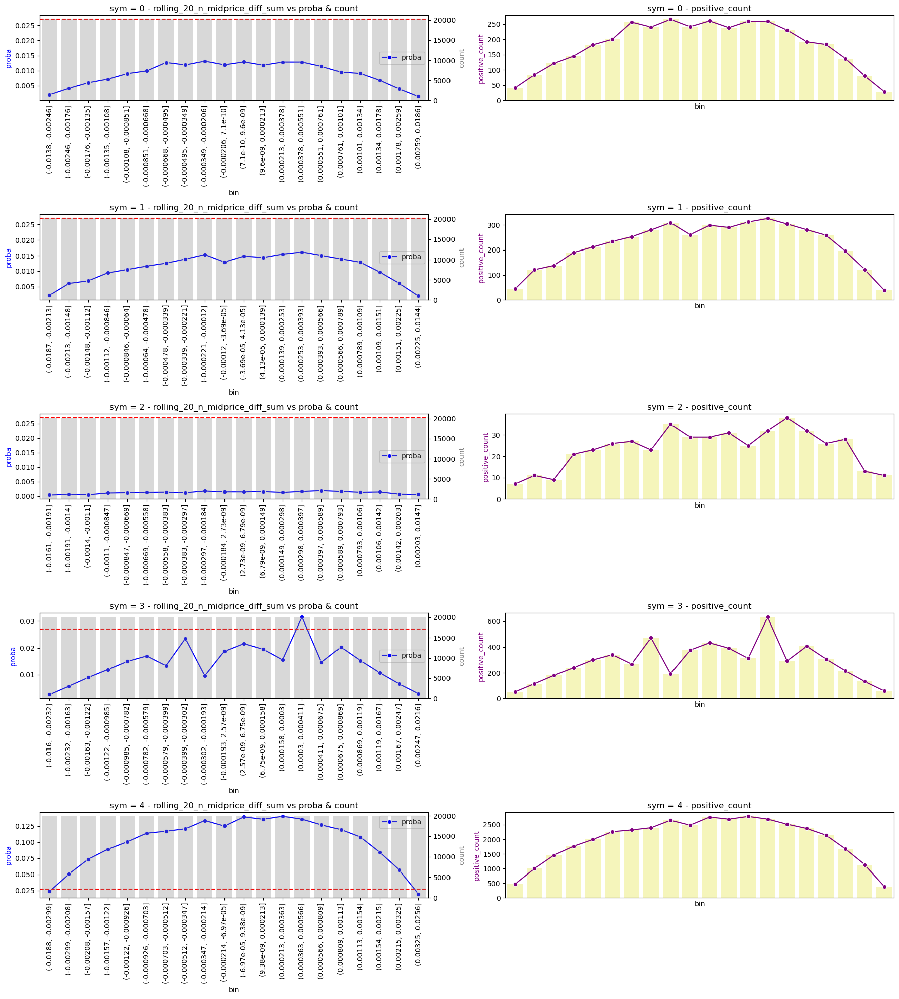

In [372]:
proba_plot_by_sym(normal_rolling_df, feature='rolling_20_n_midprice_diff_sum', target='is_low_outliers', bins=20)

In [ ]:
# 看着好像差不多,但是如果跟t_stat趋势指标一起放到lightGBM搭配着可能有奇效
# 初步的过滤式识别特征无法可视化处置效应,猜想2先搁置

In [ ]:
# 总结一下几个相似的指标
# 1.n_midprice: 待预测趋势的核心
# 2.n_mid_price_diff:这个几乎就是趋势指标(只是没有映射到0/1/2)
# 3.rolling_{window}_n_midprice_sum:累计涨跌幅变化率
# 4.t_stat:趋势指标,量化趋势的明显程度

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\2938525997.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['bin'] = pd.qcut(df_copy['feature_with_noise'], q=bins, duplicates='raise')


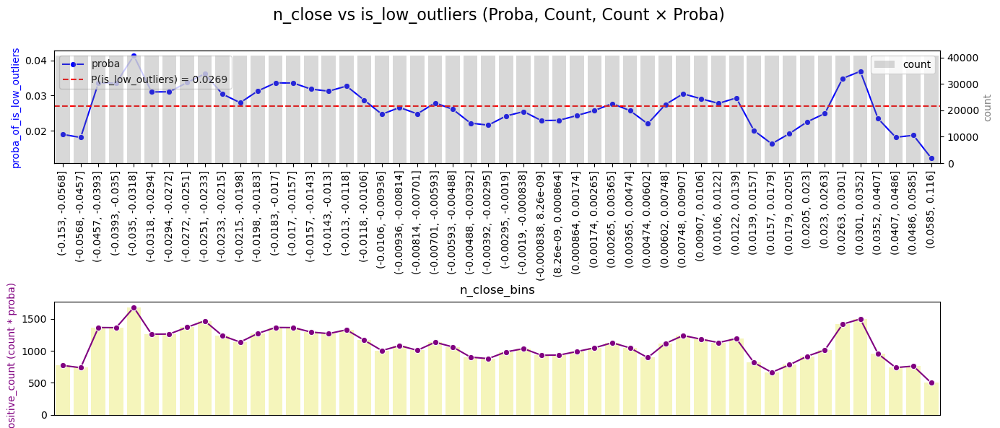

In [373]:
conditional_proba_plot(normal_df, feature='n_close', target='is_low_outliers', bins=50)

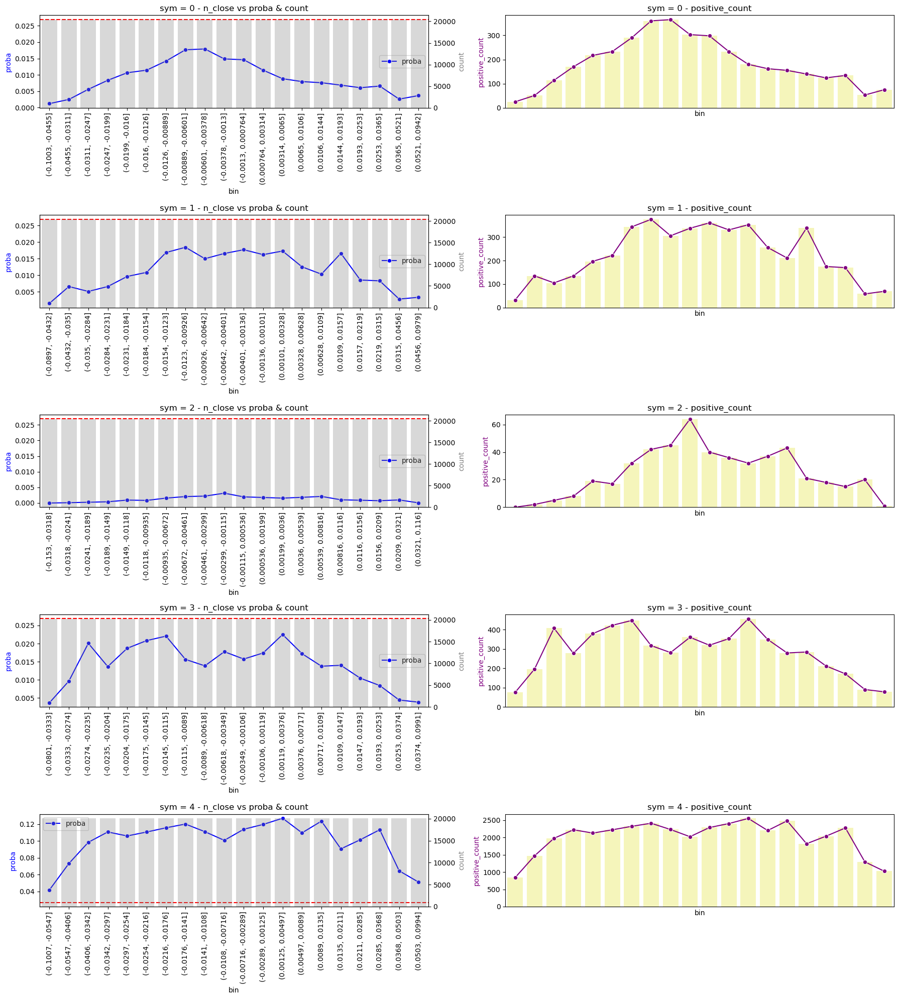

In [375]:
proba_plot_by_sym(normal_df, feature='n_close', target='is_low_outliers', bins=20)

In [ ]:
# n_close最新成交价也差不多
# 至于asizebsize这类指标以及衍生构造的指标基本思路都一样
# 用conditional_proba看看就行
# 接下来我们看看成交量异常大的情况

In [ ]:
df[i]
amount_not_0=df[df['is_amount_0']==0]
μ=amount_not_0['amount'].mean()
σ=amount_not_0['amount'].std()
threshold=μ+3*σ

KeyError: 'is_amount_0'

In [381]:
normal_df['is_high_outliers']=(normal_df['amount']>threshold).astype(int)

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\1380526180.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  normal_df['is_high_outliers']=(normal_df['amount']>threshold).astype(int)


In [383]:
normal_df[normal_df['is_high_outliers']==1].describe()

,date,sym,n_close,n_open,n_high,n_low,amount_delta,n_midprice,n_bid1,n_bsize1,n_bid2,n_bsize2,n_bid3,n_bsize3,n_bid4,n_bsize4,n_bid5,n_bsize5,n_ask1,n_asize1,n_ask2,n_asize2,n_ask3,n_asize3,n_ask4,n_asize4,n_ask5,n_asize5,label_5,label_10,label_20,label_40,label_60,spread1,spread2,spread3,spread4,spread5,amount,is_amount_0,abnormal,is_low_outliers,is_down,is_high_outliers
count,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1.020000e+03,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.0,1020.0,1020.0,1020.000000,1020.0
mean,38.559804,1.404902,0.004178,0.002955,0.021362,-0.015334,3.241002e+07,0.004164,0.003943,0.133087,0.003678,0.093200,0.003454,0.091047,0.003254,0.084307,0.003059,0.069133,0.004386,0.245384,0.004661,0.120465,0.004882,0.082696,0.005093,0.105107,0.005291,0.092549,1.079412,1.087255,1.089216,1.036275,1.016667,0.000443,0.000983,0.001429,0.001839,0.002232,17.207202,0.0,0.0,0.0,0.467647,1.0
std,29.064332,0.794841,0.041244,0.017100,0.025879,0.028199,1.823321e+07,0.041242,0.041240,0.367871,0.041222,0.308958,0.041208,0.324587,0.041194,0.304714,0.041179,0.232343,0.041247,0.749990,0.041205,0.402778,0.041200,0.187270,0.041185,0.280598,0.041183,0.274874,0.803921,0.857476,0.807765,0.846199,0.868552,0.000540,0.000880,0.001100,0.001306,0.001504,0.371768,0.0,0.0,0.0,0.499197,0.0
min,0.000000,0.000000,-0.149070,-0.032891,-0.026133,-0.149070,2.011994e+07,-0.148913,-0.149070,0.000120,-0.149385,0.000120,-0.149701,0.000131,-0.150016,0.000131,-0.150331,0.000131,-0.148755,0.000120,-0.148440,0.000131,-0.148125,0.000111,-0.147810,0.000263,-0.147494,0.000131,0.000000,0.000000,0.000000,0.000000,0.000000,0.000031,0.000092,0.000161,0.000231,0.000297,16.817222,0.0,0.0,0.0,0.000000,1.0
25%,13.750000,1.000000,-0.023520,-0.005861,0.002722,-0.027292,2.277246e+07,-0.023757,-0.023992,0.003696,-0.024544,0.003696,-0.024782,0.004928,-0.024872,0.004656,-0.025018,0.003789,-0.023484,0.004928,-0.023330,0.004802,-0.023289,0.004928,-0.023146,0.004928,-0.022901,0.004928,0.000000,0.000000,0.000000,0.000000,0.000000,0.000119,0.000354,0.000554,0.000706,0.000873,16.941063,0.0,0.0,0.0,0.000000,1.0
50%,31.000000,1.000000,0.004855,0.000000,0.014990,-0.012975,2.650877e+07,0.004740,0.004491,0.014784,0.004369,0.013915,0.004037,0.018480,0.003834,0.016436,0.003601,0.017248,0.004950,0.023086,0.005330,0.018768,0.005560,0.020944,0.005751,0.020944,0.005798,0.019858,1.000000,1.000000,1.000000,1.000000,1.000000,0.000287,0.000851,0.001366,0.001851,0.002327,17.092986,0.0,0.0,0.0,0.000000,1.0
75%,63.250000,2.000000,0.039401,0.010064,0.042068,0.000159,3.461306e+07,0.039122,0.038858,0.069107,0.038297,0.056751,0.038046,0.062904,0.037832,0.061610,0.037577,0.065295,0.039377,0.115586,0.039646,0.074790,0.040046,0.079558,0.040217,0.088815,0.040408,0.078825,2.000000,2.000000,2.000000,2.000000,2.000000,0.000554,0.001230,0.001916,0.002582,0.003152,17.359742,0.0,0.0,0.0,1.000000,1.0
max,101.000000,4.000000,0.098555,0.096532,0.100000,0.067341,2.484736e+08,0.098774,0.098555,4.191227,0.098117,3.626799,0.097678,5.407200,0.097354,5.326373,0.097090,5.460704,0.098993,11.496423,0.099431,7.489105,0.099869,2.670222,0.100307,4.148551,0.100745,4.915636,2.000000,2.000000,2.000000,2.000000,2.000000,0.005166,0.010362,0.012724,0.013180,0.013387,19.330847,0.0,0.0,0.0,1.000000,1.0


In [386]:
# 1.与时间相关?
def time_feature(df, name="time"):
    """
    time归一化与周期性编码
    周期性编码可能需要细化调整
    """
    t = pd.to_datetime(df[name], format='%H:%M:%S')
    hours = t.dt.hour
    minutes = t.dt.minute
    seconds = t.dt.second
    df['time_frac'] = (hours * 3600 + minutes * 60 + seconds) / 86400.0

    df['sin_time'] = np.sin(2 * np.pi * df['time_frac'])
    df['cos_time'] = np.cos(2 * np.pi * df['time_frac'])
    return df, ["sin_time", "cos_time", "time_frac"]
am_normal_df, _=time_feature(normal_df[normal_df['time_period']=='AM'])
pm_normal_df, _=time_feature(normal_df[normal_df['time_period']=='PM'])

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\2920232138.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['time_frac'] = (hours * 3600 + minutes * 60 + seconds) / 86400.0
C:\Users\15853\AppData\Local\Temp\ipykernel_18348\2920232138.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['sin_time'] = np.sin(2 * np.pi * df['time_frac'])
C:\Users\15853\AppData\Local\Temp\ipykernel_18348\2920232138.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\2938525997.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['bin'] = pd.qcut(df_copy['feature_with_noise'], q=bins, duplicates='raise')


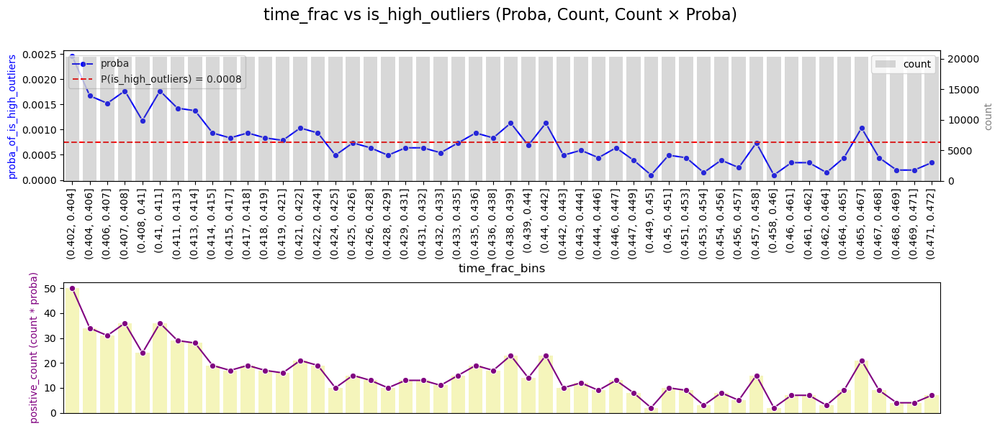

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\2938525997.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['bin'] = pd.qcut(df_copy['feature_with_noise'], q=bins, duplicates='raise')


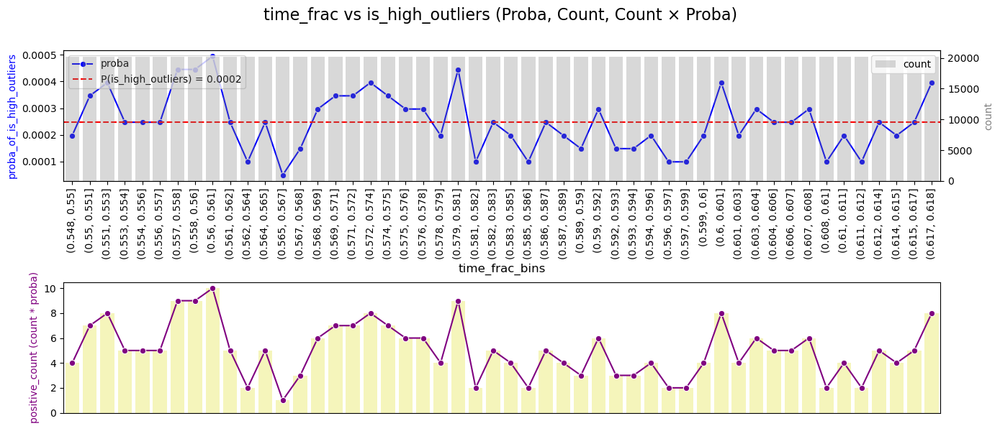

In [387]:
conditional_proba_plot(am_normal_df, feature='time_frac', target='is_high_outliers', bins=50)
conditional_proba_plot(pm_normal_df, feature='time_frac', target='is_high_outliers', bins=50)

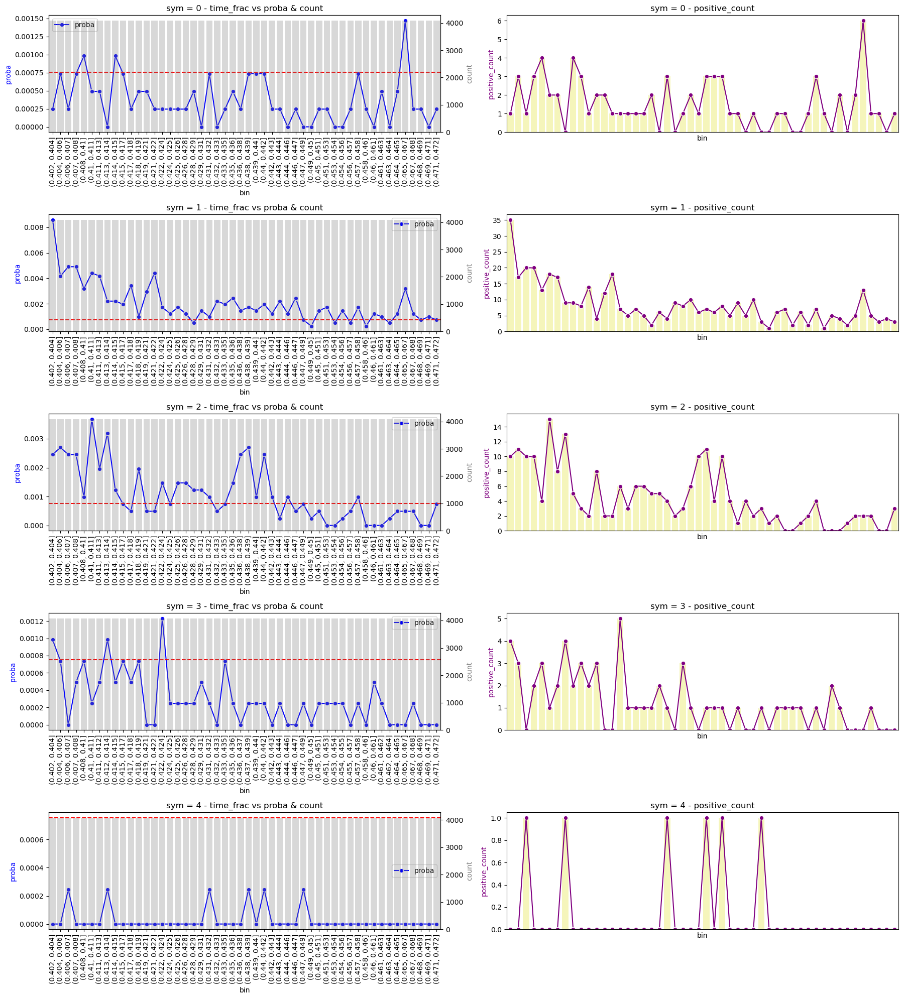

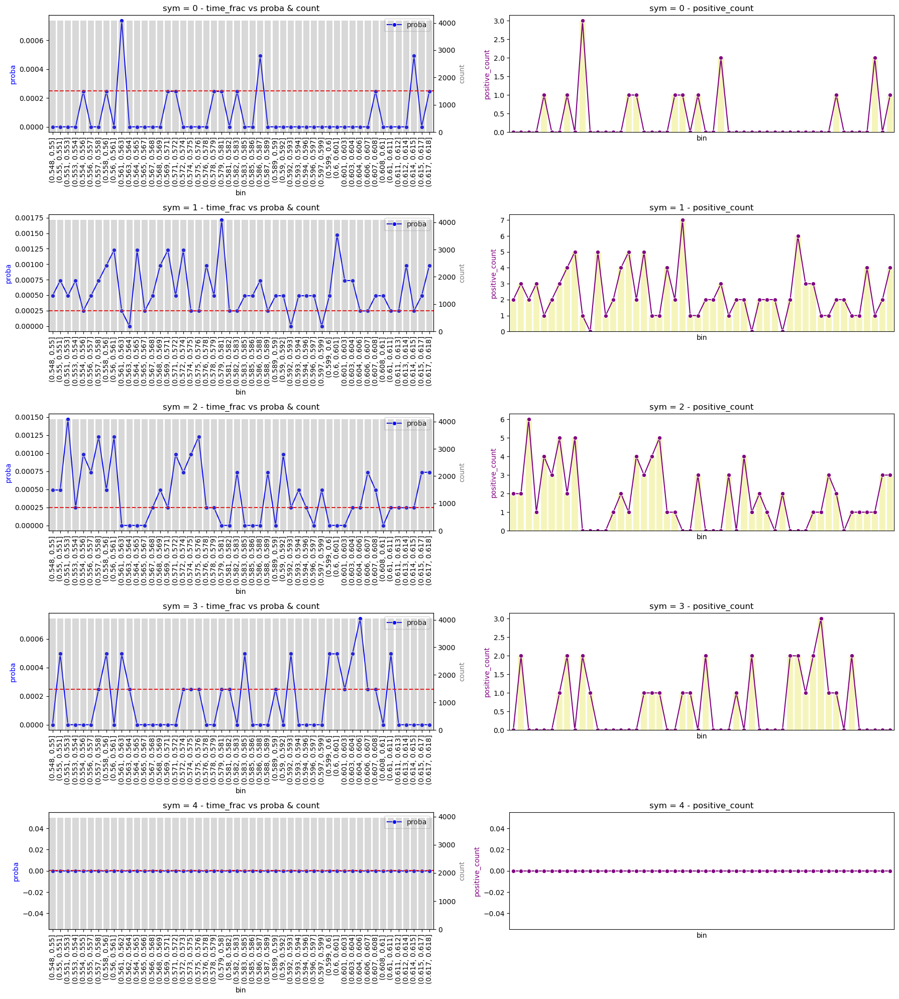

In [388]:
proba_plot_by_sym(am_normal_df, feature='time_frac', target='is_high_outliers', bins=50)
proba_plot_by_sym(pm_normal_df, feature='time_frac', target='is_high_outliers', bins=50)

In [ ]:
# 这里发现去掉涨停/跌停/过渡部分会导致间断,影响判断
# 因此这里加上上面的部分进行分析

In [390]:
df['is_high_outliers']=(df['amount']>threshold).astype(int)
df[df['is_high_outliers']==1].describe()


,date,sym,n_close,n_open,n_high,n_low,amount_delta,n_midprice,n_bid1,n_bsize1,n_bid2,n_bsize2,n_bid3,n_bsize3,n_bid4,n_bsize4,n_bid5,n_bsize5,n_ask1,n_asize1,n_ask2,n_asize2,n_ask3,n_asize3,n_ask4,n_asize4,n_ask5,n_asize5,label_5,label_10,label_20,label_40,label_60,spread1,spread2,spread3,spread4,spread5,amount,is_amount_0,abnormal,is_high_outliers
count,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1.059000e+03,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.000000,1059.0,1059.000000,1059.0
mean,38.455146,1.462701,0.006754,0.005423,0.023841,-0.013531,3.304800e+07,0.006740,0.006613,1.441946,0.006629,0.107345,0.006495,0.089956,0.006293,0.084526,0.006097,0.068291,0.005074,0.377595,0.004396,0.133283,0.004422,0.086279,0.004532,0.134647,0.004629,0.090186,1.072710,1.079320,1.084986,1.025496,1.008499,-0.001539,-0.002233,-0.002073,-0.001762,-0.001468,17.213845,0.0,0.036827,1.0
std,28.795390,0.853812,0.044454,0.022563,0.028960,0.031295,2.223543e+07,0.044453,0.044327,13.603363,0.043939,0.351327,0.043794,0.320041,0.043776,0.302202,0.043755,0.228568,0.042549,1.945966,0.041490,0.563950,0.041276,0.224254,0.041158,1.038109,0.041053,0.270768,0.795427,0.848293,0.798363,0.841005,0.861333,0.014024,0.017719,0.018454,0.018728,0.018989,0.387376,0.0,0.188426,0.0
min,0.000000,0.000000,-0.149070,-0.032891,-0.026133,-0.149070,2.011994e+07,-0.148913,-0.149070,0.000000,-0.149385,0.000000,-0.149701,0.000000,-0.150016,0.000000,-0.150331,0.000000,-0.148755,0.000000,-0.148440,0.000000,-0.148125,0.000000,-0.147810,0.000000,-0.147494,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.100101,-0.099849,-0.099701,-0.099558,-0.099416,16.817222,0.0,0.000000,1.0
25%,14.000000,1.000000,-0.023373,-0.005728,0.002927,-0.026707,2.278745e+07,-0.023196,-0.023400,0.003696,-0.023464,0.003696,-0.023532,0.004928,-0.023731,0.004793,-0.024117,0.003874,-0.023015,0.004928,-0.022791,0.003696,-0.022738,0.004890,-0.022627,0.003696,-0.022493,0.004001,0.000000,0.000000,0.000000,0.000000,0.000000,0.000099,0.000320,0.000480,0.000625,0.000775,16.941721,0.0,0.000000,1.0
50%,30.000000,1.000000,0.006369,0.000159,0.015225,-0.012112,2.655636e+07,0.006732,0.006079,0.016016,0.005890,0.014784,0.005552,0.017248,0.005416,0.016808,0.005149,0.016582,0.004752,0.022176,0.003245,0.017248,0.003282,0.018515,0.003389,0.020091,0.003421,0.018480,1.000000,1.000000,1.000000,1.000000,1.000000,0.000286,0.000838,0.001318,0.001810,0.002210,17.094780,0.0,0.000000,1.0
75%,63.000000,2.000000,0.040926,0.012212,0.043046,0.002082,3.491830e+07,0.040961,0.040750,0.081895,0.040452,0.060089,0.040155,0.061599,0.039875,0.062831,0.039631,0.065295,0.039936,0.117125,0.038941,0.071221,0.038873,0.076781,0.038900,0.085799,0.039048,0.076050,2.000000,2.000000,2.000000,2.000000,2.000000,0.000541,0.001220,0.001897,0.002546,0.003112,17.368520,0.0,0.000000,1.0
max,101.000000,4.000000,0.100101,0.096532,0.100101,0.067341,3.309652e+08,0.100101,0.100101,208.711754,0.099849,3.626799,0.099422,5.407200,0.099133,5.326373,0.098871,5.460704,0.100101,36.474509,0.100101,12.712331,0.100000,3.810757,0.100307,32.642638,0.100745,4.915636,2.000000,2.000000,2.000000,2.000000,2.000000,0.005322,0.010362,0.012724,0.013180,0.013387,19.617524,0.0,1.000000,1.0


In [391]:
# 1.与时间相关?
def time_feature(df, name="time"):
    """
    time归一化与周期性编码
    周期性编码可能需要细化调整
    """
    t = pd.to_datetime(df[name], format='%H:%M:%S')
    hours = t.dt.hour
    minutes = t.dt.minute
    seconds = t.dt.second
    df['time_frac'] = (hours * 3600 + minutes * 60 + seconds) / 86400.0

    df['sin_time'] = np.sin(2 * np.pi * df['time_frac'])
    df['cos_time'] = np.cos(2 * np.pi * df['time_frac'])
    return df, ["sin_time", "cos_time", "time_frac"]
am_df, _=time_feature(df[df['time_period']=='AM'])
pm_df, _=time_feature(df[df['time_period']=='PM'])

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\3654739722.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['time_frac'] = (hours * 3600 + minutes * 60 + seconds) / 86400.0
C:\Users\15853\AppData\Local\Temp\ipykernel_18348\3654739722.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['sin_time'] = np.sin(2 * np.pi * df['time_frac'])
C:\Users\15853\AppData\Local\Temp\ipykernel_18348\3654739722.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\2938525997.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['bin'] = pd.qcut(df_copy['feature_with_noise'], q=bins, duplicates='raise')


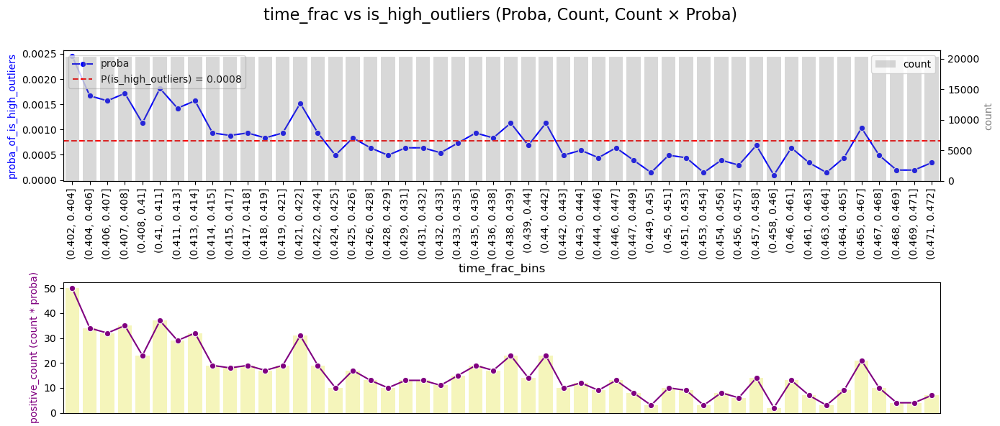

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\2938525997.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['bin'] = pd.qcut(df_copy['feature_with_noise'], q=bins, duplicates='raise')


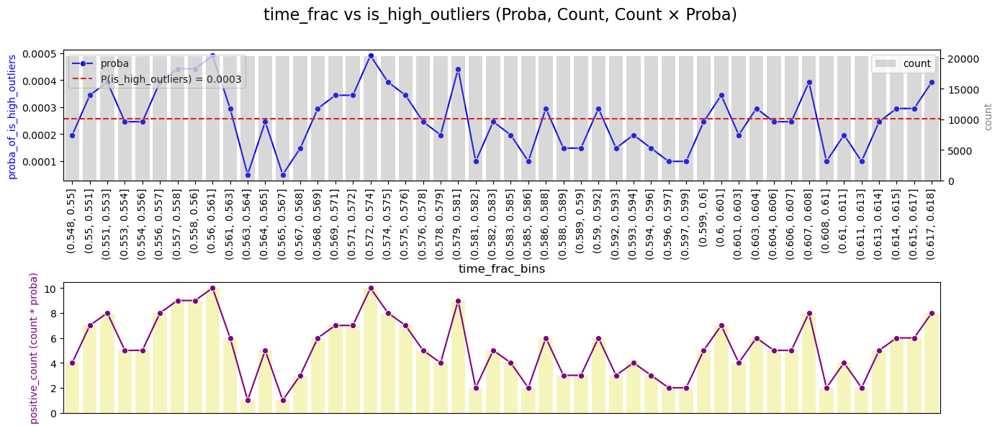

In [395]:
conditional_proba_plot(am_df, feature='time_frac', target='is_high_outliers', bins=50)
conditional_proba_plot(pm_df, feature='time_frac', target='is_high_outliers', bins=50)

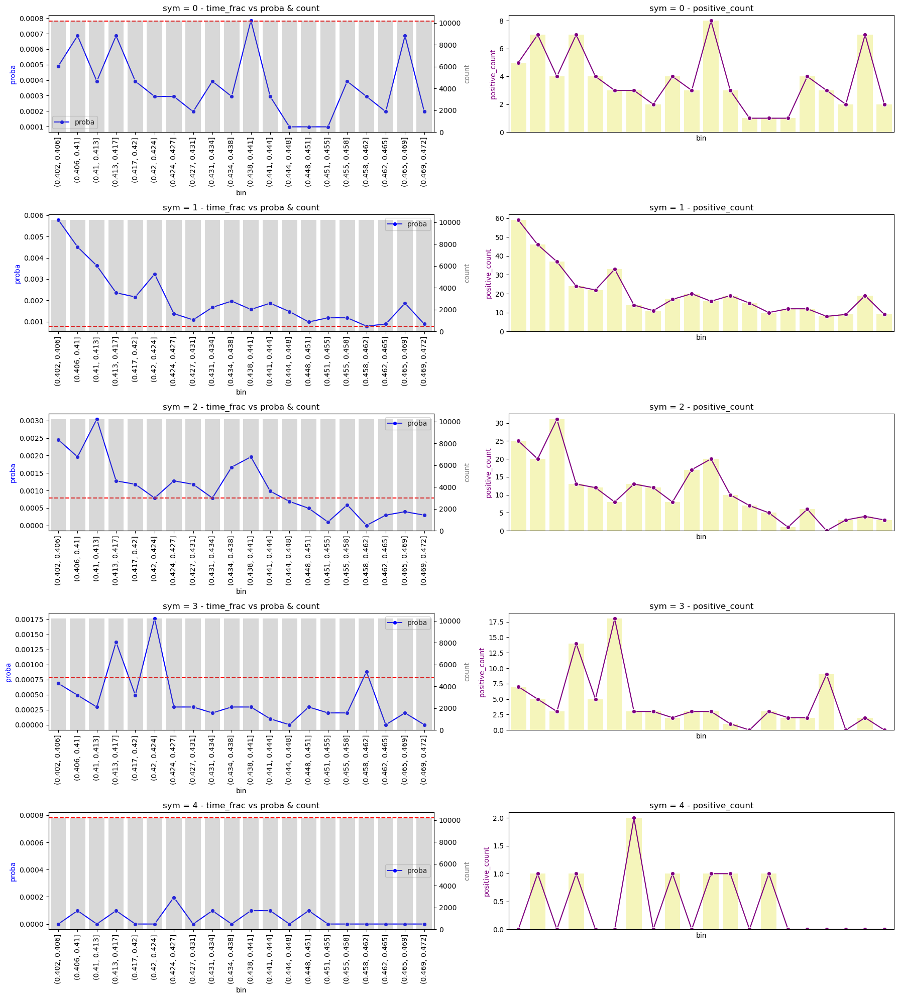

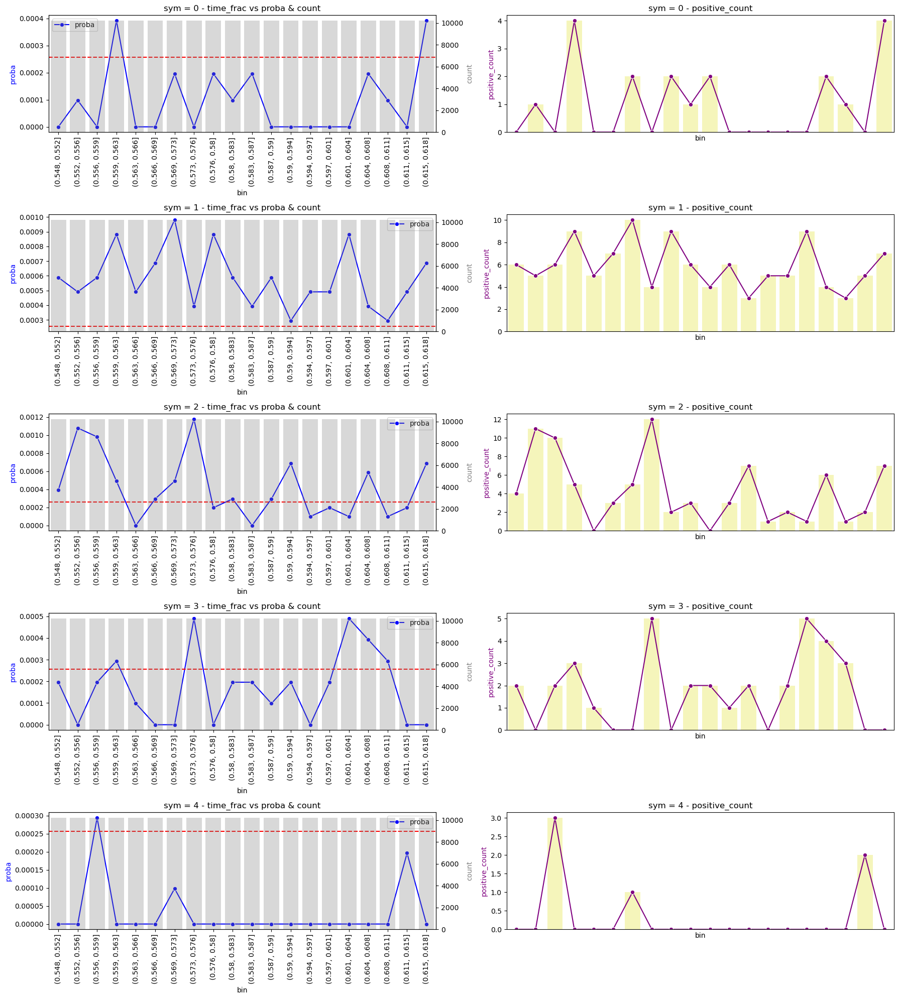

In [396]:
proba_plot_by_sym(am_df, feature='time_frac', target='is_high_outliers', bins=20)
proba_plot_by_sym(pm_df, feature='time_frac', target='is_high_outliers', bins=20)

In [ ]:
# 感觉好像没啥区别,反正图很奇怪,sym=4尤为奇葩
# 大体上是开盘收盘附近成交量大的概率要大一些,与成交量低的规律相反
# sin_time和cos_time估计类似,这里掠过

In [ ]:
# 2. 盘口特征分析（n_bsize1, n_asize1 等）
# 大成交是否发生在挂单失衡或挂单突变时？
# 是否存在主动大单冲击盘口（冲击式交易）?

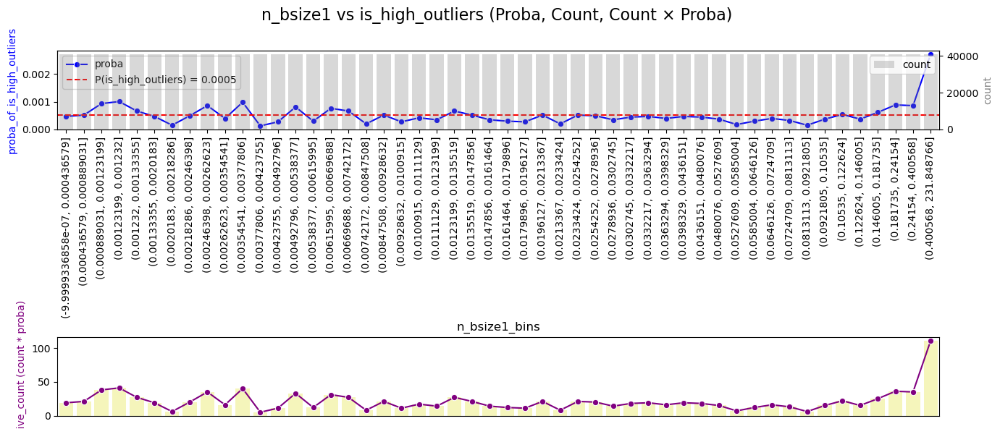

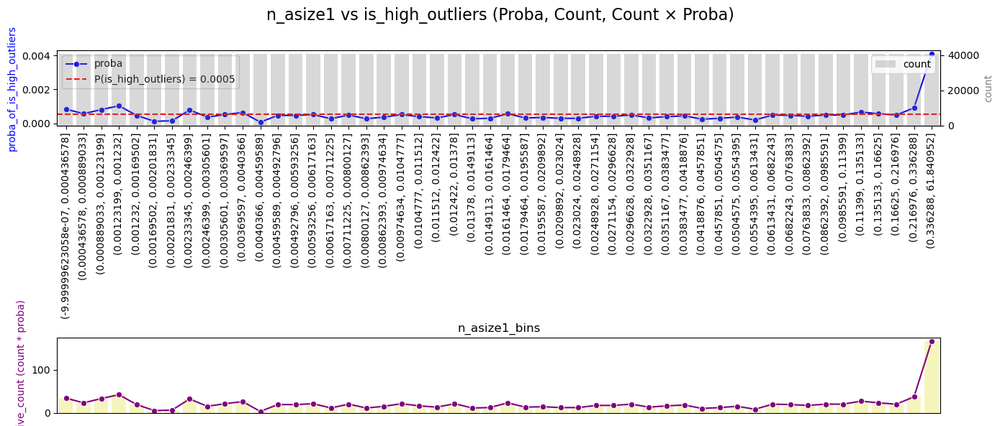

In [399]:
conditional_proba_plot(df, feature='n_bsize1', target='is_high_outliers', bins=50)
conditional_proba_plot(df, feature='n_asize1', target='is_high_outliers', bins=50)

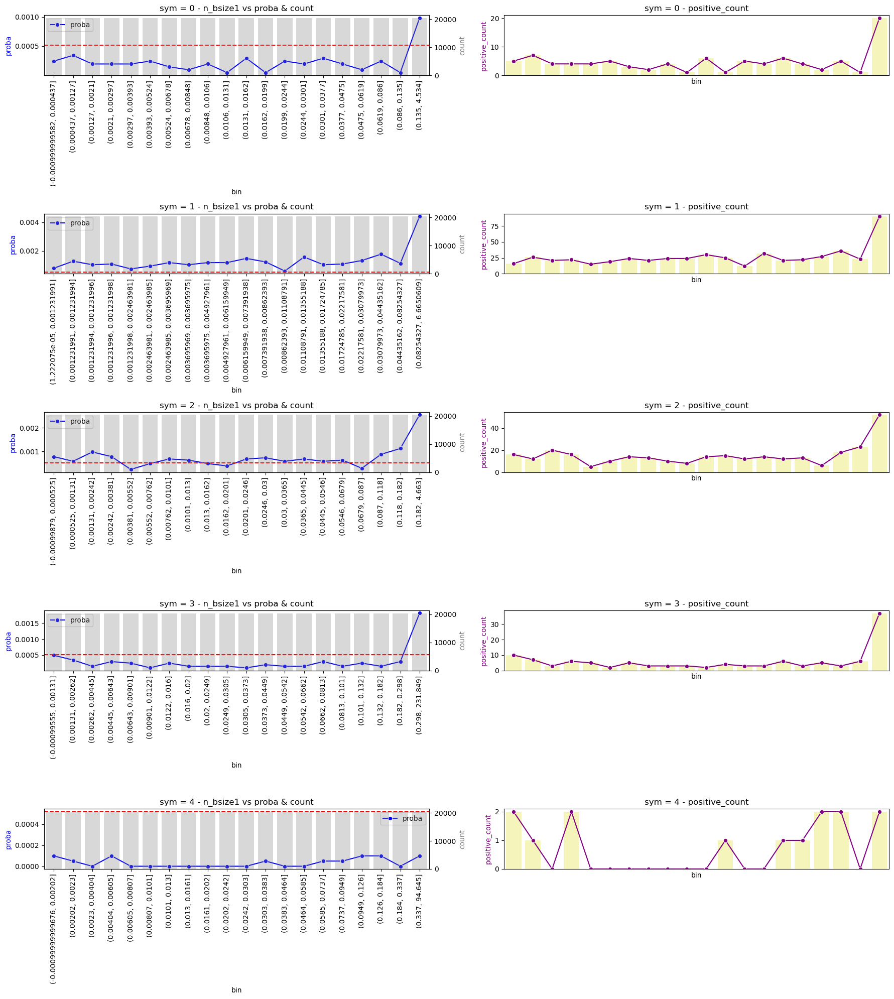

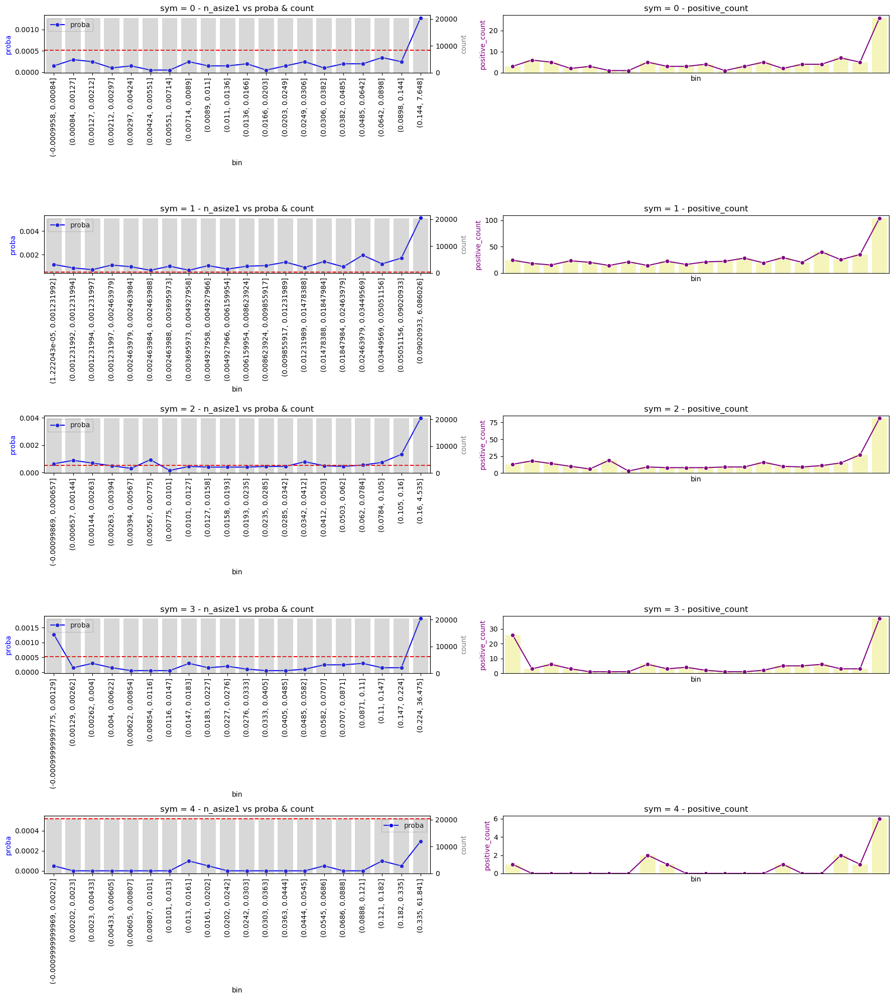

In [402]:
proba_plot_by_sym(df, feature='n_bsize1', target='is_high_outliers', bins=20)
proba_plot_by_sym(df, feature='n_asize1', target='is_high_outliers', bins=20)

In [ ]:
# 非常明显的大单冲击,但是sym=4为什么在换手率很低的时候突变?
# 原来只有一两个,这个可以忽略还是有特殊讲究?
# (买卖盘稀薄导致容易发生价格跳升?还是有人想抄底结果被套牢了?)

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\2938525997.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['bin'] = pd.qcut(df_copy['feature_with_noise'], q=bins, duplicates='raise')


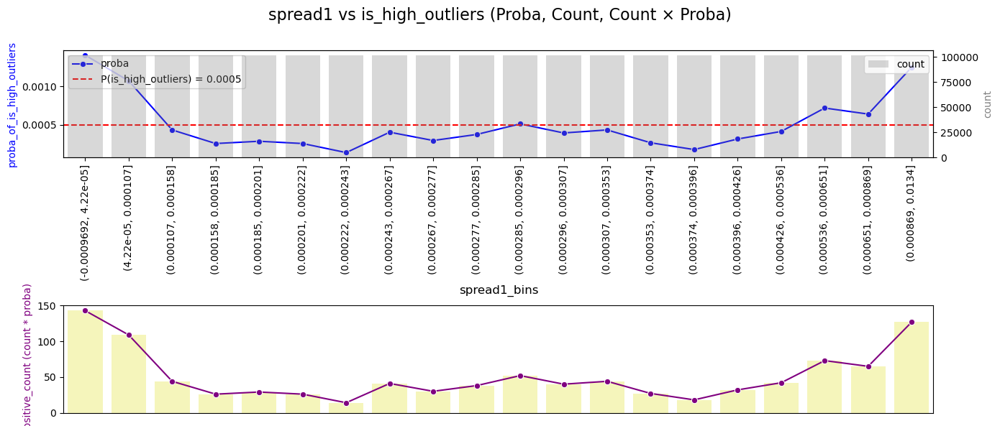

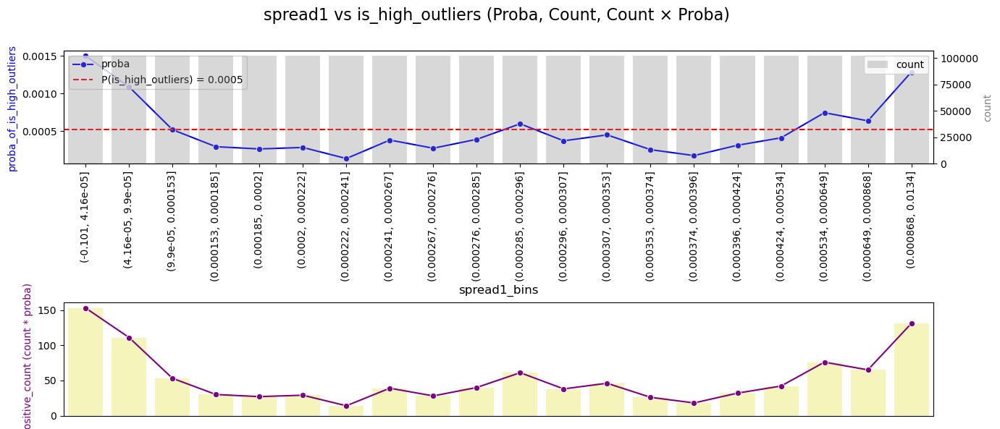

In [406]:
# 3.价差spead1
conditional_proba_plot(normal_df, feature='spread1', target='is_high_outliers', bins=20)
conditional_proba_plot(df, feature='spread1', target='is_high_outliers', bins=20)

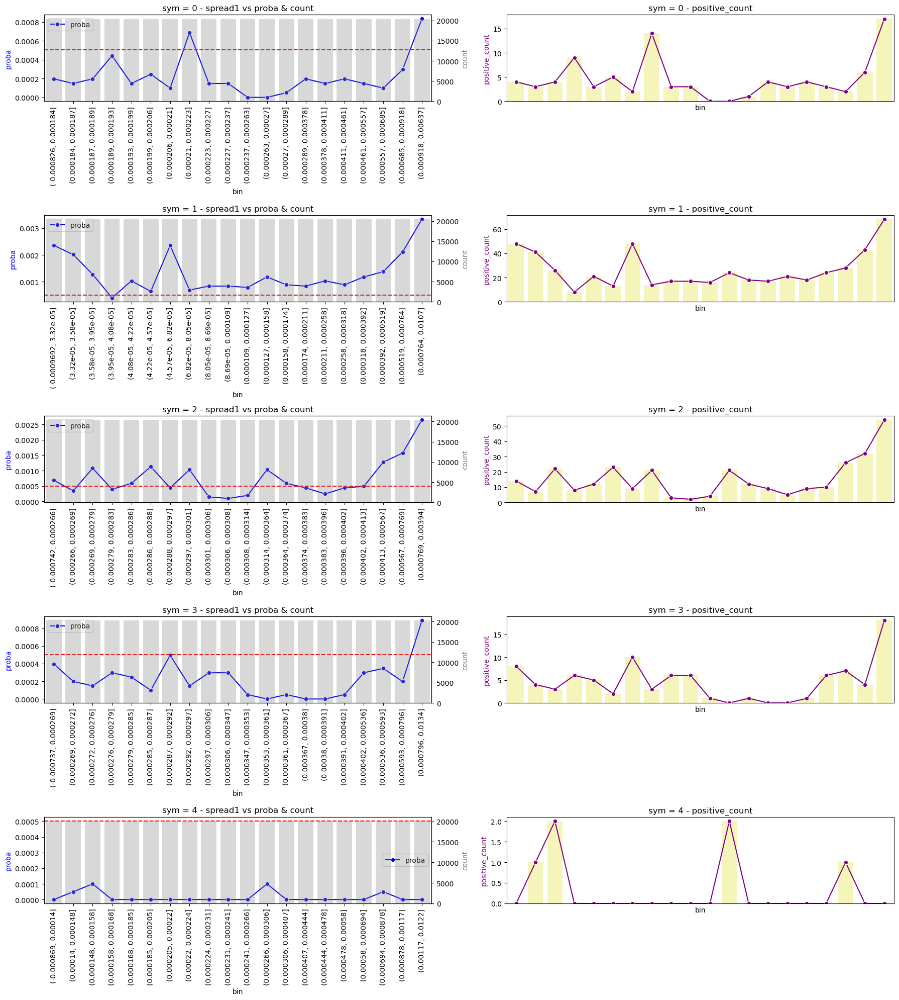

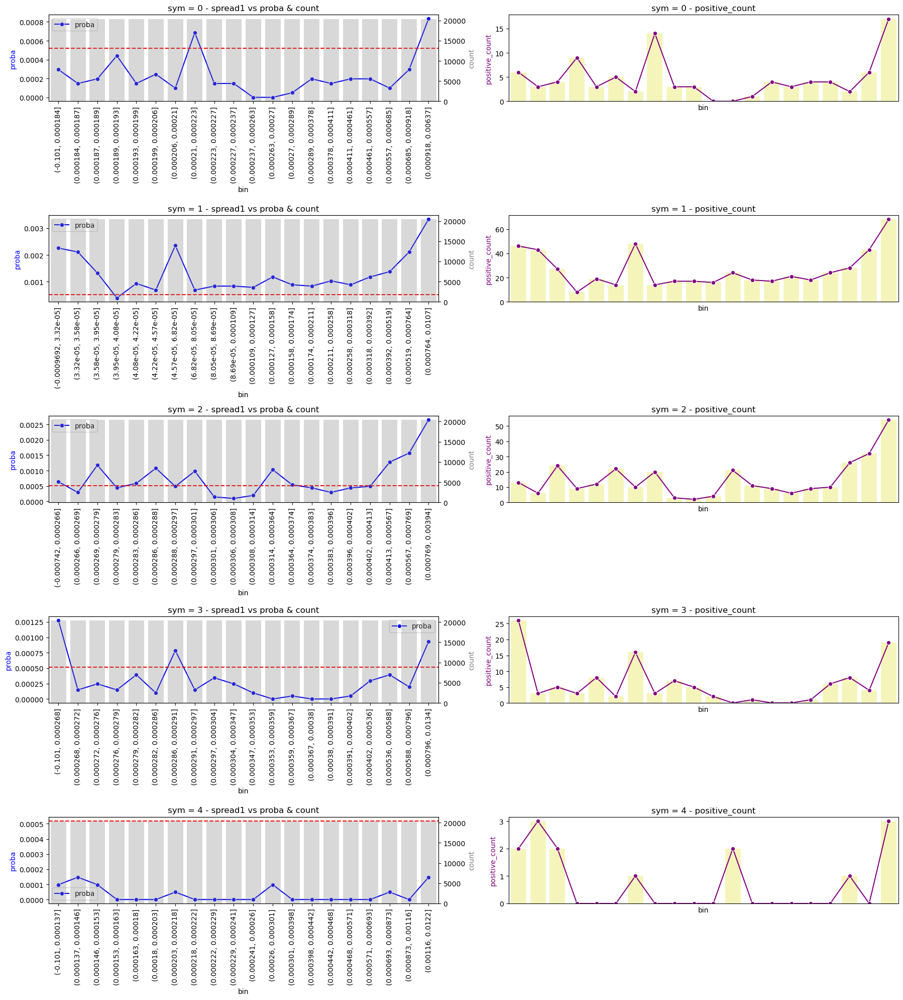

In [ ]:
proba_plot_by_sym(normal_df, feature='spread1', target='is_high_outliers', bins=20)
proba_plot_by_sym(df, feature='spread1', target='is_high_outliers', bins=20)

In [ ]:
# 注意:这里是等频分箱,中间大但是可能右拖尾,按照等距分箱说不定也在左边
# 这里图大多为中间低两头高（U形曲线）
# 左侧低 spread、高成交量：流动性好，交易热
# 表明市场处于高度关注状态；
# 买卖盘非常活跃，成交效率高；
# 或者主力在低滑点环境下分批入场/出货。

In [ ]:
# 一档价差大的时候成交量高的概率比较大
# 说明在流动性差的情况下仍然发生了大量成交
# 可能意味着主力意图强、行情即将启动

In [ ]:
# 考虑到价差大的时候amount=0的概率也要高一些
# 因此适用amount×spread的组合特征

In [ ]:
# GPT建议组合特征,增加乘性交互项
# 适合用在像 LightGBM、XGBoost 这种能自动捕捉非线性的模型,看看有没有增益。
# 特征	含义
# spread × amount	冲击强度
# spread × amount × imbalance	冲击+方向一致性
# spread × order_book_imbalance	异常冲击是否顺势

In [410]:
df

,date,time,sym,n_close,n_open,n_high,n_low,amount_delta,n_midprice,n_bid1,n_bsize1,n_bid2,n_bsize2,n_bid3,n_bsize3,n_bid4,n_bsize4,n_bid5,n_bsize5,n_ask1,n_asize1,n_ask2,n_asize2,n_ask3,n_asize3,n_ask4,n_asize4,n_ask5,n_asize5,label_5,label_10,label_20,label_40,label_60,time_period,spread1,spread2,spread3,spread4,spread5,amount,is_amount_0,abnormal,is_high_outliers,bin,impact
0,0,09:40:03,0,-0.005000,-0.005000,0.006522,-0.013913,938523.0,-0.004783,-0.005000,0.002619,-0.005217,0.027067,-0.005435,0.088187,-0.005652,0.079893,-0.005870,0.065922,-0.004565,0.024011,-0.004130,0.003929,-0.003913,0.002619,-0.003478,0.007422,-0.003261,0.003929,0.0,0.0,0.0,0.0,0.0,AM,0.000435,0.001087,0.001522,0.002174,0.002609,13.752064,0,0,0,"(0.00597, 0.00658]",0.005979
1,0,09:40:06,0,-0.004348,-0.005000,0.006522,-0.013913,503741.0,-0.004130,-0.004348,0.004802,-0.004783,0.010478,-0.005000,0.017463,-0.005217,0.033179,-0.005435,0.098229,-0.003913,0.002183,-0.003696,0.008731,-0.003478,0.007422,-0.003261,0.003929,-0.003043,0.008731,0.0,0.0,0.0,0.0,0.0,AM,0.000435,0.001087,0.001522,0.001957,0.002391,13.129820,0,0,0,"(0.00559, 0.00597]",0.005709
2,0,09:40:09,0,-0.005652,-0.005000,0.006522,-0.013913,3070536.0,-0.005652,-0.005870,0.053262,-0.006087,0.047150,-0.006304,0.002183,-0.006522,0.040165,-0.006739,0.018773,-0.005435,0.013970,-0.005000,0.001746,-0.004565,0.003929,-0.004348,0.004366,-0.004130,0.021392,0.0,0.0,0.0,0.0,0.0,AM,0.000435,0.001087,0.001739,0.002174,0.002609,14.937363,0,0,0,"(0.00597, 0.00658]",0.006495
3,0,09:40:12,0,-0.006087,-0.005000,0.006522,-0.013913,1989469.0,-0.006196,-0.006304,0.002183,-0.006522,0.040165,-0.006739,0.018773,-0.006957,0.030560,-0.007174,0.011351,-0.006087,0.004366,-0.005652,0.001310,-0.005435,0.018773,-0.005000,0.002183,-0.004783,0.029687,0.0,0.0,0.0,0.0,0.0,AM,0.000217,0.000870,0.001304,0.001957,0.002391,14.503379,0,0,0,"(0.00306, 0.00317]",0.003153
4,0,09:40:15,0,-0.006739,-0.005000,0.006522,-0.013913,1824050.0,-0.006848,-0.006957,0.030560,-0.007174,0.011351,-0.007391,0.038855,-0.007609,0.041911,-0.007826,0.007422,-0.006739,0.000437,-0.006522,0.039728,-0.005870,0.010478,-0.005652,0.010478,-0.005435,0.022265,0.0,0.0,0.0,0.0,0.0,AM,0.000217,0.000652,0.001522,0.001957,0.002391,14.416570,0,0,0,"(0.00306, 0.00317]",0.003134
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2038975,9,14:49:45,4,-0.020196,0.009617,0.020035,-0.021638,85563.0,-0.020115,-0.020196,0.078282,-0.020516,0.029931,-0.020676,0.004605,-0.020837,0.013814,-0.020997,0.101306,-0.020035,0.023024,-0.019875,0.036838,-0.019715,0.013814,-0.019394,0.041443,-0.019234,0.025326,1.0,0.0,1.0,1.0,1.0,PM,0.000160,0.000641,0.000962,0.001443,0.001763,11.357020,0,0,0,"(0.00167, 0.00184]",0.001820
2038976,9,14:49:48,4,-0.020196,0.009617,0.020035,-0.021638,91695.0,-0.020115,-0.020196,0.057560,-0.020356,0.006907,-0.020516,0.050653,-0.020676,0.006907,-0.020837,0.013814,-0.020035,0.043746,-0.019875,0.036838,-0.019715,0.013814,-0.019394,0.041443,-0.019234,0.025326,1.0,1.0,1.0,1.0,1.0,PM,0.000160,0.000481,0.000801,0.001282,0.001603,11.426234,0,0,0,"(0.00167, 0.00184]",0.001831
2038977,9,14:49:51,4,-0.020035,0.009617,0.020035,-0.021638,116148.0,-0.020115,-0.020196,0.052955,-0.020356,0.006907,-0.020516,0.020722,-0.020676,0.011512,-0.020837,0.013814,-0.020035,0.041443,-0.019875,0.036838,-0.019715,0.013814,-0.019394,0.041443,-0.019234,0.025326,1.0,1.0,1.0,1.0,1.0,PM,0.000160,0.000481,0.000801,0.001282,0.001603,11.662629,0,0,0,"(0.00184, 0.00199]",0.001869
2038978,9,14:49:54,4,-0.020196,0.009617,0.020035,-0.021638,421727.0,-0.020115,-0.020356,0.023024,-0.020516,0.002302,-0.020676,0.036838,-0.020837,0.013814,-0.020997,0.099003,-0.019875,0.036838,-0.019715,0.013814,-0.019394,0.041443,-0.019234,0.025326,-0.019074,0.080584,0.0,0.0,1.0,1.0,1.0,PM,0.000481,0.000801,0.001282,0.001603,0.001923,12.952116,0,0,0,"(0.00597, 0.00658]",0.006228


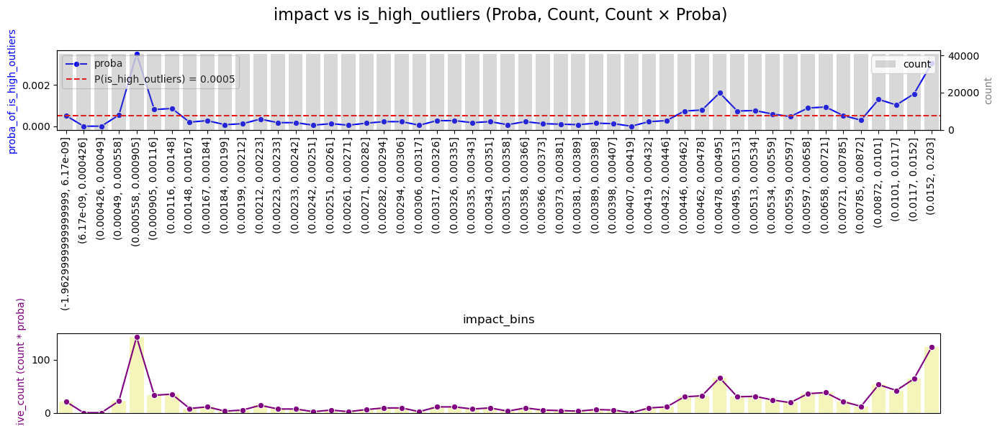

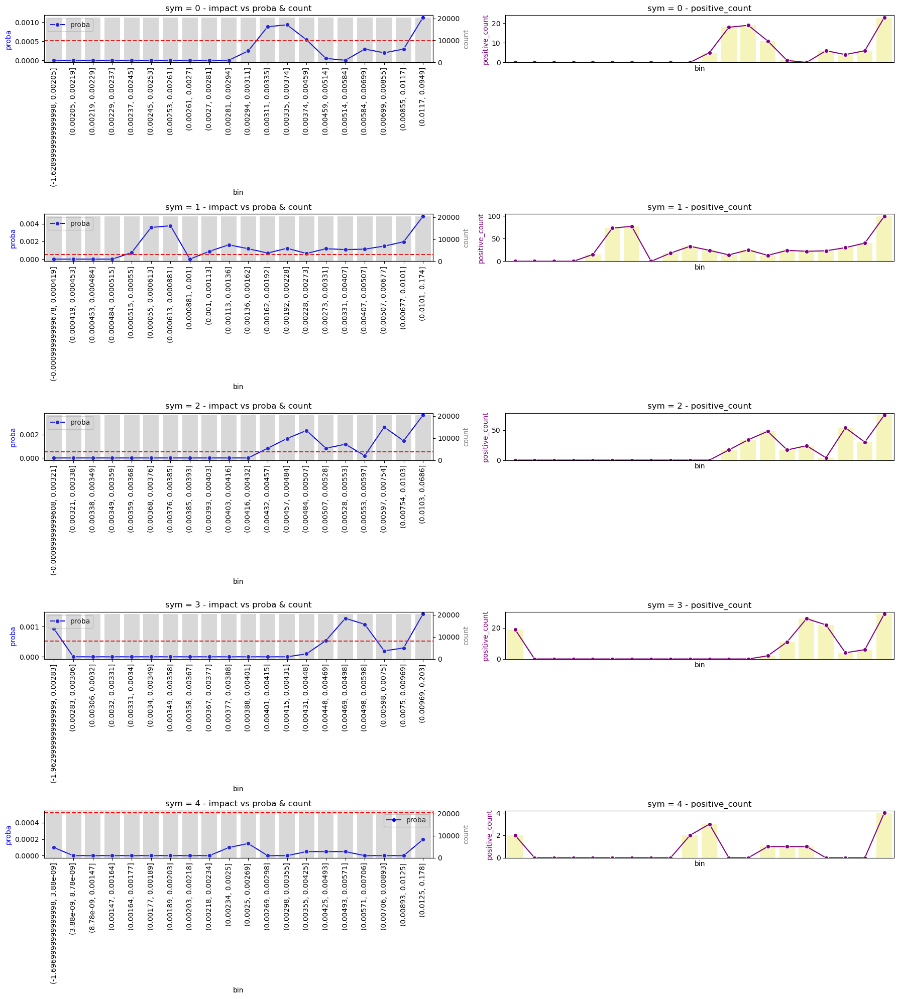

In [412]:
df['impact']=df['amount']*df['spread1']
conditional_proba_plot(df, feature='impact', target='is_high_outliers', bins=50)
proba_plot_by_sym(df, feature='impact', target='is_high_outliers', bins=20)

In [ ]:
# 好像看不出来啥东西,还是U形:中间低两头高
# 冲击强度低的时候成交量异常大的概率较高:高频主导型大单撮合，出现概率虽小，但如果出现，amount 异常大的概率较高。
# 冲击强度高的时候成交量异常大的概率较高:属于 低流动性高冲击 的场景，常见于盘中异常交易、机构出货或扫货。

In [3]:
def cut_proba_plot_by_sym(df, feature, target, bins=50):
    df = df.copy()
    fig, axes = plt.subplots(5, 2, figsize=(18, 20), sharex=False, sharey=False)
    
    # 也可以用df['sym'].unique()
    for i in range(5):
        df_sym = df[df['sym'] == i].copy()
        
        # 给特征列添加轻微的噪声
        eps = np.random.rand(len(df_sym)) * 1e-8  # 小幅度噪声
        df_sym['feature_with_noise'] = df_sym[feature] + eps
        df_sym['bin'] = pd.cut(df_sym['feature_with_noise'], bins=bins, duplicates='raise')

        prob = df_sym.groupby('bin', observed=True)[target].mean()
        count = df_sym.groupby('bin', observed=True)[target].count()
        positive = df_sym.groupby('bin', observed=True)[target].sum()

        summary = pd.DataFrame({
            'proba': prob,
            'count': count,
            'positive_count': positive
        })
        x_vals = summary.index.astype(str)
        
        ax1 = axes[i, 0]
        ax2 = ax1.twinx()

        sns.lineplot(x=x_vals, y=summary['proba'], color='blue', marker='o', label='proba', ax=ax1)
        sns.barplot(x=x_vals, y=summary['count'], color='gray', alpha=0.3, ax=ax2)
        
        # 总体is_amount_0概率
        p = df['target'].mean()

        # 添加水平虚线（is_amount_0的比例）
        ax1.axhline(p, color='red', linestyle='--', label=f'P(is_amount_0) = {p:.4f}')
        
        ax1.set_ylabel('proba', color='blue')
        ax2.set_ylabel('count', color='gray')
        ax1.set_title(f'sym = {i} - {feature} vs proba & count')
        ax1.tick_params(axis='x', rotation=90)

        ax3 = axes[i, 1]
        sns.lineplot(x=x_vals, y=summary['positive_count'], color='purple', marker='o', ax=ax3)
        sns.barplot(x=x_vals, y=summary['positive_count'], color='yellow', alpha=0.3, ax=ax3)

        ax3.set_ylabel('positive_count', color='purple')
        ax3.set_title(f'sym = {i} - positive_count')
        ax3.set_xticks([])  # 不显示副图的x轴刻度

    plt.tight_layout()
    plt.show()


In [4]:
df

,date,time,sym,n_close,n_open,n_high,n_low,amount_delta,n_midprice,n_bid1,...,n_ask4,n_asize4,n_ask5,n_asize5,label_5,label_10,label_20,label_40,label_60,time_period
0,0,09:40:03,0,-0.005000,-0.005000,0.006522,-0.013913,938523.0,-0.004783,-0.005000,...,-0.003478,0.007422,-0.003261,0.003929,0.0,0.0,0.0,0.0,0.0,AM
1,0,09:40:06,0,-0.004348,-0.005000,0.006522,-0.013913,503741.0,-0.004130,-0.004348,...,-0.003261,0.003929,-0.003043,0.008731,0.0,0.0,0.0,0.0,0.0,AM
2,0,09:40:09,0,-0.005652,-0.005000,0.006522,-0.013913,3070536.0,-0.005652,-0.005870,...,-0.004348,0.004366,-0.004130,0.021392,0.0,0.0,0.0,0.0,0.0,AM
3,0,09:40:12,0,-0.006087,-0.005000,0.006522,-0.013913,1989469.0,-0.006196,-0.006304,...,-0.005000,0.002183,-0.004783,0.029687,0.0,0.0,0.0,0.0,0.0,AM
4,0,09:40:15,0,-0.006739,-0.005000,0.006522,-0.013913,1824050.0,-0.006848,-0.006957,...,-0.005652,0.010478,-0.005435,0.022265,0.0,0.0,0.0,0.0,0.0,AM
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2038975,9,14:49:45,4,-0.020196,0.009617,0.020035,-0.021638,85563.0,-0.020115,-0.020196,...,-0.019394,0.041443,-0.019234,0.025326,1.0,0.0,1.0,1.0,1.0,PM
2038976,9,14:49:48,4,-0.020196,0.009617,0.020035,-0.021638,91695.0,-0.020115,-0.020196,...,-0.019394,0.041443,-0.019234,0.025326,1.0,1.0,1.0,1.0,1.0,PM
2038977,9,14:49:51,4,-0.020035,0.009617,0.020035,-0.021638,116148.0,-0.020115,-0.020196,...,-0.019394,0.041443,-0.019234,0.025326,1.0,1.0,1.0,1.0,1.0,PM
2038978,9,14:49:54,4,-0.020196,0.009617,0.020035,-0.021638,421727.0,-0.020115,-0.020356,...,-0.019234,0.025326,-0.019074,0.080584,0.0,0.0,1.0,1.0,1.0,PM


C:\Users\15853\AppData\Local\Temp\ipykernel_18348\2938525997.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['bin'] = pd.qcut(df_copy['feature_with_noise'], q=bins, duplicates='raise')


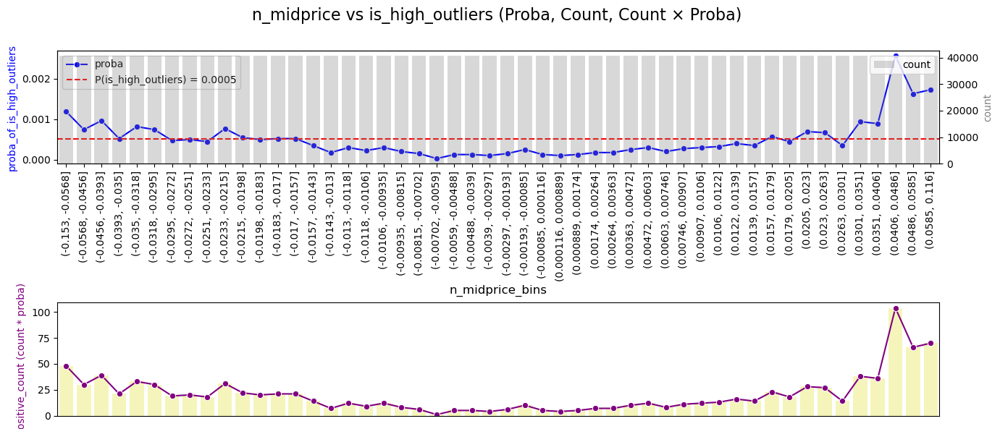

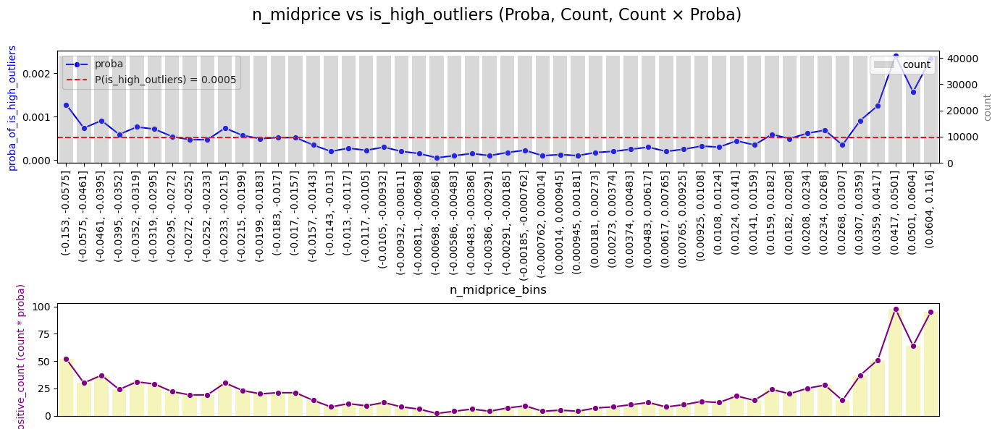

In [415]:
# 3.n_midprice相关
conditional_proba_plot(normal_df, feature='n_midprice', target='is_high_outliers', bins=50)
conditional_proba_plot(df, feature='n_midprice', target='is_high_outliers', bins=50)

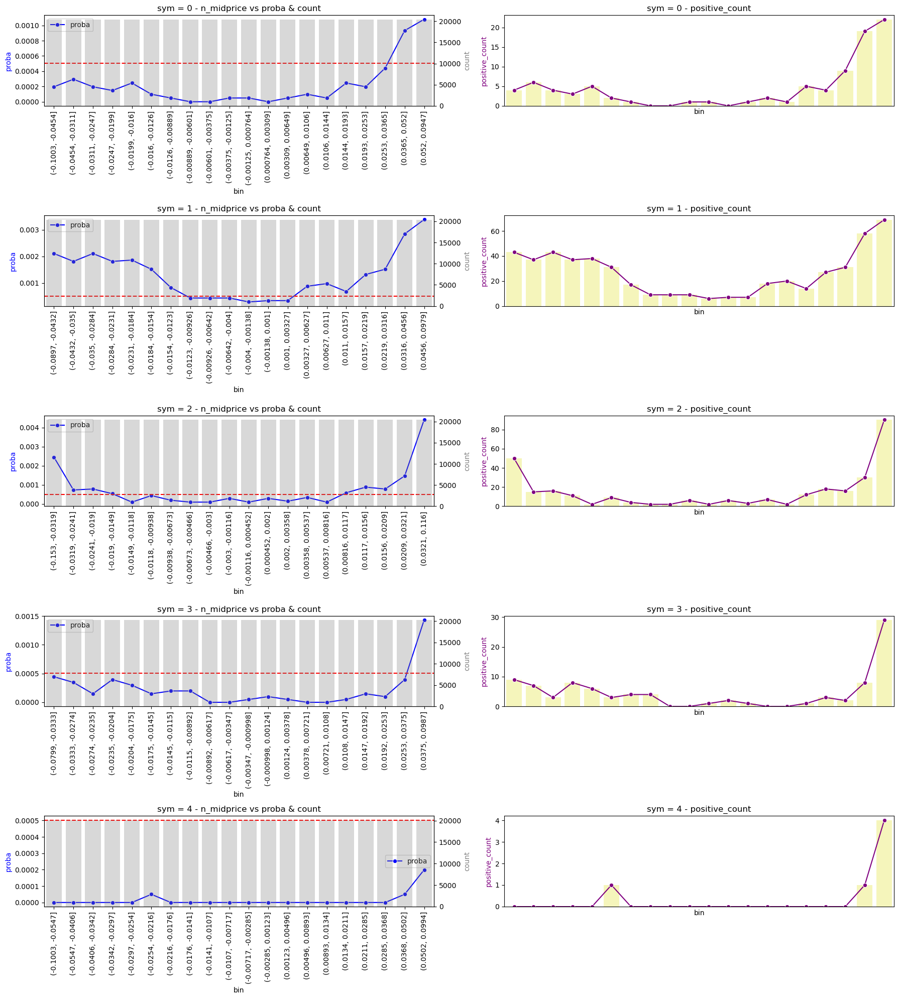

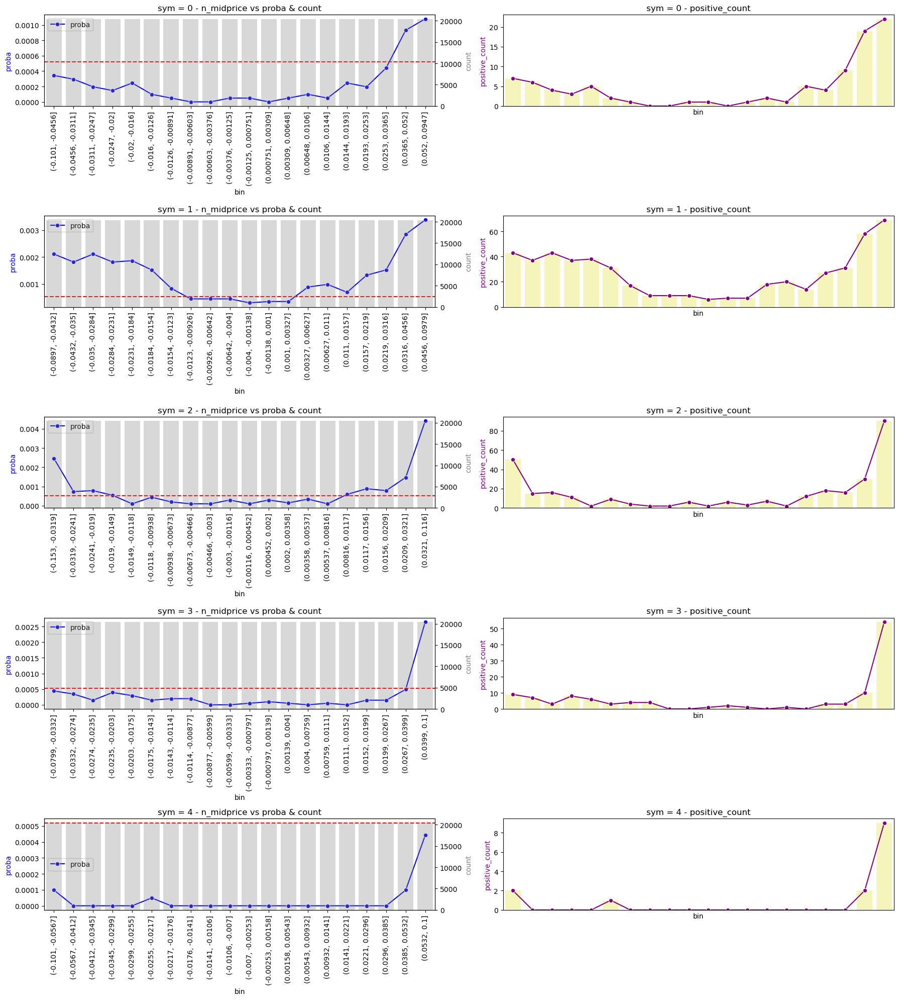

In [416]:
proba_plot_by_sym(normal_df, feature='n_midprice', target='is_high_outliers', bins=20)
proba_plot_by_sym(df, feature='n_midprice', target='is_high_outliers', bins=20)

In [ ]:
# 比较正常
# 上涨到了高位可能跟风买入(挂单)或者主动卖出（出货）
# 下跌到低位可能有人想抄底或砸盘
# 接下来看看中间价变化率(一阶差分)

In [417]:
def add_diff_and_rolling_features(group):
    group = group.sort_values('time') 
    group['mid_diff'] = group['n_midprice'].diff()
    group['realized_volatility'] = group['mid_diff'].shift(1).rolling(window=5, min_periods=3).std()
    return group

rolling_df = df.copy().groupby(['sym', 'date', 'time_period'], group_keys=False).apply(
    add_diff_and_rolling_features,
    include_groups=True
).dropna(axis=0)

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\3779396736.py:7: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  rolling_df = df.copy().groupby(['sym', 'date', 'time_period'], group_keys=False).apply(


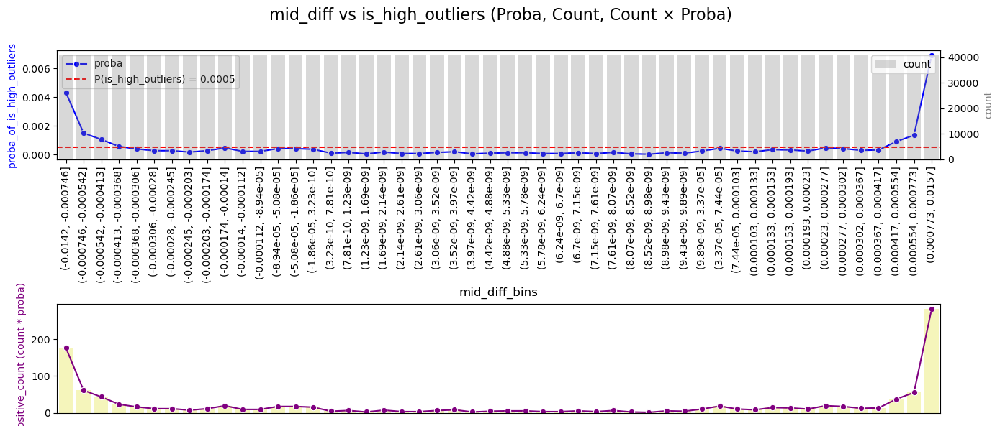

In [420]:
conditional_proba_plot(rolling_df, feature='mid_diff', target='is_high_outliers', bins=50)

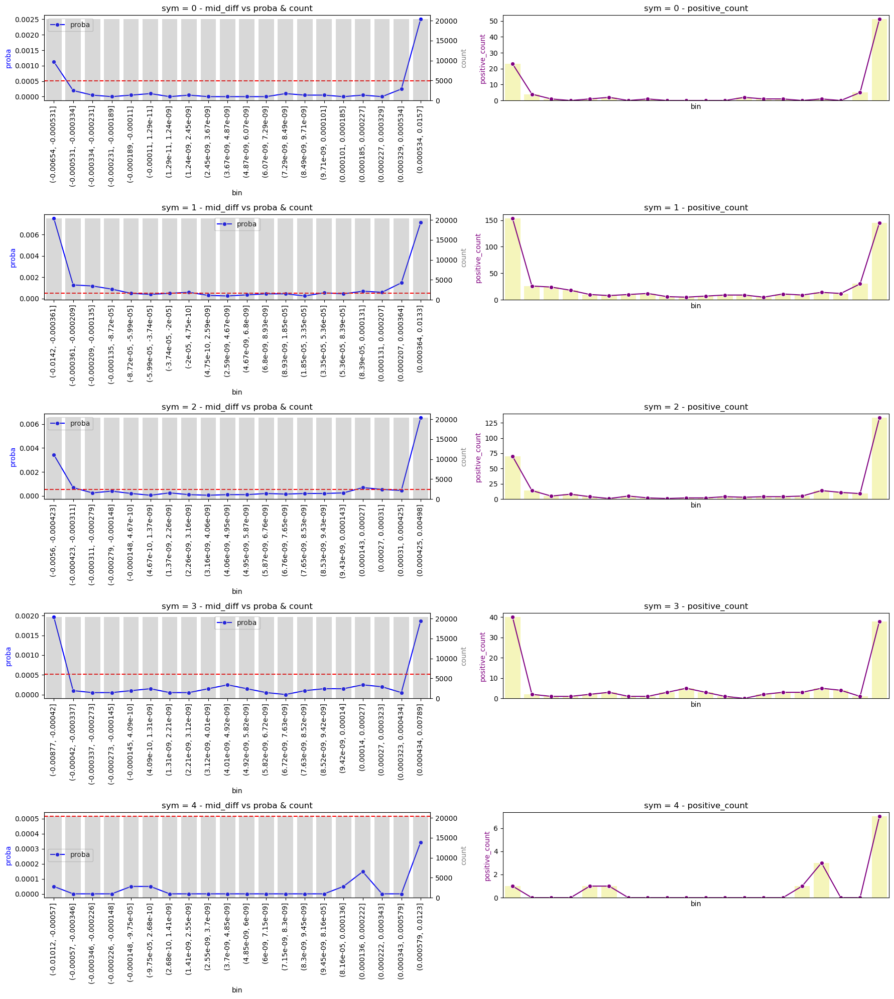

In [422]:
proba_plot_by_sym(rolling_df, feature='mid_diff', target='is_high_outliers', bins=20)

In [ ]:
# 不必多言
# 1. mid_diff 绝对值大 ⇒ 剧烈价格变动
# 市场出现明显方向性（多空分歧或趋势出现）；

# 可能是利好利空消息、盘中异动或大单驱动；

# 触发高频交易、算法交易、止盈止损、套利策略；

# 结果是：更容易出现成交金额异常大。

# 2. mid_diff ≈ 0 ⇒ 市场横盘震荡
# 没有明显上涨或下跌意图；

# 投资者等待、观望、不主动交易；

# 买卖盘趋于均衡，挂单成交较少；

# 成交量（amount）自然保持低位。

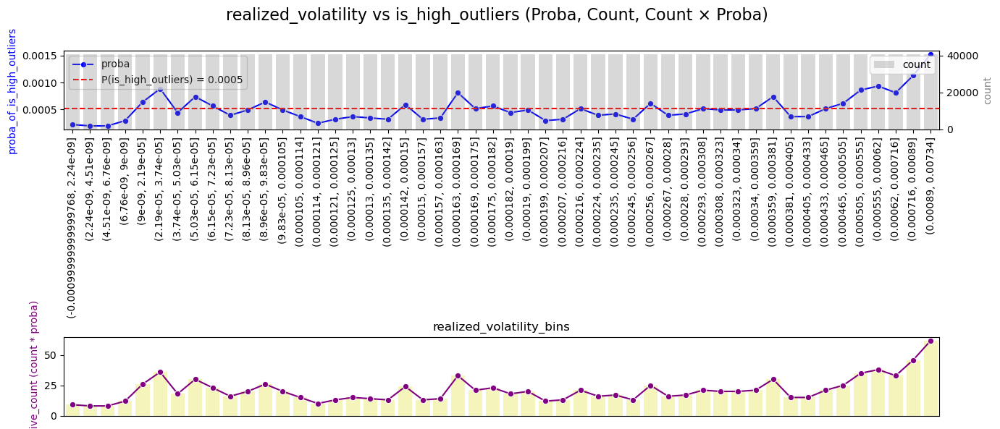

In [423]:
conditional_proba_plot(rolling_df, feature='realized_volatility', target='is_high_outliers', bins=50)

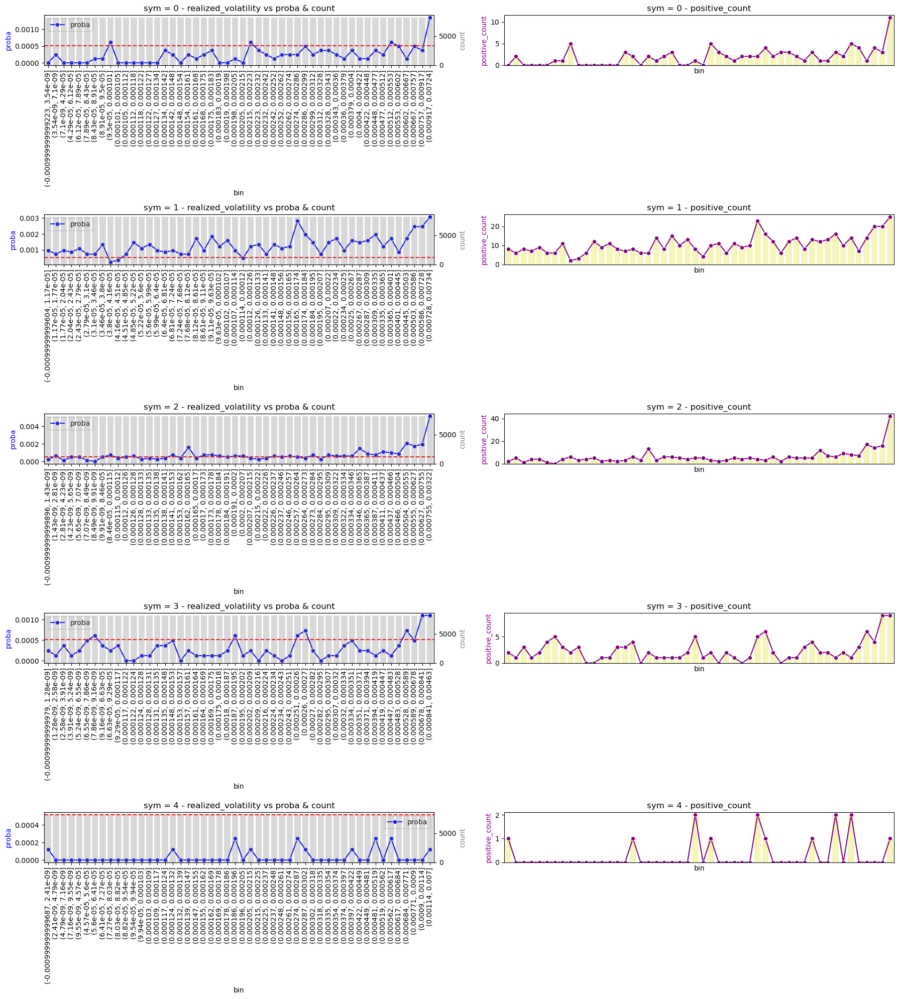

In [424]:
proba_plot_by_sym(rolling_df, feature='realized_volatility', target='is_high_outliers', bins=50)

In [ ]:
# 实现波动率越大成交量异常大的概率越高(除了sym=4)
# 波动率大 说明市场在单位时间内价格变化剧烈。

# 投资者会认为机会增加（趋势出现或套利机会增加），从而：

# 高频交易触发；

# 主力大单进出场；

# 量化模型增加交易频次。

# 所以 成交金额（amount）异常大更容易发生。

In [425]:
rolling_df = (
    df.copy()
    .groupby(['sym', 'date', 'time_period'], group_keys=False)
    .apply(compute_trend_tstat, col='n_midprice', window=20)
    .dropna(subset=[f'trend_tstat_20'])
)

C:\Users\15853\AppData\Local\Temp\ipykernel_18348\3449171846.py:2: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df.copy()


In [426]:
rolling_df

,date,time,sym,n_close,n_open,n_high,n_low,amount_delta,n_midprice,n_bid1,n_bsize1,n_bid2,n_bsize2,n_bid3,n_bsize3,n_bid4,n_bsize4,n_bid5,n_bsize5,n_ask1,n_asize1,n_ask2,n_asize2,n_ask3,n_asize3,n_ask4,n_asize4,n_ask5,n_asize5,label_5,label_10,label_20,label_40,label_60,time_period,spread1,spread2,spread3,spread4,spread5,amount,is_amount_0,abnormal,is_high_outliers,bin,impact,n_midprice_diff,rolling_20_n_midprice_diff_sum,rolling_20_n_midprice_diff_std,trend_tstat_20
20,0,09:41:03,0,-0.010870,-0.005000,0.006522,-0.013913,1373887.0,-0.011087,-0.011304,0.019209,-0.011739,0.104341,-0.011957,0.127915,-0.012174,0.014843,-0.012391,0.068978,-0.010870,0.001746,-0.010652,0.009605,-0.009783,0.002183,-0.009565,0.023138,-0.009348,0.044094,2.0,2.0,1.0,0.0,0.0,AM,0.000435,0.001087,0.002174,0.002609,0.003043,14.133155,0,0,0,"(-0.0117, -0.0105]",0.006145,-5.434783e-04,-0.006304,0.000790,-1.784271
21,0,09:41:06,0,-0.010652,-0.005000,0.006522,-0.013913,705169.0,-0.010543,-0.010652,0.005675,-0.010870,0.071161,-0.011087,0.004366,-0.011304,0.010478,-0.011522,0.004802,-0.010435,0.000437,-0.010000,0.006549,-0.009783,0.000437,-0.009565,0.023138,-0.009348,0.044094,1.0,1.0,0.0,0.0,0.0,AM,0.000217,0.000870,0.001304,0.001739,0.002174,13.466194,0,0,0,"(-0.0105, -0.00932]",0.002927,5.434783e-04,-0.006413,0.000783,-1.830462
22,0,09:41:09,0,-0.010652,-0.005000,0.006522,-0.013913,1032921.0,-0.010761,-0.010870,0.086441,-0.011087,0.006112,-0.011304,0.021392,-0.011522,0.009168,-0.011739,0.038418,-0.010652,0.020955,-0.009783,0.003056,-0.009565,0.023138,-0.009348,0.044530,-0.009130,0.327429,1.0,1.0,0.0,0.0,0.0,AM,0.000217,0.001304,0.001739,0.002174,0.002609,13.847902,0,0,0,"(-0.0117, -0.0105]",0.003010,-2.173913e-04,-0.005109,0.000731,-1.563403
23,0,09:41:12,0,-0.010435,-0.005000,0.006522,-0.013913,650742.0,-0.010000,-0.010217,0.000437,-0.010652,0.003929,-0.010870,0.095173,-0.011087,0.007422,-0.011304,0.042347,-0.009783,0.007422,-0.009565,0.023138,-0.009348,0.044530,-0.009130,0.327429,-0.008696,0.092990,1.0,0.0,0.0,0.0,0.0,AM,0.000435,0.001087,0.001522,0.001957,0.002609,13.385870,0,0,0,"(-0.0105, -0.00932]",0.005820,7.608696e-04,-0.003804,0.000761,-1.117569
24,0,09:41:15,0,-0.010870,-0.005000,0.006522,-0.013913,3343684.0,-0.010761,-0.010870,0.003056,-0.011522,0.001746,-0.011739,0.027504,-0.011957,0.235749,-0.012174,0.016153,-0.010652,0.062866,-0.010435,0.003056,-0.010217,0.004802,-0.010000,0.000437,-0.009783,0.009605,1.0,1.0,1.0,0.0,0.0,AM,0.000217,0.001087,0.001522,0.001957,0.002391,15.022584,0,0,0,"(-0.0117, -0.0105]",0.003266,-7.608696e-04,-0.003913,0.000765,-1.143715
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2038975,9,14:49:45,4,-0.020196,0.009617,0.020035,-0.021638,85563.0,-0.020115,-0.020196,0.078282,-0.020516,0.029931,-0.020676,0.004605,-0.020837,0.013814,-0.020997,0.101306,-0.020035,0.023024,-0.019875,0.036838,-0.019715,0.013814,-0.019394,0.041443,-0.019234,0.025326,1.0,0.0,1.0,1.0,1.0,PM,0.000160,0.000641,0.000962,0.001443,0.001763,11.357020,0,0,0,"(-0.0215, -0.0199]",0.001820,4.808463e-04,0.000721,0.000278,0.579720
2038976,9,14:49:48,4,-0.020196,0.009617,0.020035,-0.021638,91695.0,-0.020115,-0.020196,0.057560,-0.020356,0.006907,-0.020516,0.050653,-0.020676,0.006907,-0.020837,0.013814,-0.020035,0.043746,-0.019875,0.036838,-0.019715,0.013814,-0.019394,0.041443,-0.019234,0.025326,1.0,1.0,1.0,1.0,1.0,PM,0.000160,0.000481,0.000801,0.001282,0.001603,11.426234,0,0,0,"(-0.0215, -0.0199]",0.001831,0.000000e+00,0.000561,0.000277,0.453275
2038977,9,14:49:51,4,-0.020035,0.009617,0.020035,-0.021638,116148.0,-0.020115,-0.020196,0.052955,-0.020356,0.006907,-0.020516,0.020722,-0.020676,0.011512,-0.020837,0.013814,-0.020035,0.041443,-0.019875,0.036838,-0.019715,0.013814,-0.019394,0.041443,-0.019234,0.025326,1.0,1.0,1.0,1.0,1.0,PM,0.000160,0.000481,0.000801,0.001282,0.001603,11.662629,0,0,0,"(-0.0215, -0.0199]",0

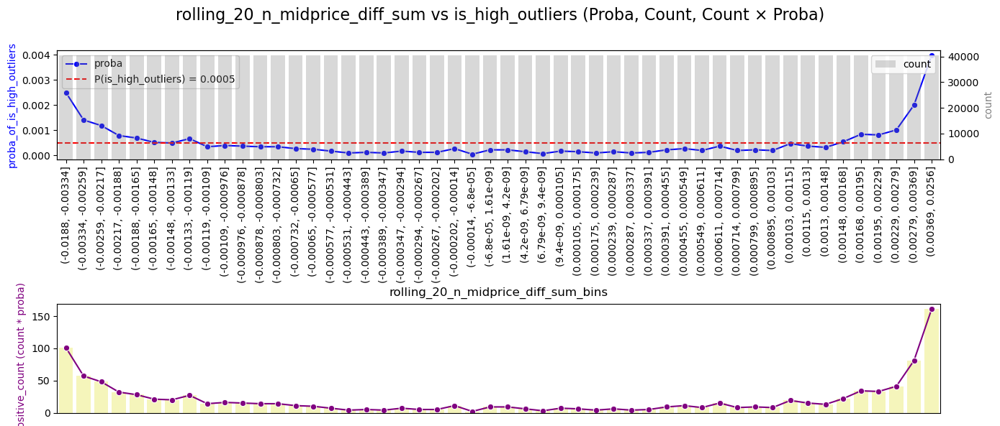

In [427]:
conditional_proba_plot(rolling_df, feature='rolling_20_n_midprice_diff_sum', target='is_high_outliers', bins=50)

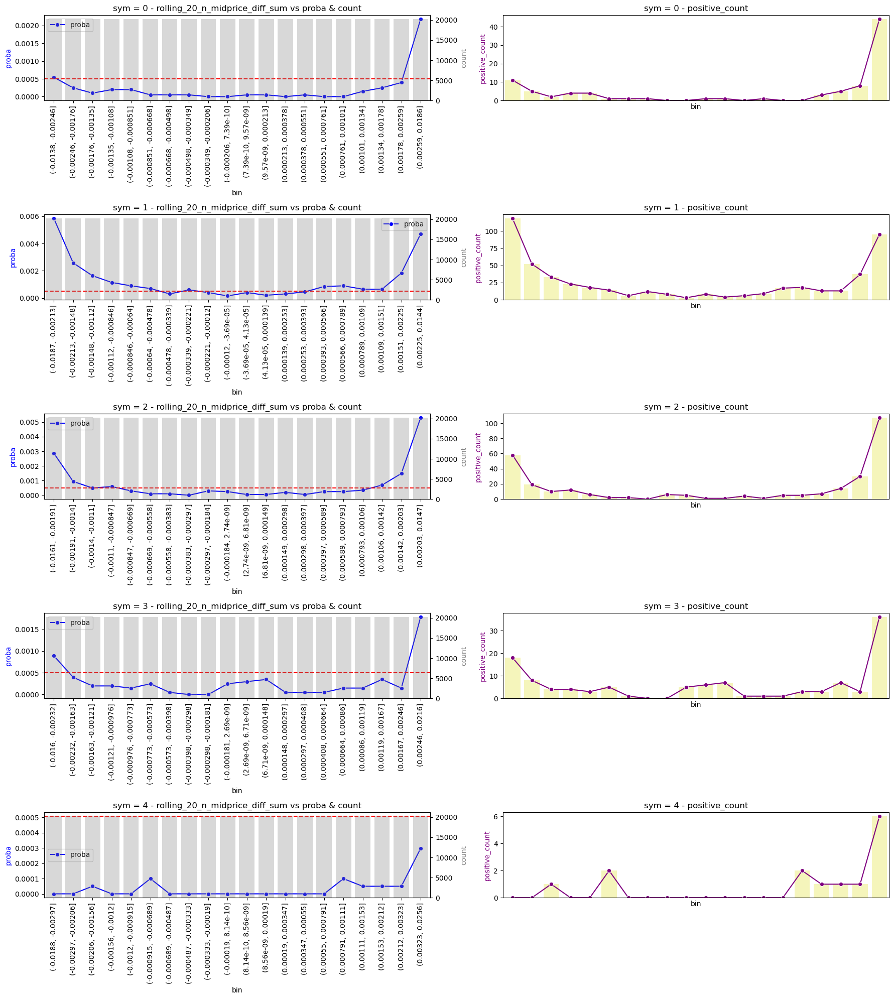

In [431]:
proba_plot_by_sym(rolling_df, feature='rolling_20_n_midprice_diff_sum', target='is_high_outliers', bins=20)

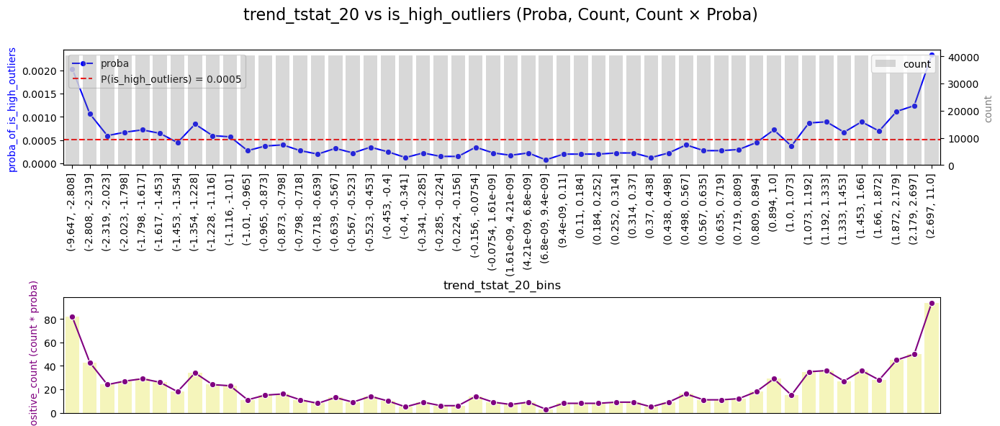

In [429]:
conditional_proba_plot(rolling_df, feature='trend_tstat_20', target='is_high_outliers', bins=50)

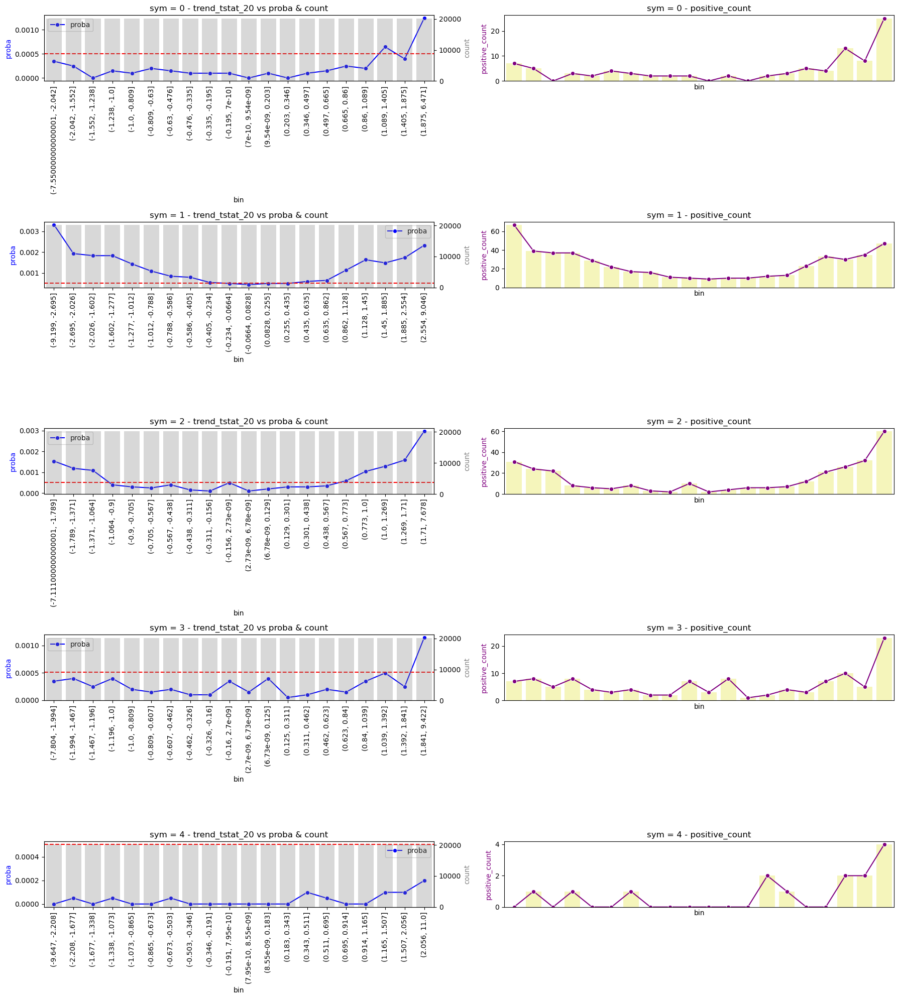

In [430]:
proba_plot_by_sym(rolling_df, feature='trend_tstat_20', target='is_high_outliers', bins=20)